In [ ]:
# installing necessary libraries
!pip -q install -U tensorflow matplotlib scikit-learn

In [ ]:
# to avoid warning logs
import os
os.environ["TF_CPP_MIN_LOG_LEVEL"] = "2"

In [ ]:
# adding hyperparameters
LATENT_DIM   = 256
BATCH_SIZE   = 512
EPOCHS       = 200          # 200 - as mentioned in the instruction
LR           = 2e-4         # learning rate
TSNE_SAMPLES = 10000        # subsampling the training set for faster t-SNE

In [ ]:
#imports
import tensorflow as tf
from keras import layers, models, losses
from keras.datasets import cifar10
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE

# CIFAR DATA
# loading and normalizing
(x_train, y_train), (x_test, y_test) = cifar10.load_data()
x_train, x_test = x_train / 255.0, x_test / 255.0

# dimension of latent space
latent_dim = 64

170498071/170498071 ━━━━━━━━━━━━━━━━━━━━ 21s 0us/step


In [ ]:
# print the shape
print(f"x_train shape: {x_train.shape}")
print(f"y_train shape: {y_train.shape}")

x_train shape: (50000, 32, 32, 3)
y_train shape: (50000, 1)


In [ ]:
# remove unnecessary single-dimensional entries from label arrays
y_train = y_train.squeeze()
y_test  = y_test.squeeze()

In [ ]:
# print the shape
print(f"x_train shape: {y_train.shape}")
print(f"y_train shape: {y_test.shape}")

x_train shape: (50000,)
y_train shape: (10000,)


In [ ]:
# AUTOTUNE helps the TensorFlow dynamically tune the parallelism of the pipeline
AUTOTUNE = tf.data.AUTOTUNE

def build_ds(x, y, batch, shuffle=False):
    # Convert NumPy arrays to TensorFlow Dataset
    ds = tf.data.Dataset.from_tensor_slices((x, y))

    # Shuffle the dataset each epoch to improve generalization
    if shuffle:
        ds = ds.shuffle(20000, reshuffle_each_iteration=True)

    # Batch the data and drop_remainder helps kernel shapes
    ds = ds.batch(batch, drop_remainder=shuffle)
    ds = ds.prefetch(AUTOTUNE)
    return ds

# Building the datasets
train_ds = build_ds(x_train, y_train, BATCH_SIZE, shuffle=True).cache()
test_ds  = build_ds(x_test,  y_test,  BATCH_SIZE, shuffle=False)

In [ ]:
# Defining the Encoder

def build_encoder(latent_dim=LATENT_DIM):
    inp = layers.Input(shape=(32, 32, 3))

    # 4 Conv layers along with downsampling
    x = layers.Conv2D(64, 3, strides=2, padding="same")(inp)    # 16x16
    x = layers.BatchNormalization()(x); x = layers.Activation("swish")(x)
    x = layers.Conv2D(128, 3, strides=2, padding="same")(x)     # 8x8
    x = layers.BatchNormalization()(x); x = layers.Activation("swish")(x)
    x = layers.Conv2D(256, 3, strides=2, padding="same")(x)     # 4x4
    x = layers.BatchNormalization()(x); x = layers.Activation("swish")(x)
    x = layers.Conv2D(512, 3, strides=2, padding="same")(x)     # 2x2
    x = layers.BatchNormalization()(x); x = layers.Activation("swish")(x)

    x = layers.Flatten()(x)
    x = layers.Dense(1024)(x); x = layers.Activation("swish")(x)

    # numerically stable statistics in float32
    z_mean    = layers.Dense(latent_dim, name="z_mean",    dtype="float32")(x)
    z_log_var = layers.Dense(latent_dim, name="z_log_var", dtype="float32")(x)

    def sample(args):
        mu, log_var = args
        eps = tf.random.normal(shape=tf.shape(mu), dtype=tf.float32)
        # reparameterization trick
        return mu + tf.exp(0.5 * log_var) * eps

    # The Lambda layer applies the sample() function to generate z.
    z = layers.Lambda(sample, name="z", dtype="float32")([z_mean, z_log_var])

    # Building the encoder model that outputs mean, log_var, and sampled latent vector
    return models.Model(inp, [z_mean, z_log_var, z], name="encoder")

In [ ]:
# Defining the Decoder
def build_decoder(latent_dim=LATENT_DIM):

    # Input is latent vector
    inp = layers.Input(shape=(latent_dim,), dtype="float32")

    # Project latent vector to a low-resolution feature map
    x = layers.Dense(2*2*512)(inp)
    x = layers.Activation("swish")(x)  # utilizing swish activation function
    x = layers.Reshape((2, 2, 512))(x)  # reshaping to a spatial feature map

    # Conv2DTranspose (upscale)
    x = layers.Conv2DTranspose(512, 3, strides=2, padding="same")(x)  # 4x4
    x = layers.BatchNormalization()(x); x = layers.Activation("swish")(x)
    x = layers.Conv2DTranspose(256, 3, strides=2, padding="same")(x)  # 8x8
    x = layers.BatchNormalization()(x); x = layers.Activation("swish")(x)
    x = layers.Conv2DTranspose(128, 3, strides=2, padding="same")(x)  # 16x16
    x = layers.BatchNormalization()(x); x = layers.Activation("swish")(x)
    x = layers.Conv2DTranspose(64, 3, strides=2, padding="same")(x)   # 32x32
    x = layers.BatchNormalization()(x); x = layers.Activation("swish")(x)

    # sigmoid maps the pixel values to [0,1] range for normalized images
    out = layers.Conv2DTranspose(3, 3, padding="same", activation="sigmoid", dtype="float32")(x)

    # Return the full decoder model
    return models.Model(inp, out, name="decoder")

In [ ]:
# Build the encoder and the decoder network
encoder = build_encoder(LATENT_DIM)
decoder = build_decoder(LATENT_DIM)


In [ ]:
# VAE training loop

class VAE(tf.keras.Model):
    def __init__(self, enc, dec, **kwargs):
        super().__init__(**kwargs)
        # encoder
        self.enc = enc
        # decoder
        self.dec = dec
        # to track the running
        self.total_loss_tracker = tf.keras.metrics.Mean(name="total_loss")
        self.recon_loss_tracker = tf.keras.metrics.Mean(name="recon_loss")
        self.kl_loss_tracker    = tf.keras.metrics.Mean(name="kl_loss")

    @property
    def metrics(self):
        return [self.total_loss_tracker, self.recon_loss_tracker, self.kl_loss_tracker]

    def train_step(self, data):
        x, _ = data
        with tf.GradientTape() as tape:
            z_mean, z_log_var, z = self.enc(x, training=True)
            x_hat = self.dec(z, training=True)

            # Reconstruction loss
            recon = tf.reduce_mean(tf.reduce_sum(tf.square(tf.cast(x, tf.float32) - tf.cast(x_hat, tf.float32)), axis=[1,2,3]))

            # KL divergence
            kl = -0.5 * tf.reduce_mean(tf.reduce_sum(1 + z_log_var - tf.square(z_mean) - tf.exp(z_log_var), axis=1))

            total = tf.cast(recon + kl, tf.float32)

        grads = tape.gradient(total, self.trainable_variables)
        self.optimizer.apply_gradients(zip(grads, self.trainable_variables))

        self.total_loss_tracker.update_state(total)
        self.recon_loss_tracker.update_state(recon)
        self.kl_loss_tracker.update_state(kl)
        return {"total_loss": self.total_loss_tracker.result(),
                "recon_loss": self.recon_loss_tracker.result(),
                "kl_loss": self.kl_loss_tracker.result()}

    def test_step(self, data):
      x, _ = data
      z_mean, z_log_var, z = self.enc(x, training=False)
      x_hat = self.dec(z, training=False)

      recon = tf.reduce_mean(tf.reduce_sum(tf.square(tf.cast(x, tf.float32) - tf.cast(x_hat, tf.float32)), axis=[1,2,3]))
      kl = -0.5 * tf.reduce_mean(tf.reduce_sum(1 + z_log_var - tf.square(z_mean) - tf.exp(z_log_var), axis=1))
      total = tf.cast(recon + kl, tf.float32)

      # Updating the trackers
      self.total_loss_tracker.update_state(total)
      self.recon_loss_tracker.update_state(recon)
      self.kl_loss_tracker.update_state(kl)

      return {"total_loss": total, "recon_loss": recon, "kl_loss": kl}

In [ ]:
vae = VAE(encoder, decoder)
optimizer = tf.keras.optimizers.Adam(learning_rate=LR)
vae.compile(optimizer=optimizer)

In [ ]:
# Training

history = vae.fit(
    train_ds,
    epochs=EPOCHS,
    validation_data=test_ds,
    verbose=1
)

Epoch 1/200
97/97 ━━━━━━━━━━━━━━━━━━━━ 18s 60ms/step - kl_loss: 21.0264 - recon_loss: 54.4337 - total_loss: 75.4600 - val_kl_loss: 21.3065 - val_recon_loss: 53.8338 - val_total_loss: 75.1403
Epoch 2/200
97/97 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - kl_loss: 21.0773 - recon_loss: 53.5006 - total_loss: 74.5780 - val_kl_loss: 21.4168 - val_recon_loss: 53.9646 - val_total_loss: 75.3813
Epoch 3/200
97/97 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - kl_loss: 21.1286 - recon_loss: 53.3733 - total_loss: 74.5019 - val_kl_loss: 21.4329 - val_recon_loss: 53.8179 - val_total_loss: 75.2508
Epoch 4/200
97/97 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - kl_loss: 21.1478 - recon_loss: 53.2053 - total_loss: 74.3531 - val_kl_loss: 21.5667 - val_recon_loss: 53.5781 - val_total_loss: 75.1448
Epoch 5/200
97/97 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step - kl_loss: 21.2056 - recon_loss: 53.1828 - total_loss: 74.3884 - val_kl_loss: 21.4606 - val_recon_loss: 53.4104 - val_total_loss: 74.8709
Epoch 6/200
97/97 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/st

Running t-SNE on z_mean (10000 samples)...
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 10000 samples in 0.002s...


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


[t-SNE] Computed neighbors for 10000 samples in 0.422s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10000
[t-SNE] Computed conditional probabilities for sample 2000 / 10000
[t-SNE] Computed conditional probabilities for sample 3000 / 10000
[t-SNE] Computed conditional probabilities for sample 4000 / 10000
[t-SNE] Computed conditional probabilities for sample 5000 / 10000
[t-SNE] Computed conditional probabilities for sample 6000 / 10000
[t-SNE] Computed conditional probabilities for sample 7000 / 10000
[t-SNE] Computed conditional probabilities for sample 8000 / 10000
[t-SNE] Computed conditional probabilities for sample 9000 / 10000
[t-SNE] Computed conditional probabilities for sample 10000 / 10000
[t-SNE] Mean sigma: 1.065333
[t-SNE] KL divergence after 50 iterations with early exaggeration: 93.100372
[t-SNE] KL divergence after 1000 iterations: 3.762571


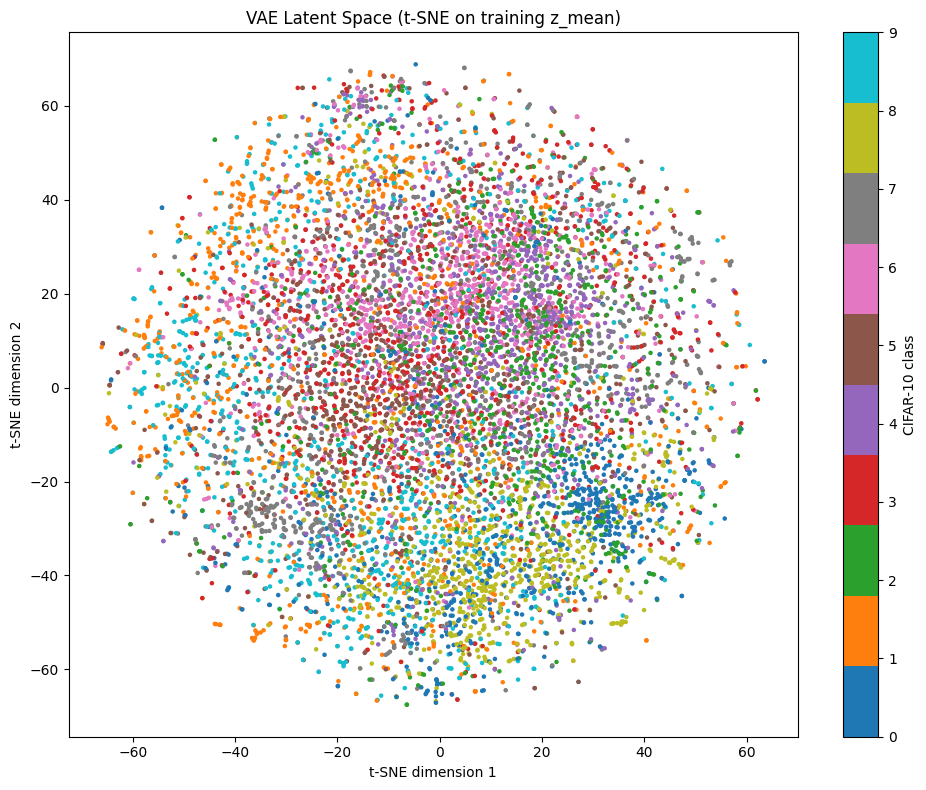

In [ ]:
# Latent space clustering
idx = np.random.choice(len(x_train), size=min(TSNE_SAMPLES, len(x_train)), replace=False)
x_sub = x_train[idx]
y_sub = y_train[idx]

# Computing the z_mean for the subset
z_means = []
for i in range(0, len(x_sub), BATCH_SIZE):
    xb = x_sub[i:i+BATCH_SIZE]
    zm, _, _ = encoder.predict(xb, verbose=0)
    z_means.append(zm)
z_means = np.concatenate(z_means, axis=0)

print("Running t-SNE on z_mean ({} samples)...".format(len(z_means)))
tsne = TSNE(n_components=2, perplexity=30, init="pca", learning_rate="auto", n_iter=1000, verbose=1)
z2 = tsne.fit_transform(z_means.astype(np.float32))

plt.figure(figsize=(10, 8))
sc = plt.scatter(z2[:, 0], z2[:, 1], c=y_sub, s=5, cmap="tab10")
cb = plt.colorbar(sc, ticks=range(10))
cb.set_label("CIFAR-10 class")
plt.title("VAE Latent Space (t-SNE on training z_mean)")
plt.xlabel("t-SNE dimension 1"); plt.ylabel("t-SNE dimension 2")
plt.tight_layout()
plt.show()

The latent space by applying t-SNE (a dimensionality reduction algorithm) to the latent means (z_mean) of 10,000 randomly selected samples. The resulting 2D scatter plot (as shown in the first image) reveals how samples from different CIFAR-10 classes are distributed in the latent space. The overlapping colors indicate that the VAE’s latent space captures some class-wise structure but with significant overlap, typical of unsupervised representations.

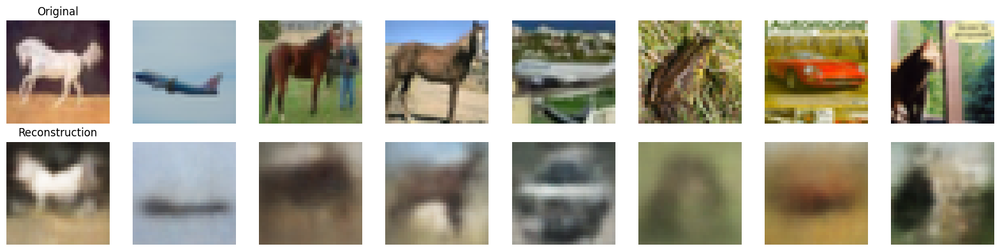

In [ ]:
# reconstructions

def show_reconstructions(n=8):
    idx = np.random.choice(len(x_test), size=n, replace=False)
    imgs = x_test[idx]
    zm, zv, z = encoder.predict(imgs, verbose=0)
    recons = decoder.predict(z, verbose=0)

    plt.figure(figsize=(2*n, 4))
    for i in range(n):
        ax = plt.subplot(2, n, i + 1)
        plt.imshow(imgs[i]); ax.axis("off")
        if i == 0: ax.set_title("Original")
        ax = plt.subplot(2, n, i + 1 + n)
        plt.imshow(np.clip(recons[i], 0, 1)); ax.axis("off")
        if i == 0: ax.set_title("Reconstruction")
    plt.tight_layout(); plt.show()

show_reconstructions(8)

Reconstruction visualization as shown in the above image compares original test images with their reconstructed counterparts. The reconstructions maintain general shapes and colors but are noticeably blurred, reflecting that the VAE captures broad semantic information but not fine details—common in VAEs due to the probabilistic nature of latent sampling and pixel-level reconstruction loss.

### Deep Convolutional Generative Adversarial Networks for Medical Image Synthesis


In [ ]:
# installations
!pip install -q medmnist

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.9/115.9 kB 8.1 MB/s eta 0:00:00


In [ ]:
# imports
import os
import torch
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt
import numpy as np
import torchvision.utils as vutils
from torchvision import transforms
from torch.utils.data import DataLoader
from medmnist import PathMNIST
from tqdm import tqdm
from torch import amp
import warnings

warnings.filterwarnings("ignore", category=FutureWarning)
os.environ["PYTHONWARNINGS"] = "ignore"

In [ ]:
# utilizing pytorch/gpu to run epoch faster
torch.backends.cudnn.benchmark = True
torch.backends.cuda.matmul.allow_tf32 = True
torch.set_float32_matmul_precision("high")

In [ ]:
# Config

class Config:
    num_epochs = 1200
    batch_size = 16384
    z_dim = 100
    lr = 0.0001
    beta1 = 0.5
    beta2 = 0.999
    image_channels = 3
    image_size = 28
    amp = False
    save_every = 50
    image_save_every = 50
    outdir = "generated_images_DCGAN"
    ckpt_dir = "checkpoints_dcgan"

C = Config()
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
os.makedirs(C.outdir, exist_ok=True)
os.makedirs(C.ckpt_dir, exist_ok=True)

In [ ]:
# Data Loading

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

train_dataset = PathMNIST(split='train', transform=transform, download=True)
train_loader = DataLoader(
    train_dataset,
    batch_size=C.batch_size,
    shuffle=True,
    num_workers=0,
    pin_memory=True,

)


In [ ]:
# Models

# generator
class Generator(nn.Module):
    def __init__(self, z_dim=100, channels=3):
        super().__init__()
        self.main = nn.Sequential(
            nn.ConvTranspose2d(z_dim, 512, 4, 1, 0, bias=False),
            nn.BatchNorm2d(512, momentum=0.8),
            nn.ReLU(True),
            nn.ConvTranspose2d(512, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256, momentum=0.8),
            nn.ReLU(True),
            nn.ConvTranspose2d(256, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128, momentum=0.8),
            nn.ReLU(True),
            nn.ConvTranspose2d(128, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64, momentum=0.8),
            nn.ReLU(True),
            nn.ConvTranspose2d(64, channels, 3, 1, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, z):
        return self.main(z)[:, :, :C.image_size, :C.image_size]

# discriminator
class Discriminator(nn.Module):
    def __init__(self, channels=3):
        super().__init__()
        self.main = nn.Sequential(
            nn.Conv2d(channels, 64, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128, momentum=0.8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(128, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256, momentum=0.8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(256, 512, 3, 1, 0, bias=False),
            nn.BatchNorm2d(512, momentum=0.8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(512, 1, 1, 1, 0, bias=False)
        )

    def forward(self, x):
        return self.main(x).view(-1, 1)

#initializing weights
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
# Visualizations
def visualize(real_images, generated_images, epoch, outdir):
    real_images = (real_images[:10].clamp(-1,1) + 1) / 2
    generated_images = (generated_images[:10].clamp(-1,1) + 1) / 2
    fig, axes = plt.subplots(2, 5, figsize=(10, 4))
    for i in range(5):
        rimg = real_images[i].permute(1, 2, 0).cpu().to(torch.float32).numpy()
        gimg = generated_images[i].permute(1, 2, 0).cpu().to(torch.float32).numpy()
        axes[0, i].imshow(rimg); axes[0, i].axis('off')
        axes[1, i].imshow(gimg); axes[1, i].axis('off')
    plt.suptitle(f'DCGAN - Epoch {epoch+1}')
    plt.savefig(os.path.join(outdir, f'epoch_{epoch+1:04d}_comparison.png'))
    plt.close()

Starting training for 1200 epochs...


Epoch 1/1200: 100%|██████████| 44/44 [00:22<00:00,  1.94it/s, d_loss=1.082, g_loss=0.878]


[Epoch 1] D_loss=1.2548 | G_loss=0.7838


Epoch 2/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.999, g_loss=0.944]


[Epoch 2] D_loss=0.9326 | G_loss=1.0133


Epoch 3/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.265, g_loss=0.870]


[Epoch 3] D_loss=1.2539 | G_loss=0.9233


Epoch 4/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.272, g_loss=0.787]


[Epoch 4] D_loss=1.3015 | G_loss=0.8266


Epoch 5/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.128, g_loss=0.936]


[Epoch 5] D_loss=1.2347 | G_loss=0.8737


Epoch 6/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.177, g_loss=0.943]


[Epoch 6] D_loss=1.1660 | G_loss=0.9156


Epoch 7/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.286, g_loss=0.792]


[Epoch 7] D_loss=1.2080 | G_loss=0.9001


Epoch 8/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.300, g_loss=0.776]


[Epoch 8] D_loss=1.2637 | G_loss=0.8629


Epoch 9/1200: 100%|██████████| 44/44 [00:20<00:00,  2.17it/s, d_loss=1.260, g_loss=0.874]


[Epoch 9] D_loss=1.2702 | G_loss=0.8366


Epoch 10/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.294, g_loss=0.826]


[Epoch 10] D_loss=1.2548 | G_loss=0.8599


Epoch 11/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.265, g_loss=0.881]


[Epoch 11] D_loss=1.2730 | G_loss=0.8364


Epoch 12/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.254, g_loss=0.816]


[Epoch 12] D_loss=1.2408 | G_loss=0.8586


Epoch 13/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.240, g_loss=0.789]


[Epoch 13] D_loss=1.2379 | G_loss=0.8552


Epoch 14/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.254, g_loss=0.862]


[Epoch 14] D_loss=1.2501 | G_loss=0.8617


Epoch 15/1200: 100%|██████████| 44/44 [00:20<00:00,  2.17it/s, d_loss=1.263, g_loss=0.909]


[Epoch 15] D_loss=1.2466 | G_loss=0.8606


Epoch 16/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.251, g_loss=0.799]


[Epoch 16] D_loss=1.2520 | G_loss=0.8849


Epoch 17/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.275, g_loss=0.813]


[Epoch 17] D_loss=1.2501 | G_loss=0.8937


Epoch 18/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.274, g_loss=0.864]


[Epoch 18] D_loss=1.2611 | G_loss=0.8622


Epoch 19/1200: 100%|██████████| 44/44 [00:20<00:00,  2.17it/s, d_loss=1.279, g_loss=0.788]


[Epoch 19] D_loss=1.2704 | G_loss=0.8507


Epoch 20/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.292, g_loss=0.877]


[Epoch 20] D_loss=1.2794 | G_loss=0.8561


Epoch 21/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.269, g_loss=0.848]


[Epoch 21] D_loss=1.2852 | G_loss=0.8375


Epoch 22/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.354, g_loss=0.775]


[Epoch 22] D_loss=1.2810 | G_loss=0.8433


Epoch 23/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.345, g_loss=0.730]


[Epoch 23] D_loss=1.2759 | G_loss=0.8438


Epoch 24/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.298, g_loss=0.820]


[Epoch 24] D_loss=1.2861 | G_loss=0.8348


Epoch 25/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.266, g_loss=0.844]


[Epoch 25] D_loss=1.2832 | G_loss=0.8465


Epoch 26/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.256, g_loss=0.838]


[Epoch 26] D_loss=1.2761 | G_loss=0.8466


Epoch 27/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.284, g_loss=0.773]


[Epoch 27] D_loss=1.2686 | G_loss=0.8418


Epoch 28/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.266, g_loss=0.791]


[Epoch 28] D_loss=1.2813 | G_loss=0.8461


Epoch 29/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.268, g_loss=0.785]


[Epoch 29] D_loss=1.2786 | G_loss=0.8440


Epoch 30/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.217, g_loss=0.936]


[Epoch 30] D_loss=1.2689 | G_loss=0.8363


Epoch 31/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.234, g_loss=0.865]


[Epoch 31] D_loss=1.2702 | G_loss=0.8369


Epoch 32/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.245, g_loss=0.849]


[Epoch 32] D_loss=1.2721 | G_loss=0.8466


Epoch 33/1200: 100%|██████████| 44/44 [00:20<00:00,  2.17it/s, d_loss=1.286, g_loss=0.877]


[Epoch 33] D_loss=1.2680 | G_loss=0.8547


Epoch 34/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.245, g_loss=0.917]


[Epoch 34] D_loss=1.2594 | G_loss=0.8699


Epoch 35/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.237, g_loss=0.815]


[Epoch 35] D_loss=1.2658 | G_loss=0.8493


Epoch 36/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.316, g_loss=0.853]


[Epoch 36] D_loss=1.2686 | G_loss=0.8578


Epoch 37/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.259, g_loss=0.863]


[Epoch 37] D_loss=1.2543 | G_loss=0.8615


Epoch 38/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.271, g_loss=0.829]


[Epoch 38] D_loss=1.2667 | G_loss=0.8622


Epoch 39/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.289, g_loss=0.927]


[Epoch 39] D_loss=1.2690 | G_loss=0.8608


Epoch 40/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.250, g_loss=0.766]


[Epoch 40] D_loss=1.2678 | G_loss=0.8556


Epoch 41/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.276, g_loss=0.758]


[Epoch 41] D_loss=1.2714 | G_loss=0.8603


Epoch 42/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.261, g_loss=0.840]


[Epoch 42] D_loss=1.2763 | G_loss=0.8573


Epoch 43/1200: 100%|██████████| 44/44 [00:20<00:00,  2.17it/s, d_loss=1.280, g_loss=0.804]


[Epoch 43] D_loss=1.2701 | G_loss=0.8647


Epoch 44/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.236, g_loss=0.868]


[Epoch 44] D_loss=1.2771 | G_loss=0.8676


Epoch 45/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.297, g_loss=0.828]


[Epoch 45] D_loss=1.2516 | G_loss=0.8717


Epoch 46/1200: 100%|██████████| 44/44 [00:20<00:00,  2.17it/s, d_loss=1.238, g_loss=0.823]


[Epoch 46] D_loss=1.2579 | G_loss=0.8843


Epoch 47/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.298, g_loss=0.817]


[Epoch 47] D_loss=1.2582 | G_loss=0.8883


Epoch 48/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.288, g_loss=0.848]


[Epoch 48] D_loss=1.2656 | G_loss=0.8879


Epoch 49/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.392, g_loss=0.881]


[Epoch 49] D_loss=1.2614 | G_loss=0.8906


Epoch 50/1200: 100%|██████████| 44/44 [00:20<00:00,  2.17it/s, d_loss=1.297, g_loss=0.877]


[Epoch 50] D_loss=1.2506 | G_loss=0.8746


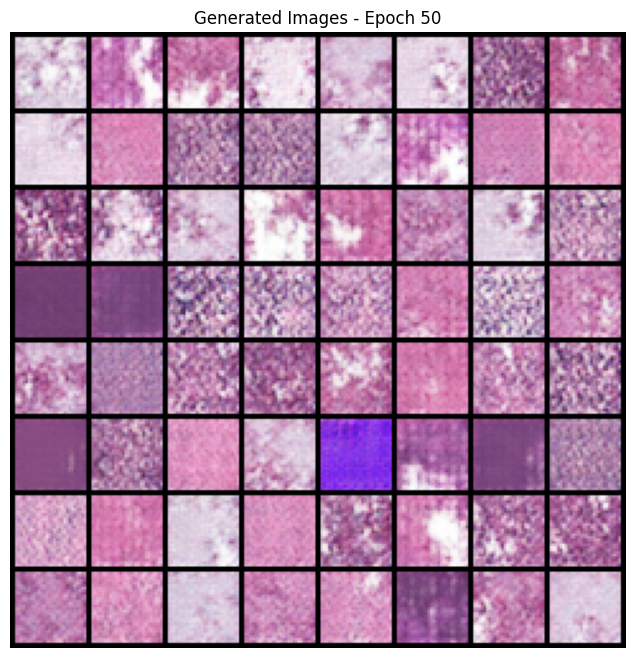

✅ Saved and displayed generated samples at epoch 50
💾 Saved checkpoint at epoch 50


Epoch 51/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.279, g_loss=0.710]


[Epoch 51] D_loss=1.2486 | G_loss=0.8867


Epoch 52/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.236, g_loss=0.971]


[Epoch 52] D_loss=1.2551 | G_loss=0.8961


Epoch 53/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.384, g_loss=0.799]


[Epoch 53] D_loss=1.2552 | G_loss=0.9098


Epoch 54/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.334, g_loss=0.847]


[Epoch 54] D_loss=1.2520 | G_loss=0.9137


Epoch 55/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.221, g_loss=1.054]


[Epoch 55] D_loss=1.2436 | G_loss=0.8946


Epoch 56/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.272, g_loss=0.878]


[Epoch 56] D_loss=1.2306 | G_loss=0.9256


Epoch 57/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.238, g_loss=0.865]


[Epoch 57] D_loss=1.2284 | G_loss=0.9115


Epoch 58/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.251, g_loss=0.868]


[Epoch 58] D_loss=1.2367 | G_loss=0.9466


Epoch 59/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.231, g_loss=1.043]


[Epoch 59] D_loss=1.2288 | G_loss=0.9072


Epoch 60/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.173, g_loss=0.951]


[Epoch 60] D_loss=1.2434 | G_loss=0.9392


Epoch 61/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.258, g_loss=1.036]


[Epoch 61] D_loss=1.2291 | G_loss=0.9386


Epoch 62/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.267, g_loss=0.877]


[Epoch 62] D_loss=1.2389 | G_loss=0.8936


Epoch 63/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.169, g_loss=0.939]


[Epoch 63] D_loss=1.2320 | G_loss=0.9293


Epoch 64/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.215, g_loss=0.948]


[Epoch 64] D_loss=1.2183 | G_loss=0.9392


Epoch 65/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.239, g_loss=0.870]


[Epoch 65] D_loss=1.2228 | G_loss=0.9368


Epoch 66/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.219, g_loss=0.912]


[Epoch 66] D_loss=1.2201 | G_loss=0.9756


Epoch 67/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.196, g_loss=1.082]


[Epoch 67] D_loss=1.2179 | G_loss=0.9250


Epoch 68/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.321, g_loss=0.829]


[Epoch 68] D_loss=1.2213 | G_loss=0.9553


Epoch 69/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.053, g_loss=1.040]


[Epoch 69] D_loss=1.2000 | G_loss=0.9348


Epoch 70/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.134, g_loss=0.928]


[Epoch 70] D_loss=1.2169 | G_loss=0.9727


Epoch 71/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.168, g_loss=0.900]


[Epoch 71] D_loss=1.2012 | G_loss=0.9779


Epoch 72/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.319, g_loss=0.898]


[Epoch 72] D_loss=1.2005 | G_loss=0.9542


Epoch 73/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.295, g_loss=0.851]


[Epoch 73] D_loss=1.2021 | G_loss=0.9689


Epoch 74/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.286, g_loss=0.834]


[Epoch 74] D_loss=1.2103 | G_loss=0.9623


Epoch 75/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.292, g_loss=1.082]


[Epoch 75] D_loss=1.2005 | G_loss=0.9476


Epoch 76/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.146, g_loss=0.871]


[Epoch 76] D_loss=1.1718 | G_loss=0.9642


Epoch 77/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.087, g_loss=1.010]


[Epoch 77] D_loss=1.1891 | G_loss=0.9909


Epoch 78/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.306, g_loss=1.123]


[Epoch 78] D_loss=1.2085 | G_loss=0.9789


Epoch 79/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.166, g_loss=1.014]


[Epoch 79] D_loss=1.1837 | G_loss=0.9657


Epoch 80/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.093, g_loss=0.799]


[Epoch 80] D_loss=1.1995 | G_loss=0.9841


Epoch 81/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.294, g_loss=0.698]


[Epoch 81] D_loss=1.1821 | G_loss=0.9872


Epoch 82/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.383, g_loss=0.928]


[Epoch 82] D_loss=1.1553 | G_loss=1.0253


Epoch 83/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.248, g_loss=0.810]


[Epoch 83] D_loss=1.1704 | G_loss=1.0184


Epoch 84/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.177, g_loss=1.033]


[Epoch 84] D_loss=1.1621 | G_loss=0.9897


Epoch 85/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.151, g_loss=0.928]


[Epoch 85] D_loss=1.1605 | G_loss=0.9887


Epoch 86/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.311, g_loss=0.998]


[Epoch 86] D_loss=1.1730 | G_loss=1.0263


Epoch 87/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.149, g_loss=1.062]


[Epoch 87] D_loss=1.1628 | G_loss=1.0229


Epoch 88/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.157, g_loss=1.133]


[Epoch 88] D_loss=1.1504 | G_loss=1.0316


Epoch 89/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.152, g_loss=0.899]


[Epoch 89] D_loss=1.1394 | G_loss=1.0384


Epoch 90/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.132, g_loss=1.072]


[Epoch 90] D_loss=1.1435 | G_loss=1.0278


Epoch 91/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.137, g_loss=0.975]


[Epoch 91] D_loss=1.1376 | G_loss=1.0344


Epoch 92/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.208, g_loss=0.870]


[Epoch 92] D_loss=1.1242 | G_loss=1.0536


Epoch 93/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.201, g_loss=1.111]


[Epoch 93] D_loss=1.1615 | G_loss=1.0839


Epoch 94/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.282, g_loss=1.016]


[Epoch 94] D_loss=1.1252 | G_loss=1.0809


Epoch 95/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.061, g_loss=1.217]


[Epoch 95] D_loss=1.1420 | G_loss=1.0635


Epoch 96/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.190, g_loss=0.888]


[Epoch 96] D_loss=1.1412 | G_loss=1.0337


Epoch 97/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.881, g_loss=1.304]


[Epoch 97] D_loss=1.1073 | G_loss=1.1092


Epoch 98/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.146, g_loss=1.033]


[Epoch 98] D_loss=1.1320 | G_loss=1.0841


Epoch 99/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.060, g_loss=1.161]


[Epoch 99] D_loss=1.1052 | G_loss=1.1047


Epoch 100/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.118, g_loss=1.239]


[Epoch 100] D_loss=1.0933 | G_loss=1.1334


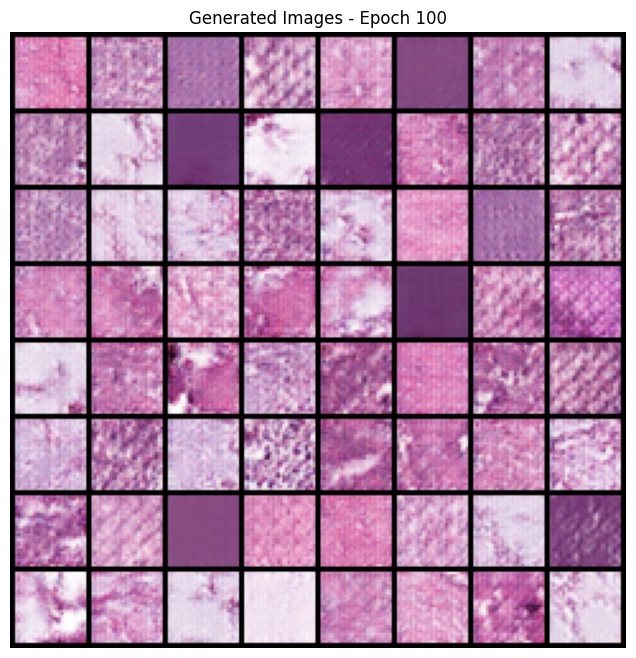

✅ Saved and displayed generated samples at epoch 100
💾 Saved checkpoint at epoch 100


Epoch 101/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.110, g_loss=1.127]


[Epoch 101] D_loss=1.0853 | G_loss=1.1959


Epoch 102/1200: 100%|██████████| 44/44 [00:20<00:00,  2.12it/s, d_loss=1.183, g_loss=0.947]


[Epoch 102] D_loss=1.1165 | G_loss=1.1739


Epoch 103/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.986, g_loss=1.140]


[Epoch 103] D_loss=1.0866 | G_loss=1.1390


Epoch 104/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.451, g_loss=0.858]


[Epoch 104] D_loss=1.1005 | G_loss=1.1685


Epoch 105/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.008, g_loss=1.090]


[Epoch 105] D_loss=1.0863 | G_loss=1.1492


Epoch 106/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.202, g_loss=1.089]


[Epoch 106] D_loss=1.0880 | G_loss=1.1262


Epoch 107/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.197, g_loss=1.190]


[Epoch 107] D_loss=1.0640 | G_loss=1.1339


Epoch 108/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.086, g_loss=1.393]


[Epoch 108] D_loss=1.0529 | G_loss=1.1591


Epoch 109/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.241, g_loss=1.144]


[Epoch 109] D_loss=1.0552 | G_loss=1.1985


Epoch 110/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.058, g_loss=1.079]


[Epoch 110] D_loss=1.0958 | G_loss=1.1865


Epoch 111/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.304, g_loss=1.258]


[Epoch 111] D_loss=1.0677 | G_loss=1.1484


Epoch 112/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.094, g_loss=1.230]


[Epoch 112] D_loss=1.0530 | G_loss=1.2070


Epoch 113/1200: 100%|██████████| 44/44 [00:20<00:00,  2.12it/s, d_loss=1.123, g_loss=1.075]


[Epoch 113] D_loss=1.0706 | G_loss=1.1676


Epoch 114/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.948, g_loss=1.181]


[Epoch 114] D_loss=1.0508 | G_loss=1.1413


Epoch 115/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.947, g_loss=1.267]


[Epoch 115] D_loss=1.0802 | G_loss=1.1527


Epoch 116/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.181, g_loss=1.208]


[Epoch 116] D_loss=1.0620 | G_loss=1.1750


Epoch 117/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.756, g_loss=1.397]


[Epoch 117] D_loss=1.0255 | G_loss=1.2199


Epoch 118/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.060, g_loss=1.257]


[Epoch 118] D_loss=1.0526 | G_loss=1.2285


Epoch 119/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.003, g_loss=0.992]


[Epoch 119] D_loss=1.0527 | G_loss=1.1827


Epoch 120/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.815, g_loss=1.409]


[Epoch 120] D_loss=1.0396 | G_loss=1.1940


Epoch 121/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.769, g_loss=1.280]


[Epoch 121] D_loss=1.0282 | G_loss=1.1896


Epoch 122/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.164, g_loss=1.055]


[Epoch 122] D_loss=1.0399 | G_loss=1.2360


Epoch 123/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.112, g_loss=1.038]


[Epoch 123] D_loss=1.0744 | G_loss=1.2056


Epoch 124/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.119, g_loss=1.497]


[Epoch 124] D_loss=1.0379 | G_loss=1.2156


Epoch 125/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.890, g_loss=1.109]


[Epoch 125] D_loss=1.0430 | G_loss=1.1835


Epoch 126/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.924, g_loss=1.405]


[Epoch 126] D_loss=1.0426 | G_loss=1.2013


Epoch 127/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.832, g_loss=1.457]


[Epoch 127] D_loss=1.0322 | G_loss=1.2018


Epoch 128/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.851, g_loss=1.339]


[Epoch 128] D_loss=1.0499 | G_loss=1.2078


Epoch 129/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.971, g_loss=1.070]


[Epoch 129] D_loss=1.0777 | G_loss=1.1538


Epoch 130/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.870, g_loss=1.180]


[Epoch 130] D_loss=1.0277 | G_loss=1.1962


Epoch 131/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.027, g_loss=1.220]


[Epoch 131] D_loss=1.0352 | G_loss=1.1812


Epoch 132/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.030, g_loss=1.455]


[Epoch 132] D_loss=0.9956 | G_loss=1.2202


Epoch 133/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.137, g_loss=1.186]


[Epoch 133] D_loss=0.9958 | G_loss=1.3080


Epoch 134/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.992, g_loss=1.366]


[Epoch 134] D_loss=1.0482 | G_loss=1.2271


Epoch 135/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.803, g_loss=1.267]


[Epoch 135] D_loss=0.9869 | G_loss=1.3294


Epoch 136/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.108, g_loss=1.232]


[Epoch 136] D_loss=1.0127 | G_loss=1.2642


Epoch 137/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.977, g_loss=1.261]


[Epoch 137] D_loss=1.0017 | G_loss=1.2321


Epoch 138/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.809, g_loss=1.168]


[Epoch 138] D_loss=1.0657 | G_loss=1.2149


Epoch 139/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.015, g_loss=1.532]


[Epoch 139] D_loss=0.9844 | G_loss=1.2859


Epoch 140/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.280, g_loss=1.032]


[Epoch 140] D_loss=1.0133 | G_loss=1.2346


Epoch 141/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.125, g_loss=1.026]


[Epoch 141] D_loss=0.9386 | G_loss=1.3756


Epoch 142/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.120, g_loss=1.304]


[Epoch 142] D_loss=1.0434 | G_loss=1.2757


Epoch 143/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.180, g_loss=1.427]


[Epoch 143] D_loss=0.9419 | G_loss=1.3487


Epoch 144/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.265, g_loss=1.151]


[Epoch 144] D_loss=1.0270 | G_loss=1.3412


Epoch 145/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.817, g_loss=1.548]


[Epoch 145] D_loss=1.0250 | G_loss=1.2396


Epoch 146/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.066, g_loss=1.204]


[Epoch 146] D_loss=1.0351 | G_loss=1.2594


Epoch 147/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.857, g_loss=1.736]


[Epoch 147] D_loss=1.0499 | G_loss=1.2486


Epoch 148/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.808, g_loss=1.189]


[Epoch 148] D_loss=1.0309 | G_loss=1.2297


Epoch 149/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.146, g_loss=1.261]


[Epoch 149] D_loss=1.0387 | G_loss=1.2106


Epoch 150/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.121, g_loss=1.088]


[Epoch 150] D_loss=0.9822 | G_loss=1.2664


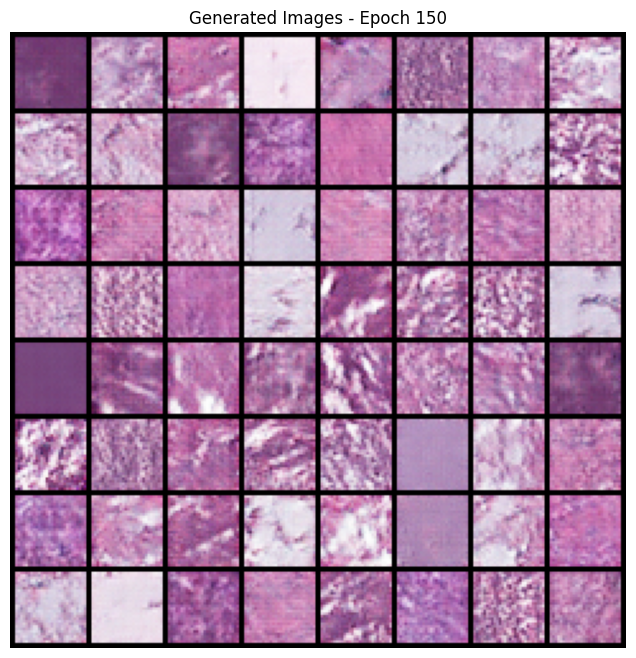

✅ Saved and displayed generated samples at epoch 150
💾 Saved checkpoint at epoch 150


Epoch 151/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.884, g_loss=1.464]


[Epoch 151] D_loss=1.0238 | G_loss=1.2762


Epoch 152/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.792, g_loss=1.421]


[Epoch 152] D_loss=1.0047 | G_loss=1.2705


Epoch 153/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.060, g_loss=1.035]


[Epoch 153] D_loss=1.0065 | G_loss=1.2840


Epoch 154/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.288, g_loss=1.324]


[Epoch 154] D_loss=1.0517 | G_loss=1.2786


Epoch 155/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.029, g_loss=1.256]


[Epoch 155] D_loss=1.0203 | G_loss=1.2609


Epoch 156/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.998, g_loss=1.413]


[Epoch 156] D_loss=1.0215 | G_loss=1.2921


Epoch 157/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.904, g_loss=1.349]


[Epoch 157] D_loss=1.0268 | G_loss=1.2506


Epoch 158/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.186, g_loss=1.123]


[Epoch 158] D_loss=1.0069 | G_loss=1.2561


Epoch 159/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.103, g_loss=0.998]


[Epoch 159] D_loss=1.0356 | G_loss=1.2298


Epoch 160/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.118, g_loss=1.118]


[Epoch 160] D_loss=1.0169 | G_loss=1.2382


Epoch 161/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.106, g_loss=1.184]


[Epoch 161] D_loss=0.9637 | G_loss=1.2741


Epoch 162/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.031, g_loss=1.208]


[Epoch 162] D_loss=1.0052 | G_loss=1.2929


Epoch 163/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.091, g_loss=0.991]


[Epoch 163] D_loss=0.9988 | G_loss=1.2980


Epoch 164/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.581, g_loss=1.076]


[Epoch 164] D_loss=0.9770 | G_loss=1.3117


Epoch 165/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.626, g_loss=2.004]


[Epoch 165] D_loss=1.0534 | G_loss=1.2807


Epoch 166/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.865, g_loss=1.246]


[Epoch 166] D_loss=1.0206 | G_loss=1.2497


Epoch 167/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.105, g_loss=1.367]


[Epoch 167] D_loss=0.9928 | G_loss=1.3337


Epoch 168/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.871, g_loss=1.278]


[Epoch 168] D_loss=0.9603 | G_loss=1.3061


Epoch 169/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.004, g_loss=1.663]


[Epoch 169] D_loss=1.0016 | G_loss=1.2929


Epoch 170/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.840, g_loss=1.213]


[Epoch 170] D_loss=0.9874 | G_loss=1.3092


Epoch 171/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.997, g_loss=1.436]


[Epoch 171] D_loss=0.9320 | G_loss=1.4496


Epoch 172/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.519, g_loss=1.970]


[Epoch 172] D_loss=0.9422 | G_loss=1.3696


Epoch 173/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.796, g_loss=1.409]


[Epoch 173] D_loss=0.9965 | G_loss=1.3986


Epoch 174/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.006, g_loss=1.210]


[Epoch 174] D_loss=1.0044 | G_loss=1.2920


Epoch 175/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.827, g_loss=1.368]


[Epoch 175] D_loss=0.9588 | G_loss=1.2802


Epoch 176/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.949, g_loss=1.080]


[Epoch 176] D_loss=0.9799 | G_loss=1.4039


Epoch 177/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=0.703, g_loss=1.639]


[Epoch 177] D_loss=1.0229 | G_loss=1.3088


Epoch 178/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.361, g_loss=1.256]


[Epoch 178] D_loss=0.9529 | G_loss=1.3592


Epoch 179/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.118, g_loss=1.266]


[Epoch 179] D_loss=0.9304 | G_loss=1.3832


Epoch 180/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.015, g_loss=1.319]


[Epoch 180] D_loss=1.0353 | G_loss=1.3168


Epoch 181/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.128, g_loss=1.045]


[Epoch 181] D_loss=0.9686 | G_loss=1.3521


Epoch 182/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.371, g_loss=0.854]


[Epoch 182] D_loss=1.0116 | G_loss=1.3231


Epoch 183/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.172, g_loss=0.984]


[Epoch 183] D_loss=0.9691 | G_loss=1.2763


Epoch 184/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=0.685, g_loss=1.529]


[Epoch 184] D_loss=0.9590 | G_loss=1.3420


Epoch 185/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.110, g_loss=1.092]


[Epoch 185] D_loss=0.9740 | G_loss=1.3332


Epoch 186/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=0.989, g_loss=1.614]


[Epoch 186] D_loss=0.9909 | G_loss=1.3622


Epoch 187/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=2.126, g_loss=1.168]


[Epoch 187] D_loss=0.9925 | G_loss=1.3675


Epoch 188/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.301, g_loss=0.936]


[Epoch 188] D_loss=0.9631 | G_loss=1.4038


Epoch 189/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=0.968, g_loss=1.419]


[Epoch 189] D_loss=0.9964 | G_loss=1.3155


Epoch 190/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.967, g_loss=1.028]


[Epoch 190] D_loss=1.0010 | G_loss=1.3542


Epoch 191/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=1.016, g_loss=1.550]


[Epoch 191] D_loss=0.9474 | G_loss=1.3727


Epoch 192/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.482, g_loss=1.058]


[Epoch 192] D_loss=0.9572 | G_loss=1.3766


Epoch 193/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.986, g_loss=1.632]


[Epoch 193] D_loss=0.9602 | G_loss=1.3662


Epoch 194/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.159, g_loss=1.271]


[Epoch 194] D_loss=0.9950 | G_loss=1.3433


Epoch 195/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.204, g_loss=1.163]


[Epoch 195] D_loss=0.9370 | G_loss=1.4501


Epoch 196/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.848, g_loss=1.628]


[Epoch 196] D_loss=0.9437 | G_loss=1.4039


Epoch 197/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.837, g_loss=1.232]


[Epoch 197] D_loss=0.9834 | G_loss=1.3531


Epoch 198/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.012, g_loss=1.236]


[Epoch 198] D_loss=0.9556 | G_loss=1.3582


Epoch 199/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.771, g_loss=1.519]


[Epoch 199] D_loss=0.9331 | G_loss=1.4219


Epoch 200/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.444, g_loss=2.117]


[Epoch 200] D_loss=0.8924 | G_loss=1.4152


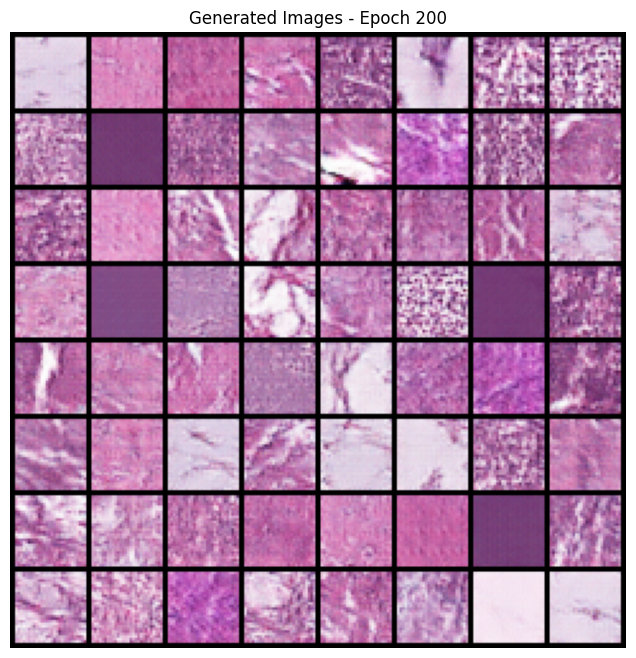

✅ Saved and displayed generated samples at epoch 200
💾 Saved checkpoint at epoch 200


Epoch 201/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.827, g_loss=1.456]


[Epoch 201] D_loss=0.9358 | G_loss=1.5109


Epoch 202/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.296, g_loss=2.272]


[Epoch 202] D_loss=0.9132 | G_loss=1.4691


Epoch 203/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.226, g_loss=1.192]


[Epoch 203] D_loss=0.9961 | G_loss=1.3741


Epoch 204/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.022, g_loss=1.875]


[Epoch 204] D_loss=0.9544 | G_loss=1.4342


Epoch 205/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.750, g_loss=1.430]


[Epoch 205] D_loss=0.9467 | G_loss=1.4936


Epoch 206/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.507, g_loss=1.768]


[Epoch 206] D_loss=0.8989 | G_loss=1.4131


Epoch 207/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.246, g_loss=2.220]


[Epoch 207] D_loss=0.9767 | G_loss=1.5079


Epoch 208/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.050, g_loss=1.286]


[Epoch 208] D_loss=0.9709 | G_loss=1.3612


Epoch 209/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.719, g_loss=1.518]


[Epoch 209] D_loss=0.9616 | G_loss=1.3951


Epoch 210/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.964, g_loss=1.239]


[Epoch 210] D_loss=0.9301 | G_loss=1.4315


Epoch 211/1200: 100%|██████████| 44/44 [00:20<00:00,  2.16it/s, d_loss=0.988, g_loss=1.278]


[Epoch 211] D_loss=0.9311 | G_loss=1.3860


Epoch 212/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.966, g_loss=1.202]


[Epoch 212] D_loss=0.9026 | G_loss=1.5020


Epoch 213/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.106, g_loss=1.385]


[Epoch 213] D_loss=0.9414 | G_loss=1.4862


Epoch 214/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.043, g_loss=1.136]


[Epoch 214] D_loss=0.8976 | G_loss=1.4569


Epoch 215/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.989, g_loss=1.490]


[Epoch 215] D_loss=0.9348 | G_loss=1.4221


Epoch 216/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.703, g_loss=1.435]


[Epoch 216] D_loss=0.9340 | G_loss=1.4418


Epoch 217/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.053, g_loss=1.174]


[Epoch 217] D_loss=0.9287 | G_loss=1.4437


Epoch 218/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.904, g_loss=1.333]


[Epoch 218] D_loss=0.9151 | G_loss=1.4425


Epoch 219/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.070, g_loss=1.216]


[Epoch 219] D_loss=0.9181 | G_loss=1.4375


Epoch 220/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.095, g_loss=1.421]


[Epoch 220] D_loss=0.8238 | G_loss=1.5736


Epoch 221/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.313, g_loss=1.258]


[Epoch 221] D_loss=0.8880 | G_loss=1.4546


Epoch 222/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.686, g_loss=1.662]


[Epoch 222] D_loss=0.9029 | G_loss=1.5738


Epoch 223/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.494, g_loss=2.054]


[Epoch 223] D_loss=0.9103 | G_loss=1.4852


Epoch 224/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.885, g_loss=1.207]


[Epoch 224] D_loss=0.8960 | G_loss=1.5291


Epoch 225/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.778, g_loss=1.403]


[Epoch 225] D_loss=0.9476 | G_loss=1.4951


Epoch 226/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.724, g_loss=1.688]


[Epoch 226] D_loss=0.8909 | G_loss=1.4893


Epoch 227/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.188, g_loss=1.151]


[Epoch 227] D_loss=0.8995 | G_loss=1.5364


Epoch 228/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.592, g_loss=2.195]


[Epoch 228] D_loss=0.8652 | G_loss=1.4869


Epoch 229/1200: 100%|██████████| 44/44 [00:20<00:00,  2.12it/s, d_loss=1.153, g_loss=1.118]


[Epoch 229] D_loss=0.8934 | G_loss=1.5994


Epoch 230/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.932, g_loss=1.540]


[Epoch 230] D_loss=0.8955 | G_loss=1.5858


Epoch 231/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.543, g_loss=1.809]


[Epoch 231] D_loss=0.8397 | G_loss=1.5155


Epoch 232/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.090, g_loss=2.084]


[Epoch 232] D_loss=0.8898 | G_loss=1.5785


Epoch 233/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.548, g_loss=1.883]


[Epoch 233] D_loss=0.8757 | G_loss=1.5498


Epoch 234/1200: 100%|██████████| 44/44 [00:20<00:00,  2.12it/s, d_loss=0.795, g_loss=1.565]


[Epoch 234] D_loss=0.8310 | G_loss=1.6022


Epoch 235/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.890, g_loss=1.569]


[Epoch 235] D_loss=0.8684 | G_loss=1.6689


Epoch 236/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.727, g_loss=1.297]


[Epoch 236] D_loss=0.9245 | G_loss=1.4589


Epoch 237/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.949, g_loss=1.291]


[Epoch 237] D_loss=0.8796 | G_loss=1.5436


Epoch 238/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.933, g_loss=1.357]


[Epoch 238] D_loss=0.9026 | G_loss=1.4977


Epoch 239/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.831, g_loss=1.352]


[Epoch 239] D_loss=0.9001 | G_loss=1.5695


Epoch 240/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.938, g_loss=1.524]


[Epoch 240] D_loss=0.8682 | G_loss=1.5710


Epoch 241/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.951, g_loss=1.392]


[Epoch 241] D_loss=0.8557 | G_loss=1.5866


Epoch 242/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.776, g_loss=2.106]


[Epoch 242] D_loss=0.8503 | G_loss=1.6626


Epoch 243/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.263, g_loss=1.431]


[Epoch 243] D_loss=0.8343 | G_loss=1.6041


Epoch 244/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.055, g_loss=1.896]


[Epoch 244] D_loss=0.8660 | G_loss=1.5821


Epoch 245/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.905, g_loss=1.429]


[Epoch 245] D_loss=0.8812 | G_loss=1.5308


Epoch 246/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.763, g_loss=1.608]


[Epoch 246] D_loss=0.8758 | G_loss=1.6074


Epoch 247/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.642, g_loss=2.006]


[Epoch 247] D_loss=0.8271 | G_loss=1.6960


Epoch 248/1200: 100%|██████████| 44/44 [00:20<00:00,  2.11it/s, d_loss=0.631, g_loss=1.817]


[Epoch 248] D_loss=0.8753 | G_loss=1.5603


Epoch 249/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.470, g_loss=1.182]


[Epoch 249] D_loss=0.8373 | G_loss=1.6569


Epoch 250/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.366, g_loss=1.916]


[Epoch 250] D_loss=0.8689 | G_loss=1.6109


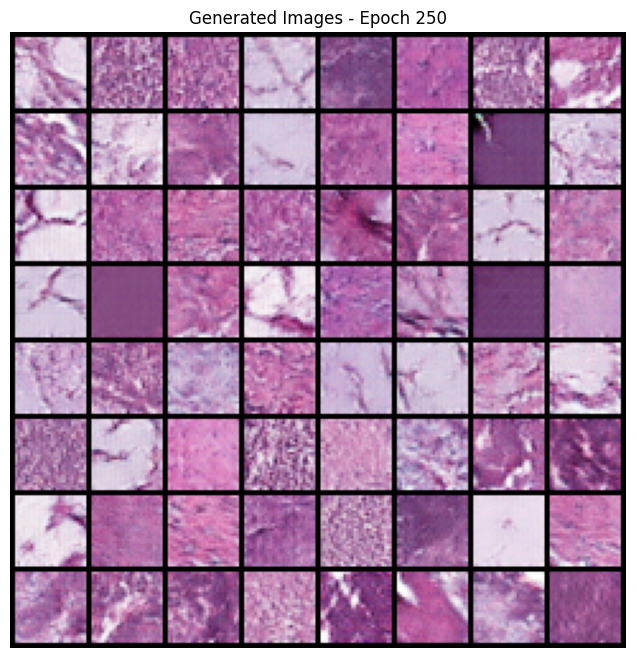

✅ Saved and displayed generated samples at epoch 250
💾 Saved checkpoint at epoch 250


Epoch 251/1200: 100%|██████████| 44/44 [00:20<00:00,  2.12it/s, d_loss=1.175, g_loss=1.927]


[Epoch 251] D_loss=0.8711 | G_loss=1.5641


Epoch 252/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.614, g_loss=1.511]


[Epoch 252] D_loss=0.8114 | G_loss=1.5799


Epoch 253/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.370, g_loss=2.011]


[Epoch 253] D_loss=0.8085 | G_loss=1.6989


Epoch 254/1200: 100%|██████████| 44/44 [00:20<00:00,  2.12it/s, d_loss=0.942, g_loss=1.671]


[Epoch 254] D_loss=0.8117 | G_loss=1.6298


Epoch 255/1200: 100%|██████████| 44/44 [00:20<00:00,  2.12it/s, d_loss=0.978, g_loss=1.556]


[Epoch 255] D_loss=0.8362 | G_loss=1.6274


Epoch 256/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.911, g_loss=1.523]


[Epoch 256] D_loss=0.9526 | G_loss=1.5687


Epoch 257/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.035, g_loss=1.181]


[Epoch 257] D_loss=0.8268 | G_loss=1.6546


Epoch 258/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.470, g_loss=1.778]


[Epoch 258] D_loss=0.7968 | G_loss=1.5923


Epoch 259/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.581, g_loss=1.774]


[Epoch 259] D_loss=0.8895 | G_loss=1.6691


Epoch 260/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.898, g_loss=1.777]


[Epoch 260] D_loss=0.7324 | G_loss=1.7079


Epoch 261/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.042, g_loss=1.692]


[Epoch 261] D_loss=0.7920 | G_loss=1.6725


Epoch 262/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.893, g_loss=1.514]


[Epoch 262] D_loss=0.8921 | G_loss=1.6793


Epoch 263/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.656, g_loss=1.547]


[Epoch 263] D_loss=0.7885 | G_loss=1.6129


Epoch 264/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.602, g_loss=1.726]


[Epoch 264] D_loss=0.8094 | G_loss=1.7062


Epoch 265/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.080, g_loss=1.724]


[Epoch 265] D_loss=0.8298 | G_loss=1.6461


Epoch 266/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.246, g_loss=1.429]


[Epoch 266] D_loss=0.9477 | G_loss=1.5536


Epoch 267/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.143, g_loss=1.445]


[Epoch 267] D_loss=0.7794 | G_loss=1.6435


Epoch 268/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.727, g_loss=1.558]


[Epoch 268] D_loss=0.7846 | G_loss=1.6517


Epoch 269/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.726, g_loss=2.020]


[Epoch 269] D_loss=0.8609 | G_loss=1.6758


Epoch 270/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.587, g_loss=2.108]


[Epoch 270] D_loss=0.7369 | G_loss=1.7377


Epoch 271/1200: 100%|██████████| 44/44 [00:20<00:00,  2.12it/s, d_loss=1.416, g_loss=1.982]


[Epoch 271] D_loss=0.8487 | G_loss=1.8676


Epoch 272/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.010, g_loss=1.420]


[Epoch 272] D_loss=0.8825 | G_loss=1.6582


Epoch 273/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.577, g_loss=2.056]


[Epoch 273] D_loss=0.8436 | G_loss=1.6227


Epoch 274/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.107, g_loss=1.590]


[Epoch 274] D_loss=0.8647 | G_loss=1.7224


Epoch 275/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.054, g_loss=1.687]


[Epoch 275] D_loss=0.7961 | G_loss=1.6973


Epoch 276/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.418, g_loss=2.042]


[Epoch 276] D_loss=0.7701 | G_loss=1.6631


Epoch 277/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.067, g_loss=1.241]


[Epoch 277] D_loss=0.8466 | G_loss=1.6947


Epoch 278/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.467, g_loss=1.997]


[Epoch 278] D_loss=0.6971 | G_loss=1.7817


Epoch 279/1200: 100%|██████████| 44/44 [00:20<00:00,  2.12it/s, d_loss=0.611, g_loss=1.788]


[Epoch 279] D_loss=0.8261 | G_loss=1.7995


Epoch 280/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.579, g_loss=1.818]


[Epoch 280] D_loss=0.7947 | G_loss=1.7537


Epoch 281/1200: 100%|██████████| 44/44 [00:20<00:00,  2.12it/s, d_loss=0.722, g_loss=2.150]


[Epoch 281] D_loss=0.7469 | G_loss=1.8060


Epoch 282/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.914, g_loss=1.557]


[Epoch 282] D_loss=0.7441 | G_loss=1.8104


Epoch 283/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.726, g_loss=1.792]


[Epoch 283] D_loss=0.7497 | G_loss=1.7462


Epoch 284/1200: 100%|██████████| 44/44 [00:20<00:00,  2.12it/s, d_loss=0.742, g_loss=1.834]


[Epoch 284] D_loss=0.8276 | G_loss=1.7635


Epoch 285/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.914, g_loss=1.704]


[Epoch 285] D_loss=0.8009 | G_loss=1.8206


Epoch 286/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.029, g_loss=1.845]


[Epoch 286] D_loss=0.7826 | G_loss=1.7794


Epoch 287/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.914, g_loss=1.243]


[Epoch 287] D_loss=0.7852 | G_loss=1.7072


Epoch 288/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.927, g_loss=1.498]


[Epoch 288] D_loss=0.7838 | G_loss=1.8279


Epoch 289/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.867, g_loss=1.543]


[Epoch 289] D_loss=0.7732 | G_loss=1.7048


Epoch 290/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.812, g_loss=1.550]


[Epoch 290] D_loss=0.7866 | G_loss=1.7390


Epoch 291/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.474, g_loss=2.221]


[Epoch 291] D_loss=0.7901 | G_loss=1.7546


Epoch 292/1200: 100%|██████████| 44/44 [00:20<00:00,  2.12it/s, d_loss=0.583, g_loss=2.089]


[Epoch 292] D_loss=0.7227 | G_loss=1.8321


Epoch 293/1200: 100%|██████████| 44/44 [00:20<00:00,  2.12it/s, d_loss=0.496, g_loss=1.921]


[Epoch 293] D_loss=0.8124 | G_loss=1.7647


Epoch 294/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.780, g_loss=1.727]


[Epoch 294] D_loss=0.8630 | G_loss=1.7265


Epoch 295/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.515, g_loss=1.481]


[Epoch 295] D_loss=0.7337 | G_loss=1.8376


Epoch 296/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.452, g_loss=2.115]


[Epoch 296] D_loss=0.7745 | G_loss=1.7447


Epoch 297/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.275, g_loss=2.172]


[Epoch 297] D_loss=0.7331 | G_loss=1.8489


Epoch 298/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.089, g_loss=1.658]


[Epoch 298] D_loss=0.7537 | G_loss=1.8698


Epoch 299/1200: 100%|██████████| 44/44 [00:20<00:00,  2.12it/s, d_loss=1.092, g_loss=2.045]


[Epoch 299] D_loss=0.7126 | G_loss=1.8774


Epoch 300/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.685, g_loss=2.073]


[Epoch 300] D_loss=0.7427 | G_loss=1.9328


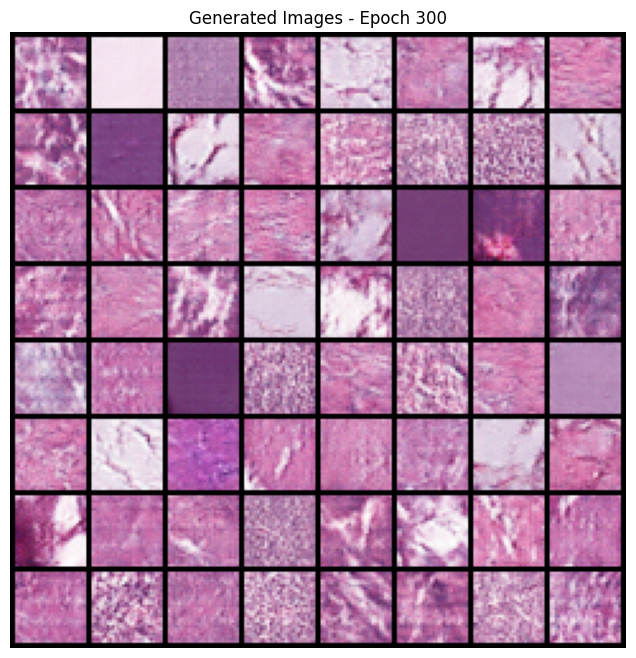

✅ Saved and displayed generated samples at epoch 300
💾 Saved checkpoint at epoch 300


Epoch 301/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.594, g_loss=2.293]


[Epoch 301] D_loss=0.7310 | G_loss=1.9135


Epoch 302/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.789, g_loss=1.344]


[Epoch 302] D_loss=0.7796 | G_loss=1.7702


Epoch 303/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.639, g_loss=1.838]


[Epoch 303] D_loss=0.9033 | G_loss=1.8051


Epoch 304/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.804, g_loss=1.929]


[Epoch 304] D_loss=0.7857 | G_loss=1.7850


Epoch 305/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.687, g_loss=2.010]


[Epoch 305] D_loss=0.7523 | G_loss=1.8008


Epoch 306/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.494, g_loss=2.222]


[Epoch 306] D_loss=0.7659 | G_loss=1.8303


Epoch 307/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.268, g_loss=2.608]


[Epoch 307] D_loss=0.6558 | G_loss=1.9901


Epoch 308/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.861, g_loss=1.719]


[Epoch 308] D_loss=0.7114 | G_loss=1.9547


Epoch 309/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.970, g_loss=1.637]


[Epoch 309] D_loss=0.7688 | G_loss=1.9188


Epoch 310/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.480, g_loss=1.424]


[Epoch 310] D_loss=0.7748 | G_loss=1.8790


Epoch 311/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.353, g_loss=2.047]


[Epoch 311] D_loss=0.6604 | G_loss=1.9388


Epoch 312/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.584, g_loss=2.576]


[Epoch 312] D_loss=0.8386 | G_loss=1.9315


Epoch 313/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.493, g_loss=2.212]


[Epoch 313] D_loss=0.6919 | G_loss=1.8873


Epoch 314/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.994, g_loss=1.626]


[Epoch 314] D_loss=0.8154 | G_loss=1.8745


Epoch 315/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.572, g_loss=1.765]


[Epoch 315] D_loss=0.6860 | G_loss=1.8783


Epoch 316/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.642, g_loss=1.963]


[Epoch 316] D_loss=0.7847 | G_loss=1.8174


Epoch 317/1200: 100%|██████████| 44/44 [00:20<00:00,  2.11it/s, d_loss=0.478, g_loss=2.331]


[Epoch 317] D_loss=0.6813 | G_loss=1.9212


Epoch 318/1200: 100%|██████████| 44/44 [00:20<00:00,  2.11it/s, d_loss=0.719, g_loss=1.683]


[Epoch 318] D_loss=0.7029 | G_loss=2.0146


Epoch 319/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.018, g_loss=1.249]


[Epoch 319] D_loss=0.7161 | G_loss=1.8699


Epoch 320/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.657, g_loss=2.225]


[Epoch 320] D_loss=0.7618 | G_loss=1.8457


Epoch 321/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.789, g_loss=1.889]


[Epoch 321] D_loss=0.8335 | G_loss=1.8996


Epoch 322/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=1.007, g_loss=1.913]


[Epoch 322] D_loss=0.7478 | G_loss=1.8643


Epoch 323/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.516, g_loss=2.128]


[Epoch 323] D_loss=0.6832 | G_loss=1.9293


Epoch 324/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.158, g_loss=3.086]


[Epoch 324] D_loss=0.7049 | G_loss=1.9274


Epoch 325/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.929, g_loss=1.930]


[Epoch 325] D_loss=0.7625 | G_loss=1.9333


Epoch 326/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.481, g_loss=2.160]


[Epoch 326] D_loss=0.7881 | G_loss=1.8951


Epoch 327/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.544, g_loss=2.018]


[Epoch 327] D_loss=0.6855 | G_loss=1.9550


Epoch 328/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.608, g_loss=1.895]


[Epoch 328] D_loss=0.6994 | G_loss=1.9235


Epoch 329/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.296, g_loss=2.781]


[Epoch 329] D_loss=0.7026 | G_loss=1.9424


Epoch 330/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.641, g_loss=1.797]


[Epoch 330] D_loss=0.9108 | G_loss=1.8936


Epoch 331/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.335, g_loss=2.386]


[Epoch 331] D_loss=0.6863 | G_loss=1.9295


Epoch 332/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.977, g_loss=2.014]


[Epoch 332] D_loss=0.7023 | G_loss=1.9761


Epoch 333/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.603, g_loss=2.057]


[Epoch 333] D_loss=0.6829 | G_loss=2.0130


Epoch 334/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.382, g_loss=2.193]


[Epoch 334] D_loss=0.7375 | G_loss=1.9088


Epoch 335/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.288, g_loss=2.406]


[Epoch 335] D_loss=0.6912 | G_loss=1.9901


Epoch 336/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.989, g_loss=1.778]


[Epoch 336] D_loss=0.6886 | G_loss=1.9551


Epoch 337/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.235, g_loss=1.695]


[Epoch 337] D_loss=0.6937 | G_loss=2.0107


Epoch 338/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.452, g_loss=2.800]


[Epoch 338] D_loss=0.5975 | G_loss=2.0266


Epoch 339/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.825, g_loss=1.624]


[Epoch 339] D_loss=0.6521 | G_loss=2.0467


Epoch 340/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.194, g_loss=2.829]


[Epoch 340] D_loss=0.6943 | G_loss=2.0293


Epoch 341/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.415, g_loss=2.264]


[Epoch 341] D_loss=0.7440 | G_loss=1.9772


Epoch 342/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.562, g_loss=1.350]


[Epoch 342] D_loss=0.6394 | G_loss=2.0162


Epoch 343/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.508, g_loss=1.897]


[Epoch 343] D_loss=0.7286 | G_loss=1.9710


Epoch 344/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.879, g_loss=2.197]


[Epoch 344] D_loss=0.6142 | G_loss=2.0882


Epoch 345/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.453, g_loss=2.164]


[Epoch 345] D_loss=0.7220 | G_loss=2.0283


Epoch 346/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.557, g_loss=1.843]


[Epoch 346] D_loss=0.7694 | G_loss=1.9745


Epoch 347/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.320, g_loss=1.282]


[Epoch 347] D_loss=0.6349 | G_loss=1.9403


Epoch 348/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=1.216, g_loss=1.417]


[Epoch 348] D_loss=0.6812 | G_loss=2.0535


Epoch 349/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.635, g_loss=1.940]


[Epoch 349] D_loss=0.8194 | G_loss=1.9340


Epoch 350/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.692, g_loss=1.807]


[Epoch 350] D_loss=0.7046 | G_loss=2.0110


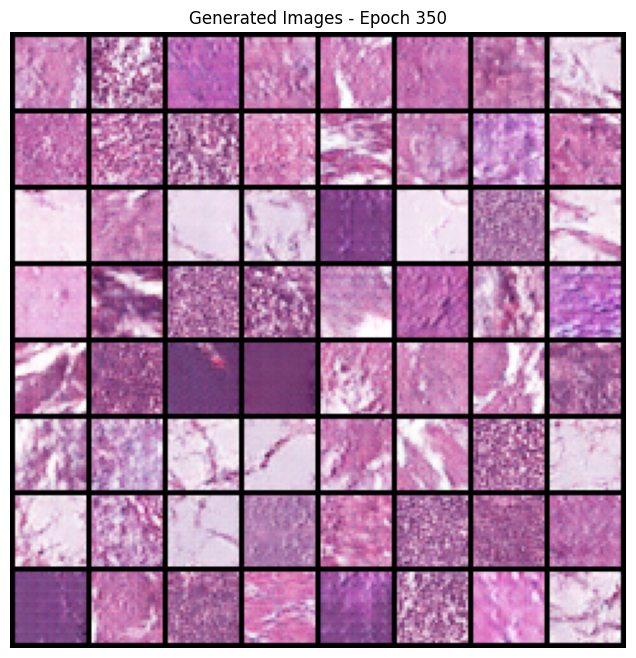

✅ Saved and displayed generated samples at epoch 350
💾 Saved checkpoint at epoch 350


Epoch 351/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.323, g_loss=2.477]


[Epoch 351] D_loss=0.6658 | G_loss=2.0169


Epoch 352/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.413, g_loss=1.908]


[Epoch 352] D_loss=0.7052 | G_loss=2.0202


Epoch 353/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.594, g_loss=1.915]


[Epoch 353] D_loss=0.6356 | G_loss=2.1518


Epoch 354/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.724, g_loss=1.920]


[Epoch 354] D_loss=0.5930 | G_loss=2.1405


Epoch 355/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.605, g_loss=1.854]


[Epoch 355] D_loss=0.6621 | G_loss=2.0468


Epoch 356/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.588, g_loss=2.106]


[Epoch 356] D_loss=0.6383 | G_loss=2.1177


Epoch 357/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.669, g_loss=1.961]


[Epoch 357] D_loss=0.6011 | G_loss=2.0829


Epoch 358/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.647, g_loss=1.847]


[Epoch 358] D_loss=0.5476 | G_loss=2.2495


Epoch 359/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.621, g_loss=1.695]


[Epoch 359] D_loss=0.6844 | G_loss=2.0982


Epoch 360/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.874, g_loss=2.114]


[Epoch 360] D_loss=0.5935 | G_loss=2.1590


Epoch 361/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.933, g_loss=1.907]


[Epoch 361] D_loss=0.6614 | G_loss=2.2119


Epoch 362/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.790, g_loss=1.772]


[Epoch 362] D_loss=0.6904 | G_loss=2.2317


Epoch 363/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.119, g_loss=1.445]


[Epoch 363] D_loss=0.6541 | G_loss=2.1673


Epoch 364/1200: 100%|██████████| 44/44 [00:20<00:00,  2.11it/s, d_loss=1.020, g_loss=1.500]


[Epoch 364] D_loss=0.6002 | G_loss=2.1488


Epoch 365/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.694, g_loss=1.934]


[Epoch 365] D_loss=0.7098 | G_loss=2.0935


Epoch 366/1200: 100%|██████████| 44/44 [00:20<00:00,  2.11it/s, d_loss=0.703, g_loss=2.186]


[Epoch 366] D_loss=0.5783 | G_loss=2.1880


Epoch 367/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.906, g_loss=2.206]


[Epoch 367] D_loss=0.5978 | G_loss=2.1821


Epoch 368/1200: 100%|██████████| 44/44 [00:20<00:00,  2.11it/s, d_loss=0.639, g_loss=2.549]


[Epoch 368] D_loss=0.6793 | G_loss=2.1241


Epoch 369/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.765, g_loss=2.468]


[Epoch 369] D_loss=0.6983 | G_loss=2.1191


Epoch 370/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.687, g_loss=1.751]


[Epoch 370] D_loss=0.6429 | G_loss=2.1202


Epoch 371/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.818, g_loss=2.017]


[Epoch 371] D_loss=0.6759 | G_loss=2.0928


Epoch 372/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.253, g_loss=2.444]


[Epoch 372] D_loss=0.7255 | G_loss=2.0537


Epoch 373/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.662, g_loss=1.751]


[Epoch 373] D_loss=0.6069 | G_loss=2.1354


Epoch 374/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.365, g_loss=2.071]


[Epoch 374] D_loss=0.6990 | G_loss=2.2157


Epoch 375/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.528, g_loss=2.033]


[Epoch 375] D_loss=0.6020 | G_loss=2.0812


Epoch 376/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.348, g_loss=2.122]


[Epoch 376] D_loss=0.6395 | G_loss=2.1285


Epoch 377/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.476, g_loss=1.922]


[Epoch 377] D_loss=0.7425 | G_loss=2.0913


Epoch 378/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.053, g_loss=1.614]


[Epoch 378] D_loss=0.7233 | G_loss=2.1288


Epoch 379/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.826, g_loss=1.809]


[Epoch 379] D_loss=0.6218 | G_loss=2.1341


Epoch 380/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.491, g_loss=1.812]


[Epoch 380] D_loss=0.5805 | G_loss=2.2740


Epoch 381/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.799, g_loss=1.747]


[Epoch 381] D_loss=0.5769 | G_loss=2.2010


Epoch 382/1200: 100%|██████████| 44/44 [00:20<00:00,  2.12it/s, d_loss=0.626, g_loss=2.078]


[Epoch 382] D_loss=0.5943 | G_loss=2.1830


Epoch 383/1200: 100%|██████████| 44/44 [00:20<00:00,  2.12it/s, d_loss=0.351, g_loss=2.899]


[Epoch 383] D_loss=0.6421 | G_loss=2.4148


Epoch 384/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.278, g_loss=2.747]


[Epoch 384] D_loss=0.6209 | G_loss=2.3011


Epoch 385/1200: 100%|██████████| 44/44 [00:20<00:00,  2.12it/s, d_loss=0.665, g_loss=1.640]


[Epoch 385] D_loss=0.6369 | G_loss=2.1869


Epoch 386/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.944, g_loss=3.659]


[Epoch 386] D_loss=0.6623 | G_loss=2.2453


Epoch 387/1200: 100%|██████████| 44/44 [00:20<00:00,  2.11it/s, d_loss=0.537, g_loss=2.788]


[Epoch 387] D_loss=0.5740 | G_loss=2.2931


Epoch 388/1200: 100%|██████████| 44/44 [00:20<00:00,  2.11it/s, d_loss=0.424, g_loss=2.201]


[Epoch 388] D_loss=0.6242 | G_loss=2.1962


Epoch 389/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.552, g_loss=2.429]


[Epoch 389] D_loss=0.6534 | G_loss=2.1909


Epoch 390/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.109, g_loss=1.831]


[Epoch 390] D_loss=0.6367 | G_loss=2.1950


Epoch 391/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.628, g_loss=2.230]


[Epoch 391] D_loss=0.5899 | G_loss=2.2882


Epoch 392/1200: 100%|██████████| 44/44 [00:20<00:00,  2.12it/s, d_loss=1.110, g_loss=1.634]


[Epoch 392] D_loss=0.5698 | G_loss=2.3682


Epoch 393/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.860, g_loss=2.378]


[Epoch 393] D_loss=0.5056 | G_loss=2.3204


Epoch 394/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.531, g_loss=2.008]


[Epoch 394] D_loss=0.5780 | G_loss=2.3470


Epoch 395/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=1.382, g_loss=1.813]


[Epoch 395] D_loss=0.5522 | G_loss=2.4016


Epoch 396/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.317, g_loss=3.283]


[Epoch 396] D_loss=0.5511 | G_loss=2.3306


Epoch 397/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.430, g_loss=2.380]


[Epoch 397] D_loss=0.5315 | G_loss=2.3571


Epoch 398/1200: 100%|██████████| 44/44 [00:20<00:00,  2.15it/s, d_loss=0.600, g_loss=2.124]


[Epoch 398] D_loss=0.6569 | G_loss=2.4263


Epoch 399/1200: 100%|██████████| 44/44 [00:20<00:00,  2.12it/s, d_loss=0.813, g_loss=1.995]


[Epoch 399] D_loss=0.6138 | G_loss=2.3266


Epoch 400/1200: 100%|██████████| 44/44 [00:20<00:00,  2.12it/s, d_loss=0.132, g_loss=4.066]


[Epoch 400] D_loss=0.5231 | G_loss=2.5485


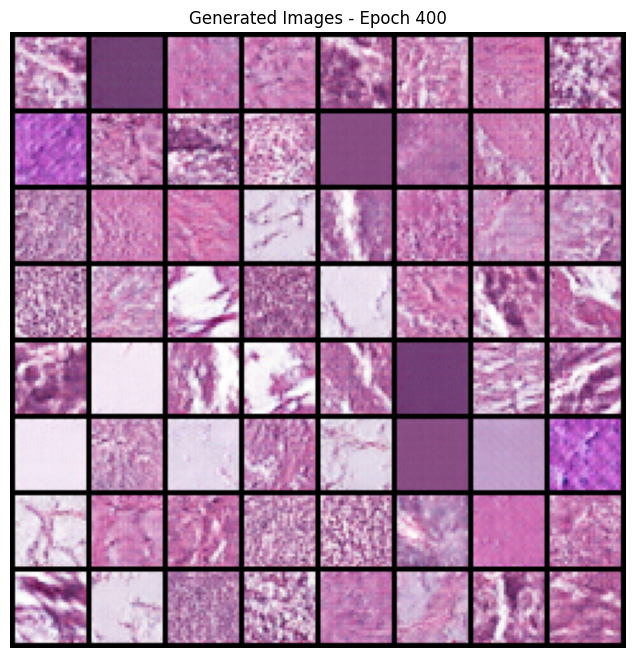

✅ Saved and displayed generated samples at epoch 400
💾 Saved checkpoint at epoch 400


Epoch 401/1200: 100%|██████████| 44/44 [00:20<00:00,  2.13it/s, d_loss=0.812, g_loss=2.088]


[Epoch 401] D_loss=0.6384 | G_loss=2.3159


Epoch 402/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.813, g_loss=1.999]


[Epoch 402] D_loss=0.5018 | G_loss=2.4272


Epoch 403/1200: 100%|██████████| 44/44 [00:20<00:00,  2.14it/s, d_loss=0.378, g_loss=2.286]


[Epoch 403] D_loss=0.6654 | G_loss=2.2369


Epoch 404/1200:  50%|█████     | 22/44 [00:10<00:10,  2.09it/s, d_loss=0.786, g_loss=2.220]


KeyboardInterrupt: 

In [ ]:
# Initial Training Loop

def train_dcgan_for_plot():
    G = Generator(C.z_dim, C.image_channels).to(device)
    D = Discriminator(C.image_channels).to(device)
    G.apply(weights_init)
    D.apply(weights_init)

    criterion = nn.BCEWithLogitsLoss()
    optG = optim.Adam(G.parameters(), lr=C.lr, betas=(C.beta1, C.beta2))
    optD = optim.Adam(D.parameters(), lr=C.lr, betas=(C.beta1, C.beta2))
    scaler = amp.GradScaler('cuda', enabled=C.amp)

    d_losses, g_losses = [], []
    print(f"Starting training for {C.num_epochs} epochs...")

    for epoch in range(C.num_epochs):
        G.train(); D.train()
        d_loss_total, g_loss_total = 0.0, 0.0
        pbar = tqdm(train_loader, desc=f"Epoch {epoch+1}/{C.num_epochs}")

        for real, _ in pbar:
            real = real.to(device)
            cur_bs = real.size(0)

            # Train Discriminator
            D.zero_grad(set_to_none=True)
            labels_real = torch.ones(cur_bs, 1, device=device)
            labels_fake = torch.zeros(cur_bs, 1, device=device)

            with amp.autocast('cuda', enabled=C.amp):
                out_real = D(real)
                d_loss_real = criterion(out_real, labels_real)

                z = torch.randn(cur_bs, C.z_dim, 1, 1, device=device) * 1.1
                fake = G(z)
                out_fake = D(fake.detach())
                d_loss_fake = criterion(out_fake, labels_fake)
                d_loss = d_loss_real + d_loss_fake

            scaler.scale(d_loss).backward()
            scaler.step(optD)

            # Train Generator
            G.zero_grad(set_to_none=True)
            with amp.autocast('cuda', enabled=C.amp):
                out_gen = D(fake)
                g_loss = criterion(out_gen, labels_real)

            scaler.scale(g_loss).backward()
            scaler.step(optG)
            scaler.update()

            d_loss_total += d_loss.item()
            g_loss_total += g_loss.item()
            pbar.set_postfix(d_loss=f"{d_loss.item():.3f}", g_loss=f"{g_loss.item():.3f}")

        # Compute epoch averages
        d_avg = d_loss_total / len(train_loader)
        g_avg = g_loss_total / len(train_loader)
        d_losses.append(d_avg)
        g_losses.append(g_avg)
        print(f"[Epoch {epoch+1}] D_loss={d_avg:.4f} | G_loss={g_avg:.4f}")


        # Show and Save Images every 100 epochs

        if (epoch + 1) % C.image_save_every == 0:
            z = torch.randn(64, C.z_dim, 1, 1, device=device) * 1.1
            with torch.no_grad(), amp.autocast('cuda', enabled=C.amp):
                fake = G(z)
            grid = vutils.make_grid((fake.clamp(-1, 1) + 1) / 2, nrow=8)
            img = np.transpose(grid.cpu().to(torch.float32).numpy(), (1, 2, 0))

            # Show live
            plt.figure(figsize=(8, 8))
            plt.axis("off")
            plt.title(f"Generated Images - Epoch {epoch+1}")
            plt.imshow(img)
            plt.show()

            # Save image to folder
            plt.imsave(f"{C.outdir}/epoch_{epoch+1:04d}_samples.png", img)
            print(f"Saved and displayed generated samples at epoch {epoch+1}")


        #  Save Checkpoint every 100 epochs

        if (epoch + 1) % C.save_every == 0:
            torch.save({
                "epoch": epoch,
                "G_state_dict": G.state_dict(),
                "D_state_dict": D.state_dict(),
                "optG": optG.state_dict(),
                "optD": optD.state_dict(),
                "d_losses": d_losses,
                "g_losses": g_losses
            }, os.path.join(C.ckpt_dir, f"dcgan_epoch_{epoch+1:04d}.pt"))
            print(f"💾 Saved checkpoint at epoch {epoch+1}")

    print("Training completed ")
    torch.save(G.state_dict(), os.path.join(C.ckpt_dir, "final_generator_dcgan.pth"))
    np.save(os.path.join(C.ckpt_dir, "d_losses.npy"), np.array(d_losses))
    np.save(os.path.join(C.ckpt_dir, "g_losses.npy"), np.array(g_losses))


# Run Training
if __name__ == "__main__":
    train_dcgan_for_plot()

I stopped the above run at 400 epoch because, it was taking too much of time to run. And it was consuming only 2GB of GPU resources. I wanted to increase the GPU utilization. So, once I modified the code to utilize the GPU, it ran faster for the below epochs. You can see that I have resumed the training below from 450

In [ ]:

# Training Loop Resume from epoch 400

def train_dcgan_for_plot():
    G = Generator(C.z_dim, C.image_channels).to(device)
    D = Discriminator(C.image_channels).to(device)
    G.apply(weights_init)
    D.apply(weights_init)

    criterion = nn.BCEWithLogitsLoss()
    optG = optim.Adam(G.parameters(), lr=C.lr, betas=(C.beta1, C.beta2))
    optD = optim.Adam(D.parameters(), lr=C.lr, betas=(C.beta1, C.beta2))
    scaler = amp.GradScaler('cuda', enabled=C.amp)


    # Resume from epoch 400 checkpoint

    start_epoch = 0
    ckpt_path = os.path.join(C.ckpt_dir, "dcgan_epoch_0400.pt")

    if os.path.exists(ckpt_path):
        print(f"Resuming training from checkpoint: {ckpt_path}")
        checkpoint = torch.load(ckpt_path, map_location=device)
        G.load_state_dict(checkpoint["G_state_dict"])
        D.load_state_dict(checkpoint["D_state_dict"])
        optG.load_state_dict(checkpoint["optG"])
        optD.load_state_dict(checkpoint["optD"])
        d_losses = checkpoint["d_losses"]
        g_losses = checkpoint["g_losses"]
        start_epoch = checkpoint["epoch"] + 1
        print(f"Successfully loaded from epoch {start_epoch}")
    else:
        print("No checkpoint found, starting from scratch")
        d_losses, g_losses = [], []
        start_epoch = 0

    print(f"Continuing training from epoch {start_epoch} → {C.num_epochs}")


    # Main training loop

    for epoch in range(start_epoch, C.num_epochs):
        G.train()
        D.train()
        d_loss_total, g_loss_total = 0.0, 0.0

        pbar = tqdm(train_loader, desc=f"Epoch {epoch+1}/{C.num_epochs}")

        for real, _ in pbar:
            real = real.to(device, non_blocking=True)
            cur_bs = real.size(0)


            # Train Discriminator
            D.zero_grad(set_to_none=True)
            labels_real = torch.ones(cur_bs, 1, device=device)
            labels_fake = torch.zeros(cur_bs, 1, device=device)

            with amp.autocast('cuda', enabled=C.amp):
                out_real = D(real)
                d_loss_real = criterion(out_real, labels_real)

                z = torch.randn(cur_bs, C.z_dim, 1, 1, device=device) * 1.1
                fake = G(z)
                out_fake = D(fake.detach())
                d_loss_fake = criterion(out_fake, labels_fake)
                d_loss = d_loss_real + d_loss_fake

            scaler.scale(d_loss).backward()
            scaler.step(optD)


            # Train Generator

            G.zero_grad(set_to_none=True)
            with amp.autocast('cuda', enabled=C.amp):
                out_gen = D(fake)
                g_loss = criterion(out_gen, labels_real)

            scaler.scale(g_loss).backward()
            scaler.step(optG)
            scaler.update()

            d_loss_total += d_loss.item()
            g_loss_total += g_loss.item()
            pbar.set_postfix(d_loss=f"{d_loss.item():.3f}", g_loss=f"{g_loss.item():.3f}")


        # Epoch summary

        d_avg = d_loss_total / len(train_loader)
        g_avg = g_loss_total / len(train_loader)
        d_losses.append(d_avg)
        g_losses.append(g_avg)
        print(f"[Epoch {epoch+1}] D_loss={d_avg:.4f} | G_loss={g_avg:.4f}")


        # Save + display generated images every 100 epochs

        if (epoch + 1) % C.image_save_every == 0:
            z = torch.randn(64, C.z_dim, 1, 1, device=device) * 1.1
            with torch.no_grad(), amp.autocast('cuda', enabled=C.amp):
                fake = G(z)
            grid = vutils.make_grid((fake.clamp(-1, 1) + 1) / 2, nrow=8)
            img = np.transpose(grid.cpu().to(torch.float32).numpy(), (1, 2, 0))

            plt.figure(figsize=(8, 8))
            plt.axis("off")
            plt.title(f"Generated Images - Epoch {epoch+1}")
            plt.imshow(img)
            plt.show()

            plt.imsave(f"{C.outdir}/epoch_{epoch+1:04d}_samples.png", img)
            print(f"Saved and displayed generated samples at epoch {epoch+1}")


        # Save checkpoint every 100 epochs

        if (epoch + 1) % C.save_every == 0:
            torch.save({
                "epoch": epoch,
                "G_state_dict": G.state_dict(),
                "D_state_dict": D.state_dict(),
                "optG": optG.state_dict(),
                "optD": optD.state_dict(),
                "d_losses": d_losses,
                "g_losses": g_losses
            }, os.path.join(C.ckpt_dir, f"dcgan_epoch_{epoch+1:04d}.pt"))
            print(f" Saved checkpoint at epoch {epoch+1}")


    # Training complete

    print(" Training completed ")
    torch.save(G.state_dict(), os.path.join(C.ckpt_dir, "final_generator_dcgan.pth"))
    np.save(os.path.join(C.ckpt_dir, "d_losses.npy"), np.array(d_losses))
    np.save(os.path.join(C.ckpt_dir, "g_losses.npy"), np.array(g_losses))


Resuming training from checkpoint: checkpoints_dcgan/dcgan_epoch_0400.pt
Successfully loaded from epoch 400
Continuing training from epoch 400 → 1200


Epoch 401/1200: 100%|██████████| 6/6 [00:12<00:00,  2.02s/it, d_loss=0.474, g_loss=2.099]


[Epoch 401] D_loss=0.4278 | G_loss=2.1896


Epoch 402/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.740, g_loss=2.213]


[Epoch 402] D_loss=0.5445 | G_loss=2.3395


Epoch 403/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.598, g_loss=1.967]


[Epoch 403] D_loss=0.4584 | G_loss=2.1841


Epoch 404/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.437, g_loss=2.199]


[Epoch 404] D_loss=0.4005 | G_loss=2.1699


Epoch 405/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.436, g_loss=2.087]


[Epoch 405] D_loss=0.3953 | G_loss=2.1501


Epoch 406/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.287, g_loss=2.340]


[Epoch 406] D_loss=0.3702 | G_loss=2.1836


Epoch 407/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.283, g_loss=2.406]


[Epoch 407] D_loss=0.3296 | G_loss=2.2982


Epoch 408/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.364, g_loss=2.376]


[Epoch 408] D_loss=0.3267 | G_loss=2.3362


Epoch 409/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.381, g_loss=2.565]


[Epoch 409] D_loss=0.4463 | G_loss=2.3825


Epoch 410/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.277, g_loss=2.537]


[Epoch 410] D_loss=0.3378 | G_loss=2.3197


Epoch 411/1200: 100%|██████████| 6/6 [00:11<00:00,  1.84s/it, d_loss=0.258, g_loss=2.778]


[Epoch 411] D_loss=0.4599 | G_loss=2.1580


Epoch 412/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.366, g_loss=2.131]


[Epoch 412] D_loss=0.3682 | G_loss=2.2638


Epoch 413/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.274, g_loss=2.474]


[Epoch 413] D_loss=0.3817 | G_loss=2.2905


Epoch 414/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.232, g_loss=2.591]


[Epoch 414] D_loss=0.3631 | G_loss=2.4070


Epoch 415/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.246, g_loss=2.636]


[Epoch 415] D_loss=0.3054 | G_loss=2.3858


Epoch 416/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.394, g_loss=2.347]


[Epoch 416] D_loss=0.3728 | G_loss=2.3051


Epoch 417/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.329, g_loss=2.777]


[Epoch 417] D_loss=0.3434 | G_loss=2.4452


Epoch 418/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.372, g_loss=2.230]


[Epoch 418] D_loss=0.3413 | G_loss=2.3247


Epoch 419/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.724, g_loss=2.622]


[Epoch 419] D_loss=0.3836 | G_loss=2.4942


Epoch 420/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.305, g_loss=2.413]


[Epoch 420] D_loss=0.4154 | G_loss=2.3119


Epoch 421/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.528, g_loss=1.936]


[Epoch 421] D_loss=0.3612 | G_loss=2.2485


Epoch 422/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.293, g_loss=2.517]


[Epoch 422] D_loss=0.3175 | G_loss=2.4238


Epoch 423/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.377, g_loss=2.225]


[Epoch 423] D_loss=0.3670 | G_loss=2.3394


Epoch 424/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.558, g_loss=2.019]


[Epoch 424] D_loss=0.4194 | G_loss=2.3629


Epoch 425/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.310, g_loss=2.499]


[Epoch 425] D_loss=0.3494 | G_loss=2.3658


Epoch 426/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.289, g_loss=2.344]


[Epoch 426] D_loss=0.3223 | G_loss=2.4364


Epoch 427/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.348, g_loss=2.543]


[Epoch 427] D_loss=0.3370 | G_loss=2.4816


Epoch 428/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.320, g_loss=2.482]


[Epoch 428] D_loss=0.3308 | G_loss=2.4705


Epoch 429/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.669, g_loss=2.052]


[Epoch 429] D_loss=0.4425 | G_loss=2.3454


Epoch 430/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.351, g_loss=2.371]


[Epoch 430] D_loss=0.4335 | G_loss=2.3077


Epoch 431/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.313, g_loss=2.314]


[Epoch 431] D_loss=0.3301 | G_loss=2.3229


Epoch 432/1200: 100%|██████████| 6/6 [00:11<00:00,  1.84s/it, d_loss=0.222, g_loss=2.931]


[Epoch 432] D_loss=0.3375 | G_loss=2.4576


Epoch 433/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.284, g_loss=2.909]


[Epoch 433] D_loss=0.3247 | G_loss=2.4173


Epoch 434/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.282, g_loss=2.580]


[Epoch 434] D_loss=0.3212 | G_loss=2.4867


Epoch 435/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.344, g_loss=2.759]


[Epoch 435] D_loss=0.3289 | G_loss=2.5038


Epoch 436/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.434, g_loss=2.785]


[Epoch 436] D_loss=0.3714 | G_loss=2.4512


Epoch 437/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.334, g_loss=2.387]


[Epoch 437] D_loss=0.3472 | G_loss=2.4021


Epoch 438/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.298, g_loss=2.284]


[Epoch 438] D_loss=0.3368 | G_loss=2.3338


Epoch 439/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.533, g_loss=3.197]


[Epoch 439] D_loss=0.3736 | G_loss=2.5217


Epoch 440/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.272, g_loss=2.822]


[Epoch 440] D_loss=0.3109 | G_loss=2.5985


Epoch 441/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.261, g_loss=2.615]


[Epoch 441] D_loss=0.3230 | G_loss=2.4718


Epoch 442/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.294, g_loss=2.429]


[Epoch 442] D_loss=0.3011 | G_loss=2.4190


Epoch 443/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.292, g_loss=2.791]


[Epoch 443] D_loss=0.3188 | G_loss=2.5499


Epoch 444/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.323, g_loss=2.445]


[Epoch 444] D_loss=0.2725 | G_loss=2.6378


Epoch 445/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.279, g_loss=2.790]


[Epoch 445] D_loss=0.2618 | G_loss=2.7232


Epoch 446/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.347, g_loss=2.731]


[Epoch 446] D_loss=0.3321 | G_loss=2.5794


Epoch 447/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.418, g_loss=2.366]


[Epoch 447] D_loss=0.4040 | G_loss=2.5520


Epoch 448/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.667, g_loss=1.932]


[Epoch 448] D_loss=0.3893 | G_loss=2.4174


Epoch 449/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.608, g_loss=1.775]


[Epoch 449] D_loss=0.3885 | G_loss=2.4251


Epoch 450/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.298, g_loss=2.779]


[Epoch 450] D_loss=0.3394 | G_loss=2.5905


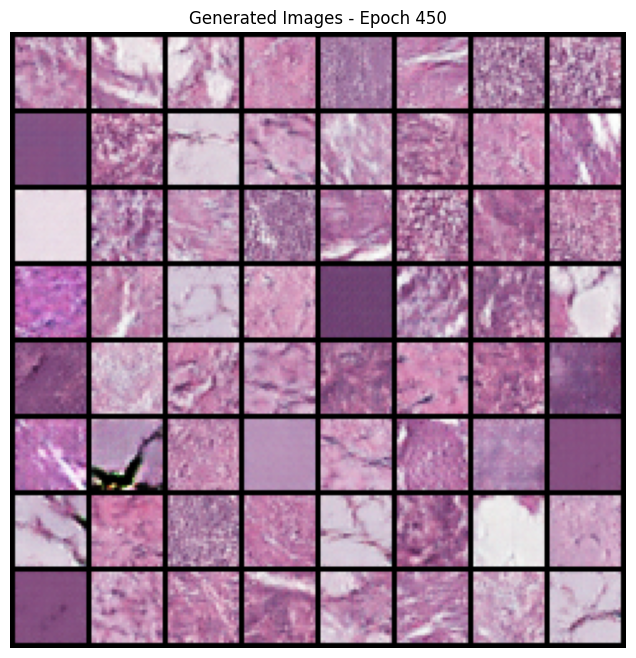

Saved and displayed generated samples at epoch 450
 Saved checkpoint at epoch 450


Epoch 451/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.389, g_loss=2.214]


[Epoch 451] D_loss=0.3497 | G_loss=2.5580


Epoch 452/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.364, g_loss=2.452]


[Epoch 452] D_loss=0.3395 | G_loss=2.5511


Epoch 453/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.271, g_loss=2.523]


[Epoch 453] D_loss=0.3121 | G_loss=2.4839


Epoch 454/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.395, g_loss=2.996]


[Epoch 454] D_loss=0.3883 | G_loss=2.4917


Epoch 455/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.457, g_loss=2.421]


[Epoch 455] D_loss=0.3334 | G_loss=2.5693


Epoch 456/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.316, g_loss=2.663]


[Epoch 456] D_loss=0.3149 | G_loss=2.4534


Epoch 457/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.451, g_loss=2.442]


[Epoch 457] D_loss=0.3705 | G_loss=2.4090


Epoch 458/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.315, g_loss=2.795]


[Epoch 458] D_loss=0.4052 | G_loss=2.6488


Epoch 459/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.301, g_loss=2.910]


[Epoch 459] D_loss=0.3392 | G_loss=2.4982


Epoch 460/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.392, g_loss=2.444]


[Epoch 460] D_loss=0.3270 | G_loss=2.5252


Epoch 461/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.169, g_loss=3.353]


[Epoch 461] D_loss=0.2739 | G_loss=2.7795


Epoch 462/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.264, g_loss=2.754]


[Epoch 462] D_loss=0.2939 | G_loss=2.6868


Epoch 463/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.202, g_loss=3.298]


[Epoch 463] D_loss=0.3929 | G_loss=2.9325


Epoch 464/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.391, g_loss=2.512]


[Epoch 464] D_loss=0.3381 | G_loss=2.4811


Epoch 465/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.224, g_loss=2.668]


[Epoch 465] D_loss=0.2980 | G_loss=2.6711


Epoch 466/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.664, g_loss=1.736]


[Epoch 466] D_loss=0.3647 | G_loss=2.3685


Epoch 467/1200: 100%|██████████| 6/6 [00:11<00:00,  1.95s/it, d_loss=0.310, g_loss=2.535]


[Epoch 467] D_loss=0.2826 | G_loss=2.6972


Epoch 468/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.299, g_loss=3.038]


[Epoch 468] D_loss=0.3133 | G_loss=2.6032


Epoch 469/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.376, g_loss=3.298]


[Epoch 469] D_loss=0.3494 | G_loss=2.6923


Epoch 470/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.362, g_loss=2.591]


[Epoch 470] D_loss=0.5054 | G_loss=2.5644


Epoch 471/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.467, g_loss=2.408]


[Epoch 471] D_loss=0.3639 | G_loss=2.5948


Epoch 472/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.403, g_loss=2.724]


[Epoch 472] D_loss=0.5059 | G_loss=2.5163


Epoch 473/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.344, g_loss=3.001]


[Epoch 473] D_loss=0.3380 | G_loss=2.7226


Epoch 474/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.284, g_loss=2.361]


[Epoch 474] D_loss=0.2991 | G_loss=2.4956


Epoch 475/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.600, g_loss=1.884]


[Epoch 475] D_loss=0.4771 | G_loss=2.4567


Epoch 476/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.428, g_loss=2.405]


[Epoch 476] D_loss=0.3299 | G_loss=2.5302


Epoch 477/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.323, g_loss=2.423]


[Epoch 477] D_loss=0.2805 | G_loss=2.5201


Epoch 478/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.537, g_loss=3.103]


[Epoch 478] D_loss=0.3750 | G_loss=2.7544


Epoch 479/1200: 100%|██████████| 6/6 [00:11<00:00,  1.94s/it, d_loss=0.394, g_loss=2.399]


[Epoch 479] D_loss=0.3496 | G_loss=2.6019


Epoch 480/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.307, g_loss=2.878]


[Epoch 480] D_loss=0.3035 | G_loss=2.6183


Epoch 481/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.480, g_loss=2.867]


[Epoch 481] D_loss=0.3074 | G_loss=2.6558


Epoch 482/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.238, g_loss=2.831]


[Epoch 482] D_loss=0.3063 | G_loss=2.6732


Epoch 483/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.223, g_loss=2.698]


[Epoch 483] D_loss=0.2492 | G_loss=2.6493


Epoch 484/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.259, g_loss=2.589]


[Epoch 484] D_loss=0.2734 | G_loss=2.5874


Epoch 485/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.449, g_loss=2.076]


[Epoch 485] D_loss=0.3101 | G_loss=2.6940


Epoch 486/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.545, g_loss=3.779]


[Epoch 486] D_loss=0.3925 | G_loss=2.7798


Epoch 487/1200: 100%|██████████| 6/6 [00:11<00:00,  1.84s/it, d_loss=0.366, g_loss=2.522]


[Epoch 487] D_loss=0.3716 | G_loss=2.6490


Epoch 488/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.343, g_loss=2.687]


[Epoch 488] D_loss=0.3511 | G_loss=2.7303


Epoch 489/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.536, g_loss=2.688]


[Epoch 489] D_loss=0.3327 | G_loss=2.5621


Epoch 490/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.298, g_loss=2.913]


[Epoch 490] D_loss=0.4591 | G_loss=2.7160


Epoch 491/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.527, g_loss=2.234]


[Epoch 491] D_loss=0.3573 | G_loss=2.7075


Epoch 492/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.829, g_loss=3.894]


[Epoch 492] D_loss=0.5857 | G_loss=3.0197


Epoch 493/1200: 100%|██████████| 6/6 [00:11<00:00,  1.94s/it, d_loss=1.917, g_loss=2.457]


[Epoch 493] D_loss=1.0168 | G_loss=2.6654


Epoch 494/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=1.514, g_loss=1.905]


[Epoch 494] D_loss=2.2120 | G_loss=2.4354


Epoch 495/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=1.624, g_loss=4.054]


[Epoch 495] D_loss=0.9215 | G_loss=2.4610


Epoch 496/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.717, g_loss=2.790]


[Epoch 496] D_loss=0.6974 | G_loss=2.4523


Epoch 497/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.722, g_loss=2.346]


[Epoch 497] D_loss=0.5296 | G_loss=2.2379


Epoch 498/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.455, g_loss=2.422]


[Epoch 498] D_loss=0.4350 | G_loss=2.3469


Epoch 499/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.324, g_loss=2.484]


[Epoch 499] D_loss=0.3326 | G_loss=2.4728


Epoch 500/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.243, g_loss=2.994]


[Epoch 500] D_loss=0.3321 | G_loss=2.5324


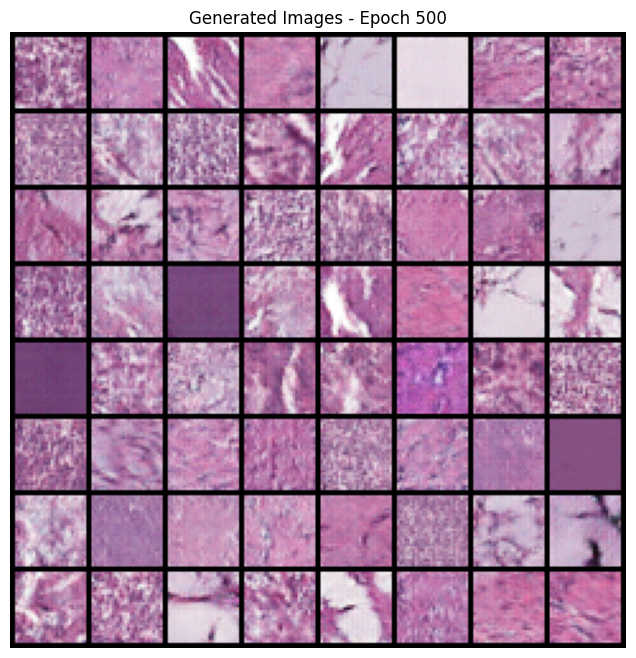

Saved and displayed generated samples at epoch 500
 Saved checkpoint at epoch 500


Epoch 501/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.308, g_loss=2.524]


[Epoch 501] D_loss=0.3203 | G_loss=2.4851


Epoch 502/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.181, g_loss=2.801]


[Epoch 502] D_loss=0.2764 | G_loss=2.6678


Epoch 503/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.338, g_loss=2.709]


[Epoch 503] D_loss=0.2898 | G_loss=2.5926


Epoch 504/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.290, g_loss=2.884]


[Epoch 504] D_loss=0.3113 | G_loss=2.6095


Epoch 505/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.339, g_loss=2.574]


[Epoch 505] D_loss=0.2877 | G_loss=2.6391


Epoch 506/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.277, g_loss=2.302]


[Epoch 506] D_loss=0.3450 | G_loss=2.4496


Epoch 507/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.214, g_loss=2.713]


[Epoch 507] D_loss=0.2843 | G_loss=2.7465


Epoch 508/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.372, g_loss=2.391]


[Epoch 508] D_loss=0.2574 | G_loss=2.6875


Epoch 509/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.264, g_loss=2.961]


[Epoch 509] D_loss=0.3426 | G_loss=2.6865


Epoch 510/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.378, g_loss=2.345]


[Epoch 510] D_loss=0.2934 | G_loss=2.5898


Epoch 511/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.269, g_loss=2.966]


[Epoch 511] D_loss=0.2417 | G_loss=2.7404


Epoch 512/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.116, g_loss=3.353]


[Epoch 512] D_loss=0.2403 | G_loss=2.7704


Epoch 513/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.371, g_loss=2.427]


[Epoch 513] D_loss=0.4099 | G_loss=2.7545


Epoch 514/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.316, g_loss=2.433]


[Epoch 514] D_loss=0.2920 | G_loss=2.7273


Epoch 515/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.269, g_loss=3.265]


[Epoch 515] D_loss=0.3233 | G_loss=2.8839


Epoch 516/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.218, g_loss=2.786]


[Epoch 516] D_loss=0.3321 | G_loss=2.5697


Epoch 517/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.293, g_loss=2.817]


[Epoch 517] D_loss=0.3347 | G_loss=2.6901


Epoch 518/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.201, g_loss=3.201]


[Epoch 518] D_loss=0.2508 | G_loss=2.7491


Epoch 519/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.460, g_loss=3.009]


[Epoch 519] D_loss=0.3195 | G_loss=2.6214


Epoch 520/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.621, g_loss=1.771]


[Epoch 520] D_loss=0.5067 | G_loss=2.3401


Epoch 521/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.223, g_loss=2.706]


[Epoch 521] D_loss=0.3250 | G_loss=2.5669


Epoch 522/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.243, g_loss=2.639]


[Epoch 522] D_loss=0.2318 | G_loss=2.8081


Epoch 523/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.144, g_loss=3.099]


[Epoch 523] D_loss=0.2296 | G_loss=2.7480


Epoch 524/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.255, g_loss=2.759]


[Epoch 524] D_loss=0.2653 | G_loss=2.7090


Epoch 525/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.295, g_loss=2.499]


[Epoch 525] D_loss=0.3407 | G_loss=2.6320


Epoch 526/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.309, g_loss=2.605]


[Epoch 526] D_loss=0.3423 | G_loss=2.7329


Epoch 527/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.489, g_loss=2.058]


[Epoch 527] D_loss=0.2904 | G_loss=2.6570


Epoch 528/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.191, g_loss=2.955]


[Epoch 528] D_loss=0.2969 | G_loss=2.7664


Epoch 529/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.328, g_loss=2.663]


[Epoch 529] D_loss=0.3097 | G_loss=2.5811


Epoch 530/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.293, g_loss=2.450]


[Epoch 530] D_loss=0.2609 | G_loss=2.7916


Epoch 531/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.249, g_loss=3.087]


[Epoch 531] D_loss=0.2684 | G_loss=2.7931


Epoch 532/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.360, g_loss=2.888]


[Epoch 532] D_loss=0.3231 | G_loss=2.7569


Epoch 533/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.199, g_loss=2.902]


[Epoch 533] D_loss=0.2478 | G_loss=2.7325


Epoch 534/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.352, g_loss=2.653]


[Epoch 534] D_loss=0.2846 | G_loss=2.7879


Epoch 535/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.240, g_loss=3.156]


[Epoch 535] D_loss=0.2948 | G_loss=2.7682


Epoch 536/1200: 100%|██████████| 6/6 [00:11<00:00,  1.95s/it, d_loss=0.177, g_loss=2.773]


[Epoch 536] D_loss=0.2913 | G_loss=2.8247


Epoch 537/1200: 100%|██████████| 6/6 [00:11<00:00,  1.94s/it, d_loss=0.180, g_loss=2.901]


[Epoch 537] D_loss=0.2328 | G_loss=2.7758


Epoch 538/1200: 100%|██████████| 6/6 [00:11<00:00,  1.94s/it, d_loss=0.515, g_loss=2.958]


[Epoch 538] D_loss=0.2797 | G_loss=2.7887


Epoch 539/1200: 100%|██████████| 6/6 [00:11<00:00,  1.94s/it, d_loss=0.183, g_loss=2.827]


[Epoch 539] D_loss=0.2993 | G_loss=2.8177


Epoch 540/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.176, g_loss=3.288]


[Epoch 540] D_loss=0.2589 | G_loss=2.8298


Epoch 541/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.333, g_loss=2.464]


[Epoch 541] D_loss=0.2323 | G_loss=2.7997


Epoch 542/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.408, g_loss=3.470]


[Epoch 542] D_loss=0.2708 | G_loss=2.9895


Epoch 543/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.292, g_loss=2.726]


[Epoch 543] D_loss=0.3214 | G_loss=2.7716


Epoch 544/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.154, g_loss=3.080]


[Epoch 544] D_loss=0.2371 | G_loss=2.8137


Epoch 545/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.325, g_loss=2.800]


[Epoch 545] D_loss=0.3232 | G_loss=2.6893


Epoch 546/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.190, g_loss=3.259]


[Epoch 546] D_loss=0.3277 | G_loss=2.9207


Epoch 547/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.316, g_loss=2.374]


[Epoch 547] D_loss=0.2775 | G_loss=3.0041


Epoch 548/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.292, g_loss=2.371]


[Epoch 548] D_loss=0.2569 | G_loss=2.7147


Epoch 549/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.220, g_loss=3.141]


[Epoch 549] D_loss=0.2684 | G_loss=2.7866


Epoch 550/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.321, g_loss=2.793]


[Epoch 550] D_loss=0.2877 | G_loss=2.8802


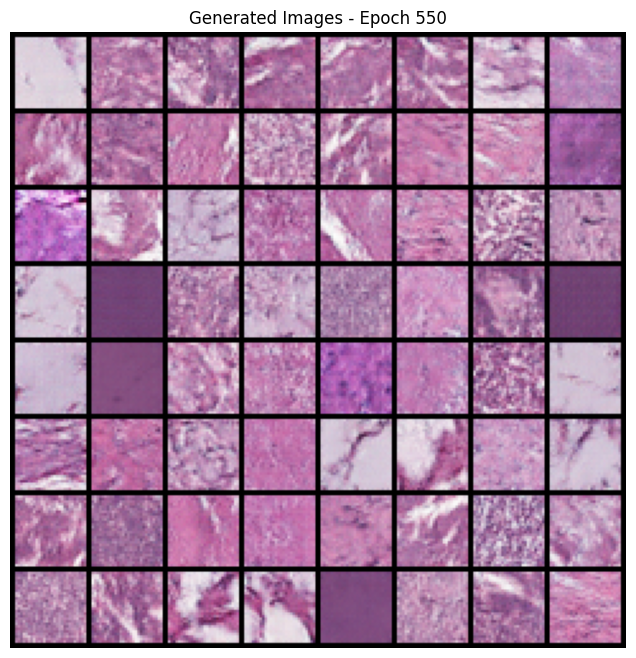

Saved and displayed generated samples at epoch 550
 Saved checkpoint at epoch 550


Epoch 551/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.262, g_loss=3.127]


[Epoch 551] D_loss=0.2576 | G_loss=2.8113


Epoch 552/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.145, g_loss=3.043]


[Epoch 552] D_loss=0.1954 | G_loss=3.0579


Epoch 553/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.326, g_loss=3.005]


[Epoch 553] D_loss=0.2741 | G_loss=2.9252


Epoch 554/1200: 100%|██████████| 6/6 [00:11<00:00,  1.97s/it, d_loss=0.311, g_loss=3.569]


[Epoch 554] D_loss=0.3728 | G_loss=2.9524


Epoch 555/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.273, g_loss=3.827]


[Epoch 555] D_loss=0.4715 | G_loss=3.0887


Epoch 556/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.362, g_loss=2.962]


[Epoch 556] D_loss=0.5055 | G_loss=2.7856


Epoch 557/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.530, g_loss=2.235]


[Epoch 557] D_loss=0.3801 | G_loss=2.6575


Epoch 558/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.319, g_loss=2.821]


[Epoch 558] D_loss=0.3506 | G_loss=2.7946


Epoch 559/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.203, g_loss=3.345]


[Epoch 559] D_loss=0.2250 | G_loss=2.9715


Epoch 560/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.230, g_loss=3.536]


[Epoch 560] D_loss=0.2985 | G_loss=2.7617


Epoch 561/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.391, g_loss=2.631]


[Epoch 561] D_loss=0.2773 | G_loss=2.8221


Epoch 562/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.245, g_loss=2.515]


[Epoch 562] D_loss=0.3528 | G_loss=2.8395


Epoch 563/1200: 100%|██████████| 6/6 [00:11<00:00,  1.94s/it, d_loss=0.230, g_loss=3.069]


[Epoch 563] D_loss=0.2412 | G_loss=2.9383


Epoch 564/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.227, g_loss=3.065]


[Epoch 564] D_loss=0.3401 | G_loss=2.9764


Epoch 565/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.458, g_loss=3.597]


[Epoch 565] D_loss=0.3323 | G_loss=3.0686


Epoch 566/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.785, g_loss=1.922]


[Epoch 566] D_loss=0.4550 | G_loss=2.6403


Epoch 567/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=2.270, g_loss=1.979]


[Epoch 567] D_loss=1.2563 | G_loss=3.0183


Epoch 568/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.659, g_loss=2.623]


[Epoch 568] D_loss=0.9170 | G_loss=2.5429


Epoch 569/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=1.378, g_loss=2.749]


[Epoch 569] D_loss=0.9142 | G_loss=2.6410


Epoch 570/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.868, g_loss=2.505]


[Epoch 570] D_loss=1.1104 | G_loss=2.7169


Epoch 571/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.346, g_loss=2.236]


[Epoch 571] D_loss=0.4453 | G_loss=2.3912


Epoch 572/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.535, g_loss=1.631]


[Epoch 572] D_loss=0.3516 | G_loss=2.5555


Epoch 573/1200: 100%|██████████| 6/6 [00:11<00:00,  1.94s/it, d_loss=0.747, g_loss=1.336]


[Epoch 573] D_loss=0.4469 | G_loss=2.6153


Epoch 574/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.528, g_loss=3.254]


[Epoch 574] D_loss=0.5065 | G_loss=2.7531


Epoch 575/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.426, g_loss=2.603]


[Epoch 575] D_loss=0.3735 | G_loss=2.7057


Epoch 576/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.191, g_loss=3.286]


[Epoch 576] D_loss=0.3203 | G_loss=2.6190


Epoch 577/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.257, g_loss=2.947]


[Epoch 577] D_loss=0.2759 | G_loss=2.7967


Epoch 578/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.166, g_loss=3.316]


[Epoch 578] D_loss=0.2957 | G_loss=2.6114


Epoch 579/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.450, g_loss=3.045]


[Epoch 579] D_loss=0.2871 | G_loss=2.8120


Epoch 580/1200: 100%|██████████| 6/6 [00:11<00:00,  1.94s/it, d_loss=0.214, g_loss=2.974]


[Epoch 580] D_loss=0.3402 | G_loss=2.6509


Epoch 581/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.289, g_loss=2.750]


[Epoch 581] D_loss=0.2888 | G_loss=2.6943


Epoch 582/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.233, g_loss=3.052]


[Epoch 582] D_loss=0.2508 | G_loss=2.7256


Epoch 583/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.236, g_loss=2.721]


[Epoch 583] D_loss=0.2424 | G_loss=2.7957


Epoch 584/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.206, g_loss=3.573]


[Epoch 584] D_loss=0.2823 | G_loss=2.8867


Epoch 585/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.373, g_loss=2.263]


[Epoch 585] D_loss=0.3015 | G_loss=2.8217


Epoch 586/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.166, g_loss=2.958]


[Epoch 586] D_loss=0.2356 | G_loss=2.9866


Epoch 587/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.240, g_loss=2.687]


[Epoch 587] D_loss=0.2558 | G_loss=2.9360


Epoch 588/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.209, g_loss=2.970]


[Epoch 588] D_loss=0.2867 | G_loss=2.8264


Epoch 589/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.159, g_loss=3.119]


[Epoch 589] D_loss=0.2288 | G_loss=2.9676


Epoch 590/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.213, g_loss=2.929]


[Epoch 590] D_loss=0.2099 | G_loss=2.9788


Epoch 591/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.198, g_loss=3.192]


[Epoch 591] D_loss=0.2897 | G_loss=2.9019


Epoch 592/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=1.023, g_loss=2.055]


[Epoch 592] D_loss=0.3484 | G_loss=2.8941


Epoch 593/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=1.671, g_loss=2.249]


[Epoch 593] D_loss=1.8027 | G_loss=2.7787


Epoch 594/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=2.293, g_loss=2.503]


[Epoch 594] D_loss=2.1918 | G_loss=2.2453


Epoch 595/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=1.065, g_loss=1.963]


[Epoch 595] D_loss=1.5509 | G_loss=1.8455


Epoch 596/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.801, g_loss=2.528]


[Epoch 596] D_loss=1.0168 | G_loss=2.1458


Epoch 597/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.645, g_loss=2.073]


[Epoch 597] D_loss=0.6996 | G_loss=2.0996


Epoch 598/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.554, g_loss=2.868]


[Epoch 598] D_loss=0.5450 | G_loss=2.2303


Epoch 599/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.462, g_loss=2.211]


[Epoch 599] D_loss=0.5575 | G_loss=2.4594


Epoch 600/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.314, g_loss=2.697]


[Epoch 600] D_loss=0.4003 | G_loss=2.4183


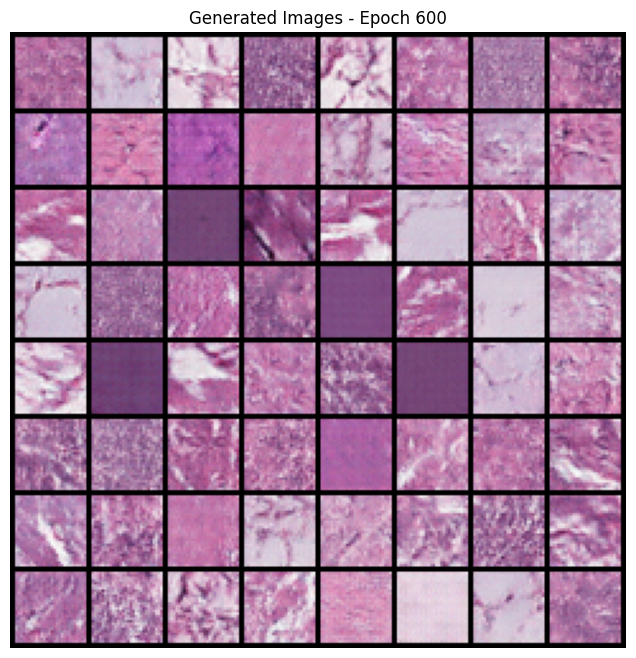

Saved and displayed generated samples at epoch 600
 Saved checkpoint at epoch 600


Epoch 601/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.479, g_loss=2.461]


[Epoch 601] D_loss=0.3773 | G_loss=2.6123


Epoch 602/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.479, g_loss=2.665]


[Epoch 602] D_loss=0.4230 | G_loss=2.4403


Epoch 603/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.428, g_loss=2.588]


[Epoch 603] D_loss=0.4203 | G_loss=2.6119


Epoch 604/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.266, g_loss=3.207]


[Epoch 604] D_loss=0.3461 | G_loss=2.7108


Epoch 605/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.248, g_loss=3.270]


[Epoch 605] D_loss=0.3781 | G_loss=2.5928


Epoch 606/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.305, g_loss=2.265]


[Epoch 606] D_loss=0.3040 | G_loss=2.7016


Epoch 607/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.324, g_loss=2.762]


[Epoch 607] D_loss=0.3236 | G_loss=2.7483


Epoch 608/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.421, g_loss=3.050]


[Epoch 608] D_loss=0.3850 | G_loss=2.6421


Epoch 609/1200: 100%|██████████| 6/6 [00:11<00:00,  1.96s/it, d_loss=0.257, g_loss=2.760]


[Epoch 609] D_loss=0.3215 | G_loss=2.6700


Epoch 610/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.308, g_loss=2.795]


[Epoch 610] D_loss=0.2918 | G_loss=2.7315


Epoch 611/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.265, g_loss=2.538]


[Epoch 611] D_loss=0.3425 | G_loss=2.7252


Epoch 612/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.363, g_loss=3.183]


[Epoch 612] D_loss=0.3584 | G_loss=2.8509


Epoch 613/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.168, g_loss=2.830]


[Epoch 613] D_loss=0.2381 | G_loss=2.8379


Epoch 614/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.242, g_loss=2.928]


[Epoch 614] D_loss=0.2501 | G_loss=2.9462


Epoch 615/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.345, g_loss=2.326]


[Epoch 615] D_loss=0.2713 | G_loss=2.7864


Epoch 616/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.447, g_loss=3.436]


[Epoch 616] D_loss=0.4982 | G_loss=2.9431


Epoch 617/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.256, g_loss=3.129]


[Epoch 617] D_loss=0.4282 | G_loss=2.6229


Epoch 618/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.209, g_loss=3.026]


[Epoch 618] D_loss=0.2888 | G_loss=3.0745


Epoch 619/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.477, g_loss=1.931]


[Epoch 619] D_loss=0.2934 | G_loss=2.8259


Epoch 620/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.329, g_loss=2.827]


[Epoch 620] D_loss=0.3430 | G_loss=2.9303


Epoch 621/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.603, g_loss=2.411]


[Epoch 621] D_loss=0.3085 | G_loss=2.8623


Epoch 622/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.288, g_loss=2.650]


[Epoch 622] D_loss=0.2882 | G_loss=2.7999


Epoch 623/1200: 100%|██████████| 6/6 [00:11<00:00,  1.96s/it, d_loss=0.127, g_loss=3.354]


[Epoch 623] D_loss=0.2065 | G_loss=2.9276


Epoch 624/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.391, g_loss=3.220]


[Epoch 624] D_loss=0.3120 | G_loss=3.0610


Epoch 625/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.298, g_loss=2.758]


[Epoch 625] D_loss=0.2890 | G_loss=2.8857


Epoch 626/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.482, g_loss=2.488]


[Epoch 626] D_loss=0.3035 | G_loss=2.8101


Epoch 627/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.294, g_loss=3.157]


[Epoch 627] D_loss=0.3174 | G_loss=2.9352


Epoch 628/1200: 100%|██████████| 6/6 [00:11<00:00,  1.94s/it, d_loss=0.164, g_loss=3.468]


[Epoch 628] D_loss=0.2140 | G_loss=2.9723


Epoch 629/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.152, g_loss=3.011]


[Epoch 629] D_loss=0.1721 | G_loss=3.1374


Epoch 630/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.359, g_loss=2.616]


[Epoch 630] D_loss=0.1888 | G_loss=3.1006


Epoch 631/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.225, g_loss=2.975]


[Epoch 631] D_loss=0.2301 | G_loss=3.0464


Epoch 632/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.294, g_loss=2.961]


[Epoch 632] D_loss=0.2959 | G_loss=3.1251


Epoch 633/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.263, g_loss=3.332]


[Epoch 633] D_loss=0.2446 | G_loss=3.0046


Epoch 634/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.441, g_loss=2.720]


[Epoch 634] D_loss=0.2444 | G_loss=2.9230


Epoch 635/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.308, g_loss=2.540]


[Epoch 635] D_loss=0.2336 | G_loss=2.8811


Epoch 636/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.154, g_loss=3.293]


[Epoch 636] D_loss=0.2432 | G_loss=3.0775


Epoch 637/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.210, g_loss=2.954]


[Epoch 637] D_loss=0.2050 | G_loss=3.1223


Epoch 638/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.290, g_loss=3.046]


[Epoch 638] D_loss=0.2450 | G_loss=3.0249


Epoch 639/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.237, g_loss=2.758]


[Epoch 639] D_loss=0.2294 | G_loss=3.0199


Epoch 640/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.792, g_loss=2.808]


[Epoch 640] D_loss=0.4563 | G_loss=3.1094


Epoch 641/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=1.817, g_loss=2.418]


[Epoch 641] D_loss=0.9989 | G_loss=2.8141


Epoch 642/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.542, g_loss=3.497]


[Epoch 642] D_loss=1.0825 | G_loss=2.9667


Epoch 643/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=1.548, g_loss=4.186]


[Epoch 643] D_loss=0.6676 | G_loss=2.9538


Epoch 644/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.353, g_loss=2.760]


[Epoch 644] D_loss=0.5407 | G_loss=2.8297


Epoch 645/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.258, g_loss=2.861]


[Epoch 645] D_loss=0.3392 | G_loss=2.6953


Epoch 646/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.326, g_loss=2.636]


[Epoch 646] D_loss=0.2335 | G_loss=2.8343


Epoch 647/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.478, g_loss=2.431]


[Epoch 647] D_loss=0.2870 | G_loss=2.7013


Epoch 648/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.371, g_loss=2.341]


[Epoch 648] D_loss=0.2724 | G_loss=2.7869


Epoch 649/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.221, g_loss=3.328]


[Epoch 649] D_loss=0.2150 | G_loss=3.0168


Epoch 650/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.154, g_loss=3.107]


[Epoch 650] D_loss=0.1904 | G_loss=3.0382


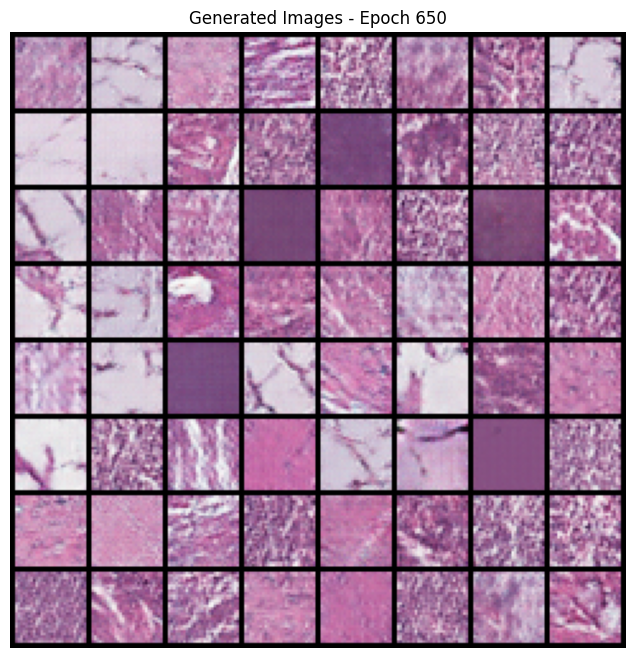

Saved and displayed generated samples at epoch 650
 Saved checkpoint at epoch 650


Epoch 651/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.194, g_loss=3.336]


[Epoch 651] D_loss=0.2647 | G_loss=3.0972


Epoch 652/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.273, g_loss=2.804]


[Epoch 652] D_loss=0.2161 | G_loss=3.0841


Epoch 653/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.137, g_loss=2.960]


[Epoch 653] D_loss=0.2025 | G_loss=3.0719


Epoch 654/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.156, g_loss=3.427]


[Epoch 654] D_loss=0.2061 | G_loss=3.1415


Epoch 655/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.407, g_loss=2.644]


[Epoch 655] D_loss=0.2687 | G_loss=2.9184


Epoch 656/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.182, g_loss=3.173]


[Epoch 656] D_loss=0.2591 | G_loss=3.1347


Epoch 657/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.210, g_loss=3.040]


[Epoch 657] D_loss=0.2271 | G_loss=2.9180


Epoch 658/1200: 100%|██████████| 6/6 [00:11<00:00,  1.95s/it, d_loss=0.591, g_loss=2.926]


[Epoch 658] D_loss=0.2784 | G_loss=2.9717


Epoch 659/1200: 100%|██████████| 6/6 [00:11<00:00,  1.98s/it, d_loss=0.221, g_loss=3.004]


[Epoch 659] D_loss=0.3751 | G_loss=3.0361


Epoch 660/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.162, g_loss=3.004]


[Epoch 660] D_loss=0.2711 | G_loss=3.0178


Epoch 661/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.585, g_loss=1.551]


[Epoch 661] D_loss=0.3034 | G_loss=2.7607


Epoch 662/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.623, g_loss=2.796]


[Epoch 662] D_loss=0.5221 | G_loss=2.9235


Epoch 663/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.281, g_loss=2.699]


[Epoch 663] D_loss=0.3280 | G_loss=2.8992


Epoch 664/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.380, g_loss=3.345]


[Epoch 664] D_loss=0.2458 | G_loss=3.1287


Epoch 665/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.284, g_loss=3.176]


[Epoch 665] D_loss=0.2616 | G_loss=2.8873


Epoch 666/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.368, g_loss=2.372]


[Epoch 666] D_loss=0.2342 | G_loss=2.9947


Epoch 667/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.404, g_loss=2.407]


[Epoch 667] D_loss=0.2837 | G_loss=2.8647


Epoch 668/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.197, g_loss=3.145]


[Epoch 668] D_loss=0.2514 | G_loss=3.0114


Epoch 669/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.389, g_loss=2.822]


[Epoch 669] D_loss=0.2516 | G_loss=2.9519


Epoch 670/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.108, g_loss=3.586]


[Epoch 670] D_loss=0.1864 | G_loss=3.1401


Epoch 671/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.259, g_loss=2.878]


[Epoch 671] D_loss=0.1957 | G_loss=3.0438


Epoch 672/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.356, g_loss=3.071]


[Epoch 672] D_loss=0.2551 | G_loss=3.0732


Epoch 673/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.291, g_loss=3.824]


[Epoch 673] D_loss=0.3140 | G_loss=3.1317


Epoch 674/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.117, g_loss=3.608]


[Epoch 674] D_loss=0.2403 | G_loss=3.0951


Epoch 675/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.851, g_loss=1.927]


[Epoch 675] D_loss=0.3350 | G_loss=3.0915


Epoch 676/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.459, g_loss=2.943]


[Epoch 676] D_loss=0.4797 | G_loss=2.9705


Epoch 677/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.196, g_loss=3.185]


[Epoch 677] D_loss=0.2378 | G_loss=2.9586


Epoch 678/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.126, g_loss=3.113]


[Epoch 678] D_loss=0.1763 | G_loss=3.1520


Epoch 679/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.383, g_loss=3.030]


[Epoch 679] D_loss=0.2724 | G_loss=3.3040


Epoch 680/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.224, g_loss=2.999]


[Epoch 680] D_loss=0.2395 | G_loss=3.2567


Epoch 681/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.253, g_loss=2.815]


[Epoch 681] D_loss=0.2422 | G_loss=3.1298


Epoch 682/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.174, g_loss=3.202]


[Epoch 682] D_loss=0.2080 | G_loss=3.0400


Epoch 683/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.129, g_loss=3.339]


[Epoch 683] D_loss=0.2627 | G_loss=3.0263


Epoch 684/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.237, g_loss=3.632]


[Epoch 684] D_loss=0.2333 | G_loss=3.2215


Epoch 685/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.214, g_loss=2.835]


[Epoch 685] D_loss=0.2388 | G_loss=3.1175


Epoch 686/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.108, g_loss=3.798]


[Epoch 686] D_loss=0.1995 | G_loss=3.0479


Epoch 687/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.220, g_loss=4.045]


[Epoch 687] D_loss=0.2084 | G_loss=3.2664


Epoch 688/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.236, g_loss=3.120]


[Epoch 688] D_loss=0.2923 | G_loss=2.8774


Epoch 689/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.349, g_loss=2.574]


[Epoch 689] D_loss=0.2195 | G_loss=3.1431


Epoch 690/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.380, g_loss=2.163]


[Epoch 690] D_loss=0.2499 | G_loss=3.1061


Epoch 691/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.499, g_loss=3.329]


[Epoch 691] D_loss=0.2860 | G_loss=3.2287


Epoch 692/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.269, g_loss=2.995]


[Epoch 692] D_loss=0.3228 | G_loss=3.1400


Epoch 693/1200: 100%|██████████| 6/6 [00:11<00:00,  1.94s/it, d_loss=0.248, g_loss=3.043]


[Epoch 693] D_loss=0.2153 | G_loss=3.1678


Epoch 694/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.143, g_loss=3.527]


[Epoch 694] D_loss=0.1985 | G_loss=3.3051


Epoch 695/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.239, g_loss=3.783]


[Epoch 695] D_loss=0.2310 | G_loss=3.1731


Epoch 696/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.309, g_loss=2.658]


[Epoch 696] D_loss=0.2287 | G_loss=3.0298


Epoch 697/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.734, g_loss=2.141]


[Epoch 697] D_loss=0.4537 | G_loss=3.1808


Epoch 698/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.630, g_loss=4.054]


[Epoch 698] D_loss=0.4721 | G_loss=3.0818


Epoch 699/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.186, g_loss=3.088]


[Epoch 699] D_loss=0.2463 | G_loss=3.0361


Epoch 700/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.175, g_loss=3.026]


[Epoch 700] D_loss=0.2011 | G_loss=3.1675


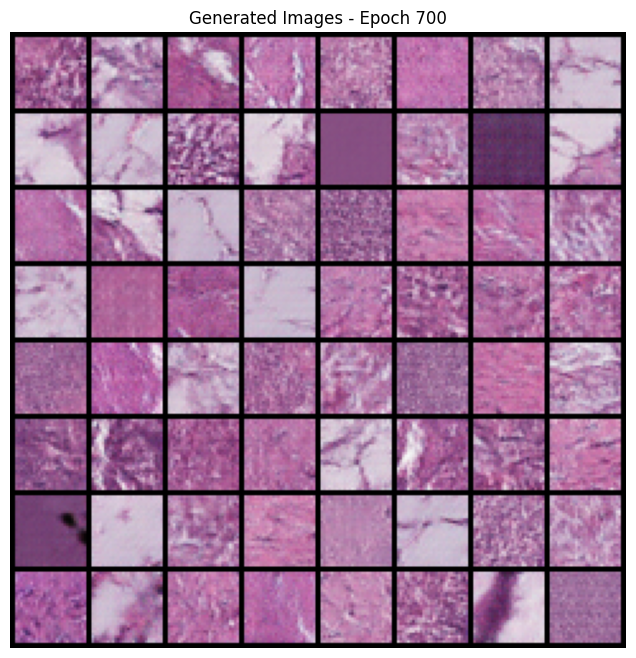

Saved and displayed generated samples at epoch 700
 Saved checkpoint at epoch 700


Epoch 701/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.404, g_loss=3.518]


[Epoch 701] D_loss=0.2543 | G_loss=3.1385


Epoch 702/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.134, g_loss=3.686]


[Epoch 702] D_loss=0.2126 | G_loss=3.3493


Epoch 703/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.402, g_loss=2.628]


[Epoch 703] D_loss=0.1952 | G_loss=3.1535


Epoch 704/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.425, g_loss=2.590]


[Epoch 704] D_loss=0.3940 | G_loss=3.2090


Epoch 705/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.539, g_loss=2.281]


[Epoch 705] D_loss=0.3298 | G_loss=2.8808


Epoch 706/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.189, g_loss=3.697]


[Epoch 706] D_loss=0.4228 | G_loss=3.2943


Epoch 707/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.264, g_loss=3.076]


[Epoch 707] D_loss=0.2141 | G_loss=3.1243


Epoch 708/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.269, g_loss=2.781]


[Epoch 708] D_loss=0.2202 | G_loss=3.0516


Epoch 709/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.324, g_loss=2.792]


[Epoch 709] D_loss=0.4684 | G_loss=3.2010


Epoch 710/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.416, g_loss=3.325]


[Epoch 710] D_loss=0.2747 | G_loss=3.0574


Epoch 711/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.237, g_loss=3.410]


[Epoch 711] D_loss=0.2169 | G_loss=3.1256


Epoch 712/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.346, g_loss=3.322]


[Epoch 712] D_loss=0.2204 | G_loss=3.1865


Epoch 713/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.147, g_loss=3.562]


[Epoch 713] D_loss=0.1777 | G_loss=3.3472


Epoch 714/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.166, g_loss=3.440]


[Epoch 714] D_loss=0.1553 | G_loss=3.3053


Epoch 715/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.233, g_loss=3.759]


[Epoch 715] D_loss=0.2332 | G_loss=3.2451


Epoch 716/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.367, g_loss=3.182]


[Epoch 716] D_loss=0.2650 | G_loss=3.1728


Epoch 717/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.173, g_loss=3.000]


[Epoch 717] D_loss=0.2489 | G_loss=3.1430


Epoch 718/1200: 100%|██████████| 6/6 [00:11<00:00,  1.84s/it, d_loss=0.139, g_loss=3.620]


[Epoch 718] D_loss=0.1973 | G_loss=3.0514


Epoch 719/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.235, g_loss=3.317]


[Epoch 719] D_loss=0.2181 | G_loss=3.2706


Epoch 720/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.149, g_loss=3.222]


[Epoch 720] D_loss=0.2002 | G_loss=3.0728


Epoch 721/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.130, g_loss=3.800]


[Epoch 721] D_loss=0.2672 | G_loss=3.3668


Epoch 722/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.242, g_loss=3.981]


[Epoch 722] D_loss=0.2512 | G_loss=3.3589


Epoch 723/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.255, g_loss=2.865]


[Epoch 723] D_loss=0.2634 | G_loss=3.0447


Epoch 724/1200: 100%|██████████| 6/6 [00:11<00:00,  1.98s/it, d_loss=0.387, g_loss=2.606]


[Epoch 724] D_loss=0.2701 | G_loss=3.1926


Epoch 725/1200: 100%|██████████| 6/6 [00:11<00:00,  1.95s/it, d_loss=0.370, g_loss=2.850]


[Epoch 725] D_loss=0.2824 | G_loss=3.3101


Epoch 726/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.496, g_loss=1.947]


[Epoch 726] D_loss=0.2083 | G_loss=3.2217


Epoch 727/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.131, g_loss=3.546]


[Epoch 727] D_loss=0.1891 | G_loss=3.3243


Epoch 728/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.200, g_loss=3.424]


[Epoch 728] D_loss=0.1611 | G_loss=3.3146


Epoch 729/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.550, g_loss=4.742]


[Epoch 729] D_loss=0.3073 | G_loss=3.5598


Epoch 730/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.960, g_loss=3.988]


[Epoch 730] D_loss=0.6735 | G_loss=3.1197


Epoch 731/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=1.111, g_loss=2.489]


[Epoch 731] D_loss=1.1673 | G_loss=2.9518


Epoch 732/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.392, g_loss=3.325]


[Epoch 732] D_loss=0.6097 | G_loss=3.3544


Epoch 733/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.429, g_loss=4.158]


[Epoch 733] D_loss=0.4171 | G_loss=3.1620


Epoch 734/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.698, g_loss=1.941]


[Epoch 734] D_loss=0.4819 | G_loss=2.7184


Epoch 735/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.490, g_loss=2.821]


[Epoch 735] D_loss=0.4912 | G_loss=2.9933


Epoch 736/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.612, g_loss=2.972]


[Epoch 736] D_loss=0.3122 | G_loss=3.0306


Epoch 737/1200: 100%|██████████| 6/6 [00:11<00:00,  1.84s/it, d_loss=0.283, g_loss=3.040]


[Epoch 737] D_loss=0.2507 | G_loss=3.2356


Epoch 738/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.201, g_loss=3.002]


[Epoch 738] D_loss=0.1989 | G_loss=3.2443


Epoch 739/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.306, g_loss=3.310]


[Epoch 739] D_loss=0.2558 | G_loss=3.3649


Epoch 740/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.148, g_loss=4.053]


[Epoch 740] D_loss=0.2421 | G_loss=3.1420


Epoch 741/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.116, g_loss=3.803]


[Epoch 741] D_loss=0.2223 | G_loss=3.1520


Epoch 742/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.192, g_loss=4.104]


[Epoch 742] D_loss=0.2582 | G_loss=3.3825


Epoch 743/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.643, g_loss=3.320]


[Epoch 743] D_loss=0.3405 | G_loss=2.9027


Epoch 744/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.222, g_loss=3.638]


[Epoch 744] D_loss=0.2326 | G_loss=3.2781


Epoch 745/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.288, g_loss=2.636]


[Epoch 745] D_loss=0.2014 | G_loss=3.0988


Epoch 746/1200: 100%|██████████| 6/6 [00:11<00:00,  1.95s/it, d_loss=1.102, g_loss=3.478]


[Epoch 746] D_loss=0.5501 | G_loss=3.2809


Epoch 747/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=3.128, g_loss=3.002]


[Epoch 747] D_loss=1.7614 | G_loss=3.3533


Epoch 748/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.493, g_loss=2.522]


[Epoch 748] D_loss=1.1124 | G_loss=2.6910


Epoch 749/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.337, g_loss=3.255]


[Epoch 749] D_loss=0.6750 | G_loss=2.9408


Epoch 750/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.541, g_loss=2.125]


[Epoch 750] D_loss=0.4208 | G_loss=2.4797


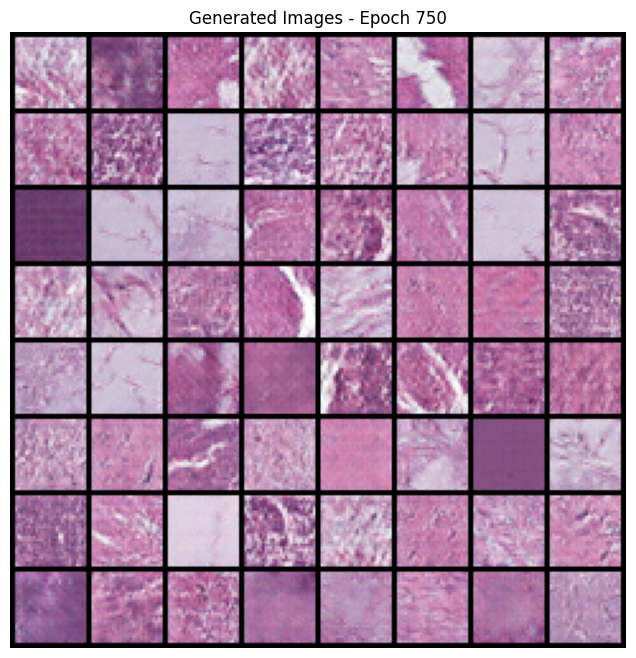

Saved and displayed generated samples at epoch 750
 Saved checkpoint at epoch 750


Epoch 751/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.319, g_loss=4.128]


[Epoch 751] D_loss=0.5929 | G_loss=3.1744


Epoch 752/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.246, g_loss=3.250]


[Epoch 752] D_loss=0.2954 | G_loss=3.1169


Epoch 753/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.317, g_loss=2.859]


[Epoch 753] D_loss=0.2191 | G_loss=2.9213


Epoch 754/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.245, g_loss=2.743]


[Epoch 754] D_loss=0.2202 | G_loss=3.0892


Epoch 755/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.150, g_loss=3.122]


[Epoch 755] D_loss=0.2160 | G_loss=3.2104


Epoch 756/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.129, g_loss=3.634]


[Epoch 756] D_loss=0.2915 | G_loss=3.1218


Epoch 757/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.297, g_loss=3.714]


[Epoch 757] D_loss=0.2675 | G_loss=3.2159


Epoch 758/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.090, g_loss=3.516]


[Epoch 758] D_loss=0.1732 | G_loss=3.3346


Epoch 759/1200: 100%|██████████| 6/6 [00:11<00:00,  1.84s/it, d_loss=0.431, g_loss=2.282]


[Epoch 759] D_loss=0.1872 | G_loss=3.1587


Epoch 760/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.197, g_loss=2.715]


[Epoch 760] D_loss=0.2120 | G_loss=3.2092


Epoch 761/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.721, g_loss=2.250]


[Epoch 761] D_loss=0.2517 | G_loss=3.0769


Epoch 762/1200: 100%|██████████| 6/6 [00:11<00:00,  1.84s/it, d_loss=0.155, g_loss=3.488]


[Epoch 762] D_loss=0.2248 | G_loss=2.9829


Epoch 763/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.363, g_loss=2.793]


[Epoch 763] D_loss=0.2025 | G_loss=3.1118


Epoch 764/1200: 100%|██████████| 6/6 [00:11<00:00,  1.84s/it, d_loss=0.387, g_loss=3.701]


[Epoch 764] D_loss=0.3227 | G_loss=3.0354


Epoch 765/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.487, g_loss=2.377]


[Epoch 765] D_loss=0.3148 | G_loss=2.9946


Epoch 766/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.622, g_loss=1.325]


[Epoch 766] D_loss=0.2905 | G_loss=2.7712


Epoch 767/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.477, g_loss=2.265]


[Epoch 767] D_loss=0.4210 | G_loss=3.1938


Epoch 768/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.177, g_loss=3.096]


[Epoch 768] D_loss=0.2489 | G_loss=3.0347


Epoch 769/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.479, g_loss=4.044]


[Epoch 769] D_loss=0.2687 | G_loss=3.0735


Epoch 770/1200: 100%|██████████| 6/6 [00:11<00:00,  1.94s/it, d_loss=0.174, g_loss=3.049]


[Epoch 770] D_loss=0.2175 | G_loss=3.0732


Epoch 771/1200: 100%|██████████| 6/6 [00:11<00:00,  1.96s/it, d_loss=0.263, g_loss=3.356]


[Epoch 771] D_loss=0.1826 | G_loss=3.2892


Epoch 772/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.308, g_loss=2.755]


[Epoch 772] D_loss=0.2017 | G_loss=3.2000


Epoch 773/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.177, g_loss=3.037]


[Epoch 773] D_loss=0.1699 | G_loss=3.1842


Epoch 774/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.181, g_loss=3.294]


[Epoch 774] D_loss=0.1677 | G_loss=3.2847


Epoch 775/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.135, g_loss=3.457]


[Epoch 775] D_loss=0.1812 | G_loss=3.2484


Epoch 776/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.207, g_loss=2.868]


[Epoch 776] D_loss=0.1750 | G_loss=3.0969


Epoch 777/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.201, g_loss=4.301]


[Epoch 777] D_loss=0.1738 | G_loss=3.3588


Epoch 778/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.344, g_loss=2.376]


[Epoch 778] D_loss=0.2562 | G_loss=3.1480


Epoch 779/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.274, g_loss=3.147]


[Epoch 779] D_loss=0.1977 | G_loss=3.2712


Epoch 780/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.136, g_loss=3.843]


[Epoch 780] D_loss=0.1773 | G_loss=3.2889


Epoch 781/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.326, g_loss=2.585]


[Epoch 781] D_loss=0.1816 | G_loss=3.2824


Epoch 782/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.157, g_loss=3.570]


[Epoch 782] D_loss=0.1562 | G_loss=3.3273


Epoch 783/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.108, g_loss=3.651]


[Epoch 783] D_loss=0.1747 | G_loss=3.1703


Epoch 784/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.160, g_loss=3.213]


[Epoch 784] D_loss=0.1556 | G_loss=3.3755


Epoch 785/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.265, g_loss=2.990]


[Epoch 785] D_loss=0.1762 | G_loss=3.4008


Epoch 786/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.224, g_loss=3.587]


[Epoch 786] D_loss=0.1620 | G_loss=3.4943


Epoch 787/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.122, g_loss=3.900]


[Epoch 787] D_loss=0.1732 | G_loss=3.4301


Epoch 788/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.211, g_loss=3.190]


[Epoch 788] D_loss=0.1835 | G_loss=3.1781


Epoch 789/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.265, g_loss=3.493]


[Epoch 789] D_loss=0.1705 | G_loss=3.3361


Epoch 790/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.093, g_loss=3.625]


[Epoch 790] D_loss=0.1709 | G_loss=3.3572


Epoch 791/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.345, g_loss=3.199]


[Epoch 791] D_loss=0.1778 | G_loss=3.3927


Epoch 792/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.333, g_loss=3.559]


[Epoch 792] D_loss=0.1691 | G_loss=3.4552


Epoch 793/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.258, g_loss=2.666]


[Epoch 793] D_loss=0.1566 | G_loss=3.2685


Epoch 794/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.882, g_loss=1.871]


[Epoch 794] D_loss=0.2885 | G_loss=3.2854


Epoch 795/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=1.512, g_loss=2.833]


[Epoch 795] D_loss=1.8891 | G_loss=3.1388


Epoch 796/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=1.276, g_loss=2.347]


[Epoch 796] D_loss=1.4831 | G_loss=2.3414


Epoch 797/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=1.074, g_loss=2.300]


[Epoch 797] D_loss=0.7635 | G_loss=2.4065


Epoch 798/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.353, g_loss=3.263]


[Epoch 798] D_loss=0.3902 | G_loss=2.7813


Epoch 799/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.209, g_loss=3.018]


[Epoch 799] D_loss=0.2887 | G_loss=2.9045


Epoch 800/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.226, g_loss=2.674]


[Epoch 800] D_loss=0.2881 | G_loss=3.0115


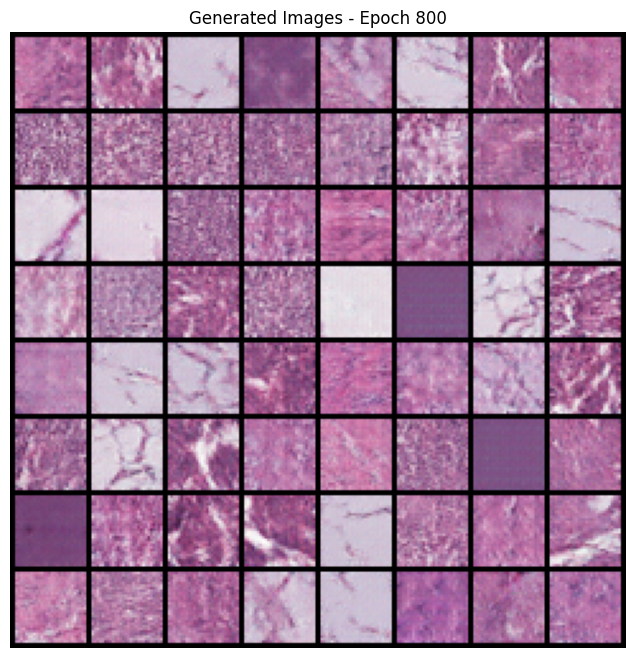

Saved and displayed generated samples at epoch 800
 Saved checkpoint at epoch 800


Epoch 801/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.515, g_loss=2.072]


[Epoch 801] D_loss=0.3260 | G_loss=2.7858


Epoch 802/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.224, g_loss=3.629]


[Epoch 802] D_loss=0.2697 | G_loss=3.1540


Epoch 803/1200: 100%|██████████| 6/6 [00:11<00:00,  1.95s/it, d_loss=0.466, g_loss=2.572]


[Epoch 803] D_loss=0.2525 | G_loss=2.9118


Epoch 804/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.287, g_loss=2.733]


[Epoch 804] D_loss=0.2798 | G_loss=3.0183


Epoch 805/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.347, g_loss=2.786]


[Epoch 805] D_loss=0.2510 | G_loss=3.1328


Epoch 806/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.570, g_loss=4.160]


[Epoch 806] D_loss=0.2519 | G_loss=3.2680


Epoch 807/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.283, g_loss=3.477]


[Epoch 807] D_loss=0.2360 | G_loss=3.4286


Epoch 808/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.192, g_loss=3.322]


[Epoch 808] D_loss=0.1581 | G_loss=3.4079


Epoch 809/1200: 100%|██████████| 6/6 [00:11<00:00,  1.94s/it, d_loss=0.708, g_loss=3.618]


[Epoch 809] D_loss=0.2548 | G_loss=3.5933


Epoch 810/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.232, g_loss=3.216]


[Epoch 810] D_loss=0.4939 | G_loss=3.0565


Epoch 811/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.141, g_loss=3.068]


[Epoch 811] D_loss=0.2812 | G_loss=3.0187


Epoch 812/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.373, g_loss=3.363]


[Epoch 812] D_loss=0.2601 | G_loss=3.0773


Epoch 813/1200: 100%|██████████| 6/6 [00:11<00:00,  1.97s/it, d_loss=0.093, g_loss=3.494]


[Epoch 813] D_loss=0.2141 | G_loss=3.0802


Epoch 814/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.088, g_loss=3.757]


[Epoch 814] D_loss=0.1350 | G_loss=3.4424


Epoch 815/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.210, g_loss=3.033]


[Epoch 815] D_loss=0.1516 | G_loss=3.2470


Epoch 816/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.800, g_loss=3.733]


[Epoch 816] D_loss=0.2823 | G_loss=3.3529


Epoch 817/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.396, g_loss=2.369]


[Epoch 817] D_loss=0.3030 | G_loss=3.2793


Epoch 818/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.674, g_loss=3.736]


[Epoch 818] D_loss=0.4697 | G_loss=3.6537


Epoch 819/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=1.863, g_loss=3.319]


[Epoch 819] D_loss=0.7403 | G_loss=3.3279


Epoch 820/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.993, g_loss=3.137]


[Epoch 820] D_loss=1.0165 | G_loss=3.1821


Epoch 821/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.374, g_loss=3.286]


[Epoch 821] D_loss=0.6281 | G_loss=2.9095


Epoch 822/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.214, g_loss=3.391]


[Epoch 822] D_loss=0.2325 | G_loss=3.2410


Epoch 823/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.435, g_loss=2.500]


[Epoch 823] D_loss=0.4314 | G_loss=2.8132


Epoch 824/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.235, g_loss=3.885]


[Epoch 824] D_loss=0.2814 | G_loss=3.4150


Epoch 825/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.350, g_loss=2.794]


[Epoch 825] D_loss=0.2053 | G_loss=3.4046


Epoch 826/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.186, g_loss=3.279]


[Epoch 826] D_loss=0.2133 | G_loss=3.0730


Epoch 827/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.225, g_loss=2.612]


[Epoch 827] D_loss=0.3040 | G_loss=2.9828


Epoch 828/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.117, g_loss=3.388]


[Epoch 828] D_loss=0.2545 | G_loss=3.3894


Epoch 829/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.155, g_loss=3.208]


[Epoch 829] D_loss=0.1586 | G_loss=3.3739


Epoch 830/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.324, g_loss=2.795]


[Epoch 830] D_loss=0.1784 | G_loss=3.3702


Epoch 831/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.317, g_loss=2.921]


[Epoch 831] D_loss=0.2859 | G_loss=3.3357


Epoch 832/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.182, g_loss=3.560]


[Epoch 832] D_loss=0.2035 | G_loss=3.2257


Epoch 833/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.109, g_loss=3.856]


[Epoch 833] D_loss=0.1421 | G_loss=3.5363


Epoch 834/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.063, g_loss=4.256]


[Epoch 834] D_loss=0.2354 | G_loss=3.5454


Epoch 835/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.290, g_loss=3.153]


[Epoch 835] D_loss=0.1403 | G_loss=3.5168


Epoch 836/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.254, g_loss=3.238]


[Epoch 836] D_loss=0.1505 | G_loss=3.5204


Epoch 837/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.159, g_loss=3.654]


[Epoch 837] D_loss=0.2554 | G_loss=3.4925


Epoch 838/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.198, g_loss=3.059]


[Epoch 838] D_loss=0.1633 | G_loss=3.3137


Epoch 839/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.359, g_loss=3.062]


[Epoch 839] D_loss=0.1906 | G_loss=3.4914


Epoch 840/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.960, g_loss=2.426]


[Epoch 840] D_loss=0.3172 | G_loss=3.4314


Epoch 841/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.765, g_loss=2.998]


[Epoch 841] D_loss=0.6505 | G_loss=3.5215


Epoch 842/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.135, g_loss=3.824]


[Epoch 842] D_loss=0.2083 | G_loss=3.6257


Epoch 843/1200: 100%|██████████| 6/6 [00:11<00:00,  1.96s/it, d_loss=0.258, g_loss=3.335]


[Epoch 843] D_loss=0.2201 | G_loss=3.4119


Epoch 844/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.176, g_loss=2.922]


[Epoch 844] D_loss=0.2259 | G_loss=3.2020


Epoch 845/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.410, g_loss=2.639]


[Epoch 845] D_loss=0.2809 | G_loss=3.2792


Epoch 846/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.160, g_loss=3.310]


[Epoch 846] D_loss=0.2265 | G_loss=3.4216


Epoch 847/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.354, g_loss=2.731]


[Epoch 847] D_loss=0.2106 | G_loss=3.1559


Epoch 848/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.241, g_loss=2.914]


[Epoch 848] D_loss=0.1438 | G_loss=3.6755


Epoch 849/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.221, g_loss=3.357]


[Epoch 849] D_loss=0.2018 | G_loss=3.3722


Epoch 850/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.197, g_loss=3.624]


[Epoch 850] D_loss=0.1735 | G_loss=3.5551


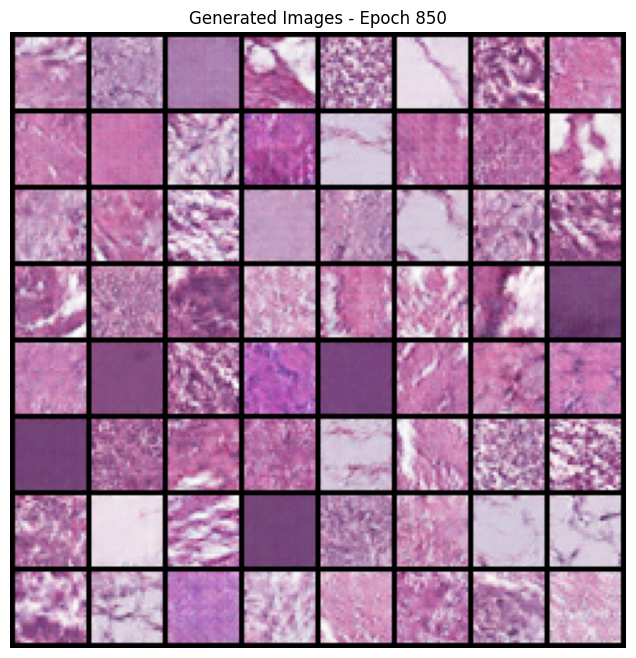

Saved and displayed generated samples at epoch 850
 Saved checkpoint at epoch 850


Epoch 851/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.119, g_loss=3.647]


[Epoch 851] D_loss=0.1330 | G_loss=3.5183


Epoch 852/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.266, g_loss=4.041]


[Epoch 852] D_loss=0.1617 | G_loss=3.4543


Epoch 853/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.097, g_loss=3.826]


[Epoch 853] D_loss=0.1555 | G_loss=3.6026


Epoch 854/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.118, g_loss=3.480]


[Epoch 854] D_loss=0.1426 | G_loss=3.4010


Epoch 855/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.332, g_loss=2.634]


[Epoch 855] D_loss=0.1695 | G_loss=3.3990


Epoch 856/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.201, g_loss=3.045]


[Epoch 856] D_loss=0.1810 | G_loss=3.3019


Epoch 857/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.129, g_loss=3.468]


[Epoch 857] D_loss=0.2050 | G_loss=3.2860


Epoch 858/1200: 100%|██████████| 6/6 [00:11<00:00,  1.95s/it, d_loss=0.100, g_loss=4.685]


[Epoch 858] D_loss=0.1654 | G_loss=3.7623


Epoch 859/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.047, g_loss=4.290]


[Epoch 859] D_loss=0.1606 | G_loss=3.8883


Epoch 860/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.226, g_loss=3.241]


[Epoch 860] D_loss=0.1600 | G_loss=3.4014


Epoch 861/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.137, g_loss=4.208]


[Epoch 861] D_loss=0.3584 | G_loss=3.5987


Epoch 862/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.202, g_loss=3.591]


[Epoch 862] D_loss=0.1681 | G_loss=3.4164


Epoch 863/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.116, g_loss=3.852]


[Epoch 863] D_loss=0.1466 | G_loss=3.5735


Epoch 864/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.365, g_loss=2.250]


[Epoch 864] D_loss=0.1510 | G_loss=3.4432


Epoch 865/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.374, g_loss=3.866]


[Epoch 865] D_loss=0.2958 | G_loss=3.5814


Epoch 866/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.245, g_loss=4.574]


[Epoch 866] D_loss=0.2611 | G_loss=3.8967


Epoch 867/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=1.072, g_loss=1.270]


[Epoch 867] D_loss=0.3518 | G_loss=3.4618


Epoch 868/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.248, g_loss=3.862]


[Epoch 868] D_loss=0.3804 | G_loss=3.7270


Epoch 869/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.321, g_loss=3.477]


[Epoch 869] D_loss=0.2376 | G_loss=3.4243


Epoch 870/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.319, g_loss=3.767]


[Epoch 870] D_loss=0.2523 | G_loss=3.4421


Epoch 871/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.424, g_loss=2.752]


[Epoch 871] D_loss=0.2668 | G_loss=3.5346


Epoch 872/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.080, g_loss=3.915]


[Epoch 872] D_loss=0.1548 | G_loss=3.6394


Epoch 873/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.276, g_loss=2.764]


[Epoch 873] D_loss=0.2171 | G_loss=3.3801


Epoch 874/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.347, g_loss=3.169]


[Epoch 874] D_loss=0.1567 | G_loss=3.5503


Epoch 875/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.135, g_loss=3.832]


[Epoch 875] D_loss=0.1725 | G_loss=3.8633


Epoch 876/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.087, g_loss=4.449]


[Epoch 876] D_loss=0.1638 | G_loss=3.5227


Epoch 877/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.242, g_loss=2.599]


[Epoch 877] D_loss=0.1784 | G_loss=3.4379


Epoch 878/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.192, g_loss=4.092]


[Epoch 878] D_loss=0.1858 | G_loss=3.5444


Epoch 879/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.274, g_loss=3.337]


[Epoch 879] D_loss=0.1979 | G_loss=3.5537


Epoch 880/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.190, g_loss=3.129]


[Epoch 880] D_loss=0.1727 | G_loss=3.5010


Epoch 881/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.086, g_loss=3.664]


[Epoch 881] D_loss=0.1458 | G_loss=3.5785


Epoch 882/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.514, g_loss=3.647]


[Epoch 882] D_loss=0.1895 | G_loss=3.5166


Epoch 883/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.165, g_loss=3.439]


[Epoch 883] D_loss=0.1563 | G_loss=3.4534


Epoch 884/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.072, g_loss=4.353]


[Epoch 884] D_loss=0.1357 | G_loss=3.5924


Epoch 885/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.145, g_loss=3.451]


[Epoch 885] D_loss=0.1361 | G_loss=3.4152


Epoch 886/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.305, g_loss=3.884]


[Epoch 886] D_loss=0.1418 | G_loss=3.6443


Epoch 887/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.460, g_loss=3.076]


[Epoch 887] D_loss=0.3616 | G_loss=3.2955


Epoch 888/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.097, g_loss=3.980]


[Epoch 888] D_loss=0.3325 | G_loss=3.5751


Epoch 889/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.110, g_loss=3.695]


[Epoch 889] D_loss=0.1942 | G_loss=3.3947


Epoch 890/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.084, g_loss=3.374]


[Epoch 890] D_loss=0.1575 | G_loss=3.6815


Epoch 891/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.073, g_loss=3.620]


[Epoch 891] D_loss=0.1287 | G_loss=3.6382


Epoch 892/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.184, g_loss=2.991]


[Epoch 892] D_loss=0.1523 | G_loss=3.4694


Epoch 893/1200: 100%|██████████| 6/6 [00:11<00:00,  1.94s/it, d_loss=0.163, g_loss=3.820]


[Epoch 893] D_loss=0.1690 | G_loss=3.6573


Epoch 894/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.106, g_loss=3.947]


[Epoch 894] D_loss=0.1265 | G_loss=3.7311


Epoch 895/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.179, g_loss=3.325]


[Epoch 895] D_loss=0.1184 | G_loss=3.7485


Epoch 896/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.267, g_loss=2.997]


[Epoch 896] D_loss=0.1607 | G_loss=3.4890


Epoch 897/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.257, g_loss=3.121]


[Epoch 897] D_loss=0.1495 | G_loss=3.7009


Epoch 898/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.098, g_loss=3.934]


[Epoch 898] D_loss=0.1785 | G_loss=3.8110


Epoch 899/1200: 100%|██████████| 6/6 [00:11<00:00,  1.95s/it, d_loss=0.095, g_loss=3.964]


[Epoch 899] D_loss=0.1652 | G_loss=3.6204


Epoch 900/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.089, g_loss=4.200]


[Epoch 900] D_loss=0.1743 | G_loss=3.7249


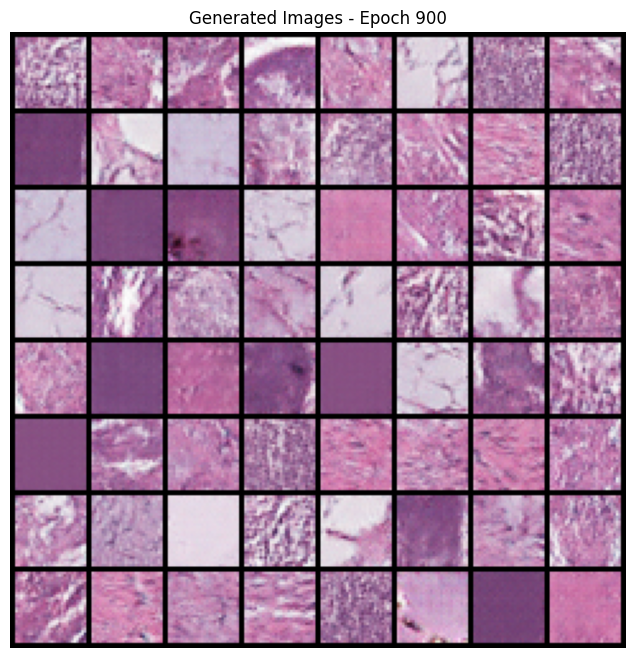

Saved and displayed generated samples at epoch 900
 Saved checkpoint at epoch 900


Epoch 901/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.284, g_loss=3.245]


[Epoch 901] D_loss=0.1953 | G_loss=3.4039


Epoch 902/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.955, g_loss=2.494]


[Epoch 902] D_loss=0.3796 | G_loss=3.5519


Epoch 903/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.234, g_loss=3.668]


[Epoch 903] D_loss=0.5479 | G_loss=3.4034


Epoch 904/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.226, g_loss=3.725]


[Epoch 904] D_loss=0.3703 | G_loss=3.3227


Epoch 905/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.090, g_loss=4.149]


[Epoch 905] D_loss=0.1511 | G_loss=3.6407


Epoch 906/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.060, g_loss=3.982]


[Epoch 906] D_loss=0.1354 | G_loss=3.7853


Epoch 907/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.113, g_loss=3.702]


[Epoch 907] D_loss=0.1538 | G_loss=3.6387


Epoch 908/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.367, g_loss=3.822]


[Epoch 908] D_loss=0.2945 | G_loss=3.6788


Epoch 909/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.255, g_loss=3.272]


[Epoch 909] D_loss=0.1822 | G_loss=3.5186


Epoch 910/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.195, g_loss=2.986]


[Epoch 910] D_loss=0.1852 | G_loss=3.6376


Epoch 911/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.153, g_loss=3.457]


[Epoch 911] D_loss=0.1524 | G_loss=3.5151


Epoch 912/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.265, g_loss=2.891]


[Epoch 912] D_loss=0.1453 | G_loss=3.6507


Epoch 913/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.117, g_loss=3.748]


[Epoch 913] D_loss=0.1318 | G_loss=3.8191


Epoch 914/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.180, g_loss=3.587]


[Epoch 914] D_loss=0.1626 | G_loss=3.6174


Epoch 915/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.066, g_loss=3.852]


[Epoch 915] D_loss=0.1254 | G_loss=3.7127


Epoch 916/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.171, g_loss=3.157]


[Epoch 916] D_loss=0.1407 | G_loss=3.7221


Epoch 917/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.113, g_loss=3.592]


[Epoch 917] D_loss=0.1103 | G_loss=3.7010


Epoch 918/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.222, g_loss=3.317]


[Epoch 918] D_loss=0.1398 | G_loss=3.8093


Epoch 919/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.115, g_loss=3.383]


[Epoch 919] D_loss=0.1878 | G_loss=3.6614


Epoch 920/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.067, g_loss=4.352]


[Epoch 920] D_loss=0.1211 | G_loss=3.6710


Epoch 921/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.127, g_loss=3.561]


[Epoch 921] D_loss=0.1122 | G_loss=3.8678


Epoch 922/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.100, g_loss=3.998]


[Epoch 922] D_loss=0.1049 | G_loss=3.8040


Epoch 923/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.272, g_loss=2.931]


[Epoch 923] D_loss=0.1395 | G_loss=3.8161


Epoch 924/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.264, g_loss=3.371]


[Epoch 924] D_loss=0.1139 | G_loss=3.9282


Epoch 925/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.102, g_loss=3.241]


[Epoch 925] D_loss=0.1413 | G_loss=3.8143


Epoch 926/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.045, g_loss=4.179]


[Epoch 926] D_loss=0.0894 | G_loss=3.8584


Epoch 927/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.118, g_loss=3.099]


[Epoch 927] D_loss=0.1253 | G_loss=3.7669


Epoch 928/1200: 100%|██████████| 6/6 [00:11<00:00,  1.96s/it, d_loss=0.078, g_loss=3.953]


[Epoch 928] D_loss=0.1315 | G_loss=3.9607


Epoch 929/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.052, g_loss=4.555]


[Epoch 929] D_loss=0.0793 | G_loss=4.0695


Epoch 930/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.146, g_loss=3.815]


[Epoch 930] D_loss=0.1186 | G_loss=3.6204


Epoch 931/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.091, g_loss=3.996]


[Epoch 931] D_loss=0.1232 | G_loss=3.6636


Epoch 932/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.158, g_loss=3.273]


[Epoch 932] D_loss=0.1141 | G_loss=3.7853


Epoch 933/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.063, g_loss=4.060]


[Epoch 933] D_loss=0.0922 | G_loss=3.8696


Epoch 934/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.154, g_loss=2.896]


[Epoch 934] D_loss=0.0950 | G_loss=3.8004


Epoch 935/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.547, g_loss=4.829]


[Epoch 935] D_loss=0.2668 | G_loss=4.0296


Epoch 936/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.816, g_loss=4.860]


[Epoch 936] D_loss=0.8027 | G_loss=3.5113


Epoch 937/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=1.591, g_loss=3.297]


[Epoch 937] D_loss=1.6954 | G_loss=3.8418


Epoch 938/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.643, g_loss=2.513]


[Epoch 938] D_loss=1.4045 | G_loss=2.8681


Epoch 939/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.775, g_loss=3.022]


[Epoch 939] D_loss=0.5540 | G_loss=3.1288


Epoch 940/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.572, g_loss=3.189]


[Epoch 940] D_loss=0.4845 | G_loss=3.0860


Epoch 941/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.770, g_loss=2.434]


[Epoch 941] D_loss=0.2846 | G_loss=3.4177


Epoch 942/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.505, g_loss=2.160]


[Epoch 942] D_loss=0.4959 | G_loss=3.5674


Epoch 943/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.174, g_loss=3.567]


[Epoch 943] D_loss=0.4390 | G_loss=3.4990


Epoch 944/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.330, g_loss=3.829]


[Epoch 944] D_loss=0.4375 | G_loss=3.5931


Epoch 945/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.372, g_loss=3.310]


[Epoch 945] D_loss=0.2800 | G_loss=3.2167


Epoch 946/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.266, g_loss=3.450]


[Epoch 946] D_loss=0.3554 | G_loss=3.1729


Epoch 947/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.319, g_loss=4.263]


[Epoch 947] D_loss=0.3974 | G_loss=3.4174


Epoch 948/1200: 100%|██████████| 6/6 [00:11<00:00,  1.95s/it, d_loss=0.071, g_loss=4.037]


[Epoch 948] D_loss=0.2002 | G_loss=3.4450


Epoch 949/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.291, g_loss=3.564]


[Epoch 949] D_loss=0.1665 | G_loss=3.5526


Epoch 950/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.101, g_loss=3.559]


[Epoch 950] D_loss=0.2712 | G_loss=3.3514


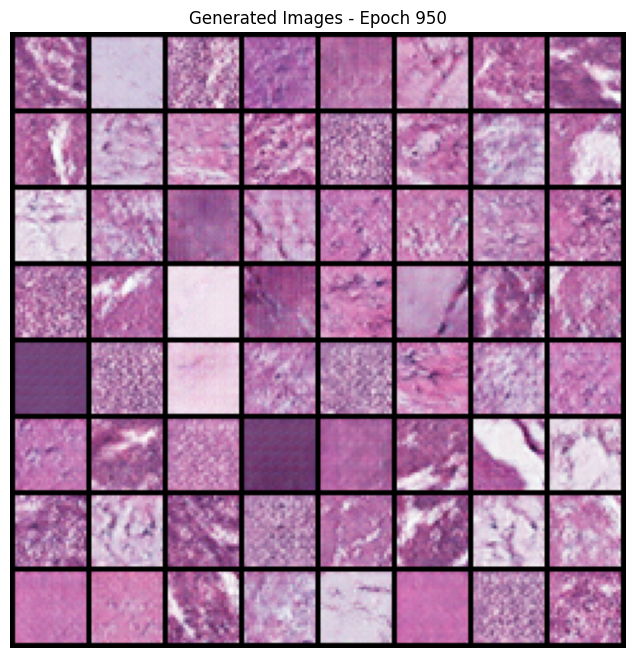

Saved and displayed generated samples at epoch 950
 Saved checkpoint at epoch 950


Epoch 951/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.110, g_loss=3.638]


[Epoch 951] D_loss=0.1399 | G_loss=3.4759


Epoch 952/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.276, g_loss=2.756]


[Epoch 952] D_loss=0.2085 | G_loss=3.3123


Epoch 953/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.127, g_loss=3.755]


[Epoch 953] D_loss=0.2054 | G_loss=3.2543


Epoch 954/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.253, g_loss=3.380]


[Epoch 954] D_loss=0.1810 | G_loss=3.4971


Epoch 955/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.177, g_loss=3.581]


[Epoch 955] D_loss=0.1359 | G_loss=3.6218


Epoch 956/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.195, g_loss=3.590]


[Epoch 956] D_loss=0.1731 | G_loss=3.3789


Epoch 957/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=1.620, g_loss=0.881]


[Epoch 957] D_loss=0.3608 | G_loss=3.2657


Epoch 958/1200: 100%|██████████| 6/6 [00:11<00:00,  1.97s/it, d_loss=1.898, g_loss=4.595]


[Epoch 958] D_loss=1.3460 | G_loss=4.0612


Epoch 959/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=1.867, g_loss=1.382]


[Epoch 959] D_loss=1.7666 | G_loss=2.7320


Epoch 960/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.901, g_loss=3.988]


[Epoch 960] D_loss=0.6470 | G_loss=3.1845


Epoch 961/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.446, g_loss=3.180]


[Epoch 961] D_loss=0.4986 | G_loss=3.0655


Epoch 962/1200: 100%|██████████| 6/6 [00:11<00:00,  1.94s/it, d_loss=0.379, g_loss=3.112]


[Epoch 962] D_loss=0.3204 | G_loss=2.8133


Epoch 963/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.238, g_loss=3.645]


[Epoch 963] D_loss=0.3929 | G_loss=3.2695


Epoch 964/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.243, g_loss=3.695]


[Epoch 964] D_loss=0.2601 | G_loss=3.1986


Epoch 965/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.117, g_loss=4.721]


[Epoch 965] D_loss=0.2572 | G_loss=3.5604


Epoch 966/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=1.475, g_loss=1.746]


[Epoch 966] D_loss=0.3579 | G_loss=3.3662


Epoch 967/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.281, g_loss=2.722]


[Epoch 967] D_loss=0.2809 | G_loss=3.1322


Epoch 968/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.318, g_loss=3.294]


[Epoch 968] D_loss=0.4407 | G_loss=3.3660


Epoch 969/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.155, g_loss=3.230]


[Epoch 969] D_loss=0.3044 | G_loss=3.2398


Epoch 970/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.165, g_loss=3.827]


[Epoch 970] D_loss=0.1942 | G_loss=3.2302


Epoch 971/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.212, g_loss=3.122]


[Epoch 971] D_loss=0.2545 | G_loss=3.0571


Epoch 972/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.182, g_loss=3.417]


[Epoch 972] D_loss=0.1767 | G_loss=3.4387


Epoch 973/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.085, g_loss=3.597]


[Epoch 973] D_loss=0.1824 | G_loss=3.3678


Epoch 974/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.139, g_loss=3.644]


[Epoch 974] D_loss=0.1551 | G_loss=3.4553


Epoch 975/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.096, g_loss=3.198]


[Epoch 975] D_loss=0.1909 | G_loss=3.2923


Epoch 976/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.144, g_loss=3.496]


[Epoch 976] D_loss=0.1961 | G_loss=3.7310


Epoch 977/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.123, g_loss=3.373]


[Epoch 977] D_loss=0.1323 | G_loss=3.5053


Epoch 978/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.241, g_loss=3.707]


[Epoch 978] D_loss=0.1665 | G_loss=3.5558


Epoch 979/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.096, g_loss=3.976]


[Epoch 979] D_loss=0.1238 | G_loss=3.6425


Epoch 980/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.091, g_loss=3.579]


[Epoch 980] D_loss=0.1051 | G_loss=3.5862


Epoch 981/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.196, g_loss=2.917]


[Epoch 981] D_loss=0.1677 | G_loss=3.5269


Epoch 982/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.215, g_loss=3.492]


[Epoch 982] D_loss=0.1568 | G_loss=3.6486


Epoch 983/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.219, g_loss=3.887]


[Epoch 983] D_loss=0.2098 | G_loss=3.7602


Epoch 984/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.074, g_loss=4.352]


[Epoch 984] D_loss=0.1051 | G_loss=3.9434


Epoch 985/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.448, g_loss=2.490]


[Epoch 985] D_loss=0.1623 | G_loss=3.4194


Epoch 986/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.235, g_loss=3.383]


[Epoch 986] D_loss=0.1680 | G_loss=3.7609


Epoch 987/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.445, g_loss=3.370]


[Epoch 987] D_loss=0.2236 | G_loss=3.6498


Epoch 988/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.130, g_loss=3.702]


[Epoch 988] D_loss=0.1591 | G_loss=3.6944


Epoch 989/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.421, g_loss=2.439]


[Epoch 989] D_loss=0.1665 | G_loss=3.4478


Epoch 990/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.249, g_loss=3.192]


[Epoch 990] D_loss=0.1844 | G_loss=3.6641


Epoch 991/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.109, g_loss=4.524]


[Epoch 991] D_loss=0.1770 | G_loss=3.6439


Epoch 992/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.096, g_loss=5.345]


[Epoch 992] D_loss=0.3052 | G_loss=3.9482


Epoch 993/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.317, g_loss=3.439]


[Epoch 993] D_loss=0.2312 | G_loss=3.7317


Epoch 994/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.290, g_loss=3.925]


[Epoch 994] D_loss=0.1605 | G_loss=3.5971


Epoch 995/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.755, g_loss=3.344]


[Epoch 995] D_loss=0.4771 | G_loss=3.9439


Epoch 996/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.213, g_loss=2.856]


[Epoch 996] D_loss=0.3582 | G_loss=3.1718


Epoch 997/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.364, g_loss=2.875]


[Epoch 997] D_loss=0.2026 | G_loss=3.9424


Epoch 998/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.415, g_loss=3.557]


[Epoch 998] D_loss=0.3039 | G_loss=3.5531


Epoch 999/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.089, g_loss=3.993]


[Epoch 999] D_loss=0.1596 | G_loss=3.5536


Epoch 1000/1200: 100%|██████████| 6/6 [00:11<00:00,  1.94s/it, d_loss=0.091, g_loss=3.890]


[Epoch 1000] D_loss=0.1608 | G_loss=3.8963


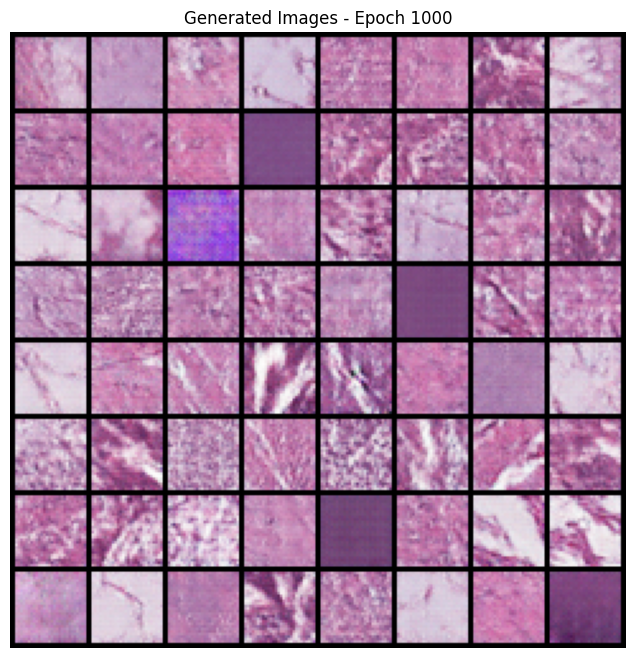

Saved and displayed generated samples at epoch 1000
 Saved checkpoint at epoch 1000


Epoch 1001/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.179, g_loss=3.290]


[Epoch 1001] D_loss=0.2034 | G_loss=3.5093


Epoch 1002/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.095, g_loss=3.859]


[Epoch 1002] D_loss=0.1306 | G_loss=3.8736


Epoch 1003/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.070, g_loss=4.078]


[Epoch 1003] D_loss=0.1133 | G_loss=3.6785


Epoch 1004/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.091, g_loss=4.029]


[Epoch 1004] D_loss=0.1453 | G_loss=3.6043


Epoch 1005/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.177, g_loss=3.547]


[Epoch 1005] D_loss=0.1369 | G_loss=3.6173


Epoch 1006/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.449, g_loss=2.311]


[Epoch 1006] D_loss=0.1410 | G_loss=3.8212


Epoch 1007/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.129, g_loss=4.848]


[Epoch 1007] D_loss=0.1629 | G_loss=4.0300


Epoch 1008/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.243, g_loss=4.063]


[Epoch 1008] D_loss=0.1763 | G_loss=3.7741


Epoch 1009/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.072, g_loss=3.464]


[Epoch 1009] D_loss=0.1273 | G_loss=3.8004


Epoch 1010/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.388, g_loss=3.753]


[Epoch 1010] D_loss=0.2420 | G_loss=3.4422


Epoch 1011/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.321, g_loss=4.297]


[Epoch 1011] D_loss=0.4286 | G_loss=4.1091


Epoch 1012/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.353, g_loss=3.033]


[Epoch 1012] D_loss=0.3293 | G_loss=3.4100


Epoch 1013/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.155, g_loss=3.560]


[Epoch 1013] D_loss=0.1775 | G_loss=3.5958


Epoch 1014/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.086, g_loss=4.348]


[Epoch 1014] D_loss=0.1332 | G_loss=3.8665


Epoch 1015/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.051, g_loss=4.263]


[Epoch 1015] D_loss=0.1308 | G_loss=3.8646


Epoch 1016/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.599, g_loss=2.892]


[Epoch 1016] D_loss=0.1997 | G_loss=3.7948


Epoch 1017/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.166, g_loss=3.637]


[Epoch 1017] D_loss=0.2358 | G_loss=3.5233


Epoch 1018/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.096, g_loss=3.938]


[Epoch 1018] D_loss=0.1332 | G_loss=3.5184


Epoch 1019/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=1.073, g_loss=1.956]


[Epoch 1019] D_loss=0.3006 | G_loss=3.3206


Epoch 1020/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.686, g_loss=3.665]


[Epoch 1020] D_loss=0.5901 | G_loss=3.9334


Epoch 1021/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.146, g_loss=3.985]


[Epoch 1021] D_loss=0.2765 | G_loss=3.6329


Epoch 1022/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.319, g_loss=3.595]


[Epoch 1022] D_loss=0.1705 | G_loss=3.5825


Epoch 1023/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.190, g_loss=3.798]


[Epoch 1023] D_loss=0.2189 | G_loss=3.5897


Epoch 1024/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.181, g_loss=3.229]


[Epoch 1024] D_loss=0.2379 | G_loss=3.5879


Epoch 1025/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.140, g_loss=3.134]


[Epoch 1025] D_loss=0.1442 | G_loss=3.5764


Epoch 1026/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.163, g_loss=3.231]


[Epoch 1026] D_loss=0.1285 | G_loss=3.7685


Epoch 1027/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.151, g_loss=3.228]


[Epoch 1027] D_loss=0.1390 | G_loss=3.5778


Epoch 1028/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.074, g_loss=4.261]


[Epoch 1028] D_loss=0.1634 | G_loss=3.8229


Epoch 1029/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.204, g_loss=3.884]


[Epoch 1029] D_loss=0.1392 | G_loss=3.5903


Epoch 1030/1200: 100%|██████████| 6/6 [00:11<00:00,  1.95s/it, d_loss=0.393, g_loss=3.128]


[Epoch 1030] D_loss=0.1787 | G_loss=3.6688


Epoch 1031/1200: 100%|██████████| 6/6 [00:12<00:00,  2.01s/it, d_loss=0.106, g_loss=3.602]


[Epoch 1031] D_loss=0.1114 | G_loss=3.7930


Epoch 1032/1200: 100%|██████████| 6/6 [00:11<00:00,  1.95s/it, d_loss=0.095, g_loss=4.571]


[Epoch 1032] D_loss=0.1458 | G_loss=3.6944


Epoch 1033/1200: 100%|██████████| 6/6 [00:11<00:00,  1.98s/it, d_loss=0.089, g_loss=4.107]


[Epoch 1033] D_loss=0.1139 | G_loss=3.7644


Epoch 1034/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.114, g_loss=3.804]


[Epoch 1034] D_loss=0.1301 | G_loss=3.5663


Epoch 1035/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.039, g_loss=4.330]


[Epoch 1035] D_loss=0.1237 | G_loss=3.7135


Epoch 1036/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.037, g_loss=4.948]


[Epoch 1036] D_loss=0.2732 | G_loss=3.4996


Epoch 1037/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.268, g_loss=4.490]


[Epoch 1037] D_loss=0.1837 | G_loss=3.8049


Epoch 1038/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.081, g_loss=4.530]


[Epoch 1038] D_loss=0.1481 | G_loss=4.0772


Epoch 1039/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.199, g_loss=4.056]


[Epoch 1039] D_loss=0.1878 | G_loss=4.0049


Epoch 1040/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.025, g_loss=5.744]


[Epoch 1040] D_loss=0.2094 | G_loss=3.8851


Epoch 1041/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.526, g_loss=2.846]


[Epoch 1041] D_loss=0.1980 | G_loss=3.9330


Epoch 1042/1200: 100%|██████████| 6/6 [00:11<00:00,  1.97s/it, d_loss=0.229, g_loss=4.287]


[Epoch 1042] D_loss=0.3258 | G_loss=3.7997


Epoch 1043/1200: 100%|██████████| 6/6 [00:11<00:00,  1.96s/it, d_loss=0.134, g_loss=3.726]


[Epoch 1043] D_loss=0.2886 | G_loss=3.9035


Epoch 1044/1200: 100%|██████████| 6/6 [00:11<00:00,  1.99s/it, d_loss=0.106, g_loss=3.616]


[Epoch 1044] D_loss=0.1140 | G_loss=3.8911


Epoch 1045/1200: 100%|██████████| 6/6 [00:11<00:00,  1.94s/it, d_loss=0.103, g_loss=3.919]


[Epoch 1045] D_loss=0.1152 | G_loss=3.6218


Epoch 1046/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.110, g_loss=4.084]


[Epoch 1046] D_loss=0.1117 | G_loss=3.7870


Epoch 1047/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.131, g_loss=3.627]


[Epoch 1047] D_loss=0.0843 | G_loss=3.9182


Epoch 1048/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.883, g_loss=1.760]


[Epoch 1048] D_loss=0.2554 | G_loss=3.2227


Epoch 1049/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.339, g_loss=2.955]


[Epoch 1049] D_loss=0.4748 | G_loss=3.5258


Epoch 1050/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.457, g_loss=2.876]


[Epoch 1050] D_loss=0.3258 | G_loss=3.2682


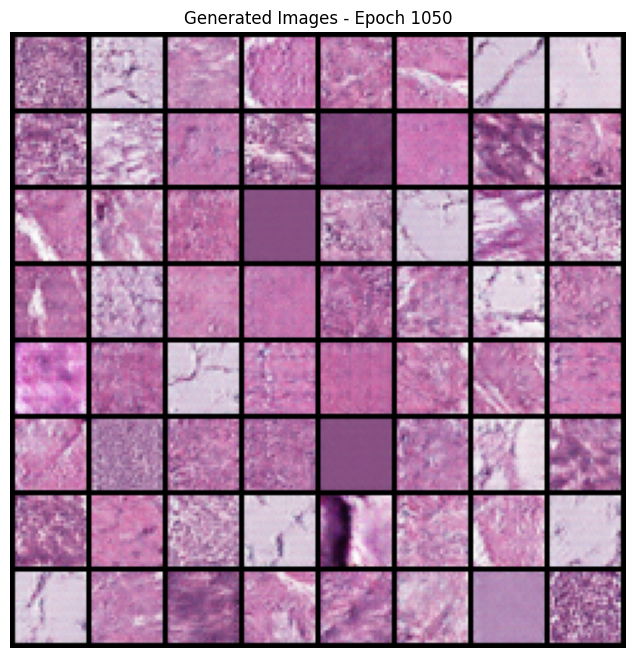

Saved and displayed generated samples at epoch 1050
 Saved checkpoint at epoch 1050


Epoch 1051/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.088, g_loss=3.042]


[Epoch 1051] D_loss=0.2178 | G_loss=3.6582


Epoch 1052/1200: 100%|██████████| 6/6 [00:11<00:00,  1.94s/it, d_loss=0.322, g_loss=3.500]


[Epoch 1052] D_loss=0.2014 | G_loss=3.7461


Epoch 1053/1200: 100%|██████████| 6/6 [00:11<00:00,  1.94s/it, d_loss=0.263, g_loss=4.206]


[Epoch 1053] D_loss=0.1814 | G_loss=3.7460


Epoch 1054/1200: 100%|██████████| 6/6 [00:11<00:00,  1.96s/it, d_loss=0.116, g_loss=4.737]


[Epoch 1054] D_loss=0.1726 | G_loss=3.6869


Epoch 1055/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.103, g_loss=4.183]


[Epoch 1055] D_loss=0.1192 | G_loss=3.8367


Epoch 1056/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.045, g_loss=4.494]


[Epoch 1056] D_loss=0.1367 | G_loss=3.8345


Epoch 1057/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.168, g_loss=3.060]


[Epoch 1057] D_loss=0.1591 | G_loss=3.8233


Epoch 1058/1200: 100%|██████████| 6/6 [00:11<00:00,  1.96s/it, d_loss=0.361, g_loss=3.483]


[Epoch 1058] D_loss=0.2088 | G_loss=3.6766


Epoch 1059/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.104, g_loss=3.573]


[Epoch 1059] D_loss=0.2086 | G_loss=3.6778


Epoch 1060/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.181, g_loss=3.239]


[Epoch 1060] D_loss=0.1240 | G_loss=3.9600


Epoch 1061/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.429, g_loss=2.519]


[Epoch 1061] D_loss=0.1674 | G_loss=3.9792


Epoch 1062/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.247, g_loss=3.445]


[Epoch 1062] D_loss=0.1561 | G_loss=3.6730


Epoch 1063/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.292, g_loss=3.427]


[Epoch 1063] D_loss=0.1266 | G_loss=3.8258


Epoch 1064/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.101, g_loss=4.012]


[Epoch 1064] D_loss=0.1391 | G_loss=4.5131


Epoch 1065/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.110, g_loss=3.865]


[Epoch 1065] D_loss=0.0797 | G_loss=4.0275


Epoch 1066/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.570, g_loss=2.458]


[Epoch 1066] D_loss=0.2096 | G_loss=3.4181


Epoch 1067/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.642, g_loss=3.784]


[Epoch 1067] D_loss=0.2350 | G_loss=3.8507


Epoch 1068/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=1.123, g_loss=2.976]


[Epoch 1068] D_loss=0.3697 | G_loss=3.8925


Epoch 1069/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.691, g_loss=3.366]


[Epoch 1069] D_loss=0.3617 | G_loss=3.3881


Epoch 1070/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.103, g_loss=4.430]


[Epoch 1070] D_loss=0.2481 | G_loss=3.9725


Epoch 1071/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.377, g_loss=4.186]


[Epoch 1071] D_loss=0.1590 | G_loss=3.8661


Epoch 1072/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.153, g_loss=4.201]


[Epoch 1072] D_loss=0.2154 | G_loss=3.7136


Epoch 1073/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.337, g_loss=3.730]


[Epoch 1073] D_loss=0.1851 | G_loss=3.6117


Epoch 1074/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.205, g_loss=3.366]


[Epoch 1074] D_loss=0.1305 | G_loss=3.7548


Epoch 1075/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.079, g_loss=4.284]


[Epoch 1075] D_loss=0.0970 | G_loss=3.9873


Epoch 1076/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.166, g_loss=4.482]


[Epoch 1076] D_loss=0.1324 | G_loss=3.8613


Epoch 1077/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.067, g_loss=4.083]


[Epoch 1077] D_loss=0.1058 | G_loss=3.9561


Epoch 1078/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.390, g_loss=2.677]


[Epoch 1078] D_loss=0.1330 | G_loss=3.8943


Epoch 1079/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.197, g_loss=3.973]


[Epoch 1079] D_loss=0.2974 | G_loss=3.9673


Epoch 1080/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.530, g_loss=2.747]


[Epoch 1080] D_loss=0.2599 | G_loss=3.5009


Epoch 1081/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.139, g_loss=3.808]


[Epoch 1081] D_loss=0.1716 | G_loss=3.6916


Epoch 1082/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.282, g_loss=3.256]


[Epoch 1082] D_loss=0.1837 | G_loss=3.9800


Epoch 1083/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.282, g_loss=3.696]


[Epoch 1083] D_loss=0.5685 | G_loss=4.0962


Epoch 1084/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.296, g_loss=3.950]


[Epoch 1084] D_loss=0.5426 | G_loss=3.9087


Epoch 1085/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.375, g_loss=4.917]


[Epoch 1085] D_loss=0.3133 | G_loss=4.0121


Epoch 1086/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.296, g_loss=3.383]


[Epoch 1086] D_loss=0.3690 | G_loss=3.4750


Epoch 1087/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.155, g_loss=3.927]


[Epoch 1087] D_loss=0.1917 | G_loss=3.5262


Epoch 1088/1200: 100%|██████████| 6/6 [00:11<00:00,  1.94s/it, d_loss=0.289, g_loss=2.450]


[Epoch 1088] D_loss=0.1583 | G_loss=3.4380


Epoch 1089/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.171, g_loss=3.422]


[Epoch 1089] D_loss=0.1620 | G_loss=3.7516


Epoch 1090/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.210, g_loss=2.947]


[Epoch 1090] D_loss=0.1678 | G_loss=3.5915


Epoch 1091/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.259, g_loss=3.066]


[Epoch 1091] D_loss=0.1885 | G_loss=3.6954


Epoch 1092/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.282, g_loss=5.492]


[Epoch 1092] D_loss=0.3764 | G_loss=4.0383


Epoch 1093/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.249, g_loss=3.880]


[Epoch 1093] D_loss=0.3917 | G_loss=3.5395


Epoch 1094/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.097, g_loss=3.869]


[Epoch 1094] D_loss=0.1589 | G_loss=3.7004


Epoch 1095/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.408, g_loss=3.625]


[Epoch 1095] D_loss=0.1437 | G_loss=3.7879


Epoch 1096/1200: 100%|██████████| 6/6 [00:11<00:00,  1.84s/it, d_loss=0.122, g_loss=3.735]


[Epoch 1096] D_loss=0.1419 | G_loss=3.4979


Epoch 1097/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.131, g_loss=4.069]


[Epoch 1097] D_loss=0.1304 | G_loss=3.7015


Epoch 1098/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.379, g_loss=3.225]


[Epoch 1098] D_loss=0.1528 | G_loss=3.7757


Epoch 1099/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.246, g_loss=3.214]


[Epoch 1099] D_loss=0.1825 | G_loss=3.6033


Epoch 1100/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.183, g_loss=4.756]


[Epoch 1100] D_loss=0.1719 | G_loss=4.1527


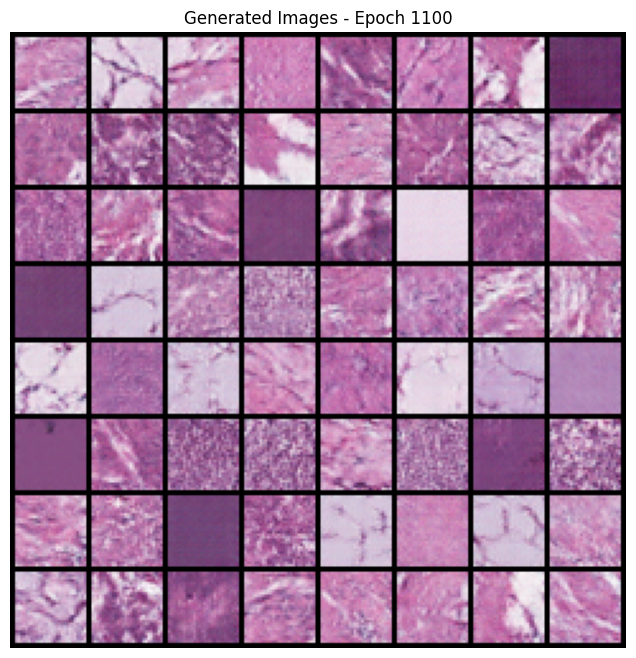

Saved and displayed generated samples at epoch 1100
 Saved checkpoint at epoch 1100


Epoch 1101/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.163, g_loss=4.455]


[Epoch 1101] D_loss=0.1100 | G_loss=3.8243


Epoch 1102/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.102, g_loss=3.998]


[Epoch 1102] D_loss=0.1474 | G_loss=3.9690


Epoch 1103/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.073, g_loss=4.242]


[Epoch 1103] D_loss=0.1046 | G_loss=4.3116


Epoch 1104/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.158, g_loss=3.830]


[Epoch 1104] D_loss=0.1466 | G_loss=3.4158


Epoch 1105/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.106, g_loss=4.617]


[Epoch 1105] D_loss=0.1148 | G_loss=3.9960


Epoch 1106/1200: 100%|██████████| 6/6 [00:11<00:00,  1.85s/it, d_loss=0.105, g_loss=4.121]


[Epoch 1106] D_loss=0.0757 | G_loss=4.1121


Epoch 1107/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.182, g_loss=3.779]


[Epoch 1107] D_loss=0.1205 | G_loss=4.2288


Epoch 1108/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.076, g_loss=3.999]


[Epoch 1108] D_loss=0.0882 | G_loss=4.2625


Epoch 1109/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.056, g_loss=4.630]


[Epoch 1109] D_loss=0.0967 | G_loss=3.9671


Epoch 1110/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.176, g_loss=4.422]


[Epoch 1110] D_loss=0.1883 | G_loss=3.8095


Epoch 1111/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.044, g_loss=4.939]


[Epoch 1111] D_loss=0.1173 | G_loss=4.3776


Epoch 1112/1200: 100%|██████████| 6/6 [00:11<00:00,  1.94s/it, d_loss=0.063, g_loss=3.988]


[Epoch 1112] D_loss=0.0791 | G_loss=4.3456


Epoch 1113/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.080, g_loss=3.950]


[Epoch 1113] D_loss=0.0869 | G_loss=3.9405


Epoch 1114/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.291, g_loss=4.079]


[Epoch 1114] D_loss=0.3006 | G_loss=4.1416


Epoch 1115/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.168, g_loss=4.150]


[Epoch 1115] D_loss=0.6015 | G_loss=4.7604


Epoch 1116/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.137, g_loss=3.431]


[Epoch 1116] D_loss=0.1622 | G_loss=3.6559


Epoch 1117/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.139, g_loss=3.720]


[Epoch 1117] D_loss=0.1231 | G_loss=3.6631


Epoch 1118/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.114, g_loss=3.791]


[Epoch 1118] D_loss=0.1053 | G_loss=3.8428


Epoch 1119/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.128, g_loss=3.669]


[Epoch 1119] D_loss=0.1143 | G_loss=3.6637


Epoch 1120/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.231, g_loss=3.954]


[Epoch 1120] D_loss=0.1546 | G_loss=3.7938


Epoch 1121/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.110, g_loss=3.874]


[Epoch 1121] D_loss=0.0941 | G_loss=3.9702


Epoch 1122/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.073, g_loss=3.905]


[Epoch 1122] D_loss=0.0798 | G_loss=3.8517


Epoch 1123/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.075, g_loss=3.968]


[Epoch 1123] D_loss=0.0732 | G_loss=3.9146


Epoch 1124/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.088, g_loss=3.952]


[Epoch 1124] D_loss=0.0751 | G_loss=3.9256


Epoch 1125/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.064, g_loss=3.940]


[Epoch 1125] D_loss=0.0615 | G_loss=3.9077


Epoch 1126/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.060, g_loss=3.926]


[Epoch 1126] D_loss=0.0624 | G_loss=3.8567


Epoch 1127/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.046, g_loss=4.288]


[Epoch 1127] D_loss=0.0660 | G_loss=3.9035


Epoch 1128/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.137, g_loss=3.651]


[Epoch 1128] D_loss=0.0767 | G_loss=3.8830


Epoch 1129/1200: 100%|██████████| 6/6 [00:11<00:00,  1.97s/it, d_loss=0.083, g_loss=3.760]


[Epoch 1129] D_loss=0.0710 | G_loss=3.8499


Epoch 1130/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.051, g_loss=4.352]


[Epoch 1130] D_loss=0.0754 | G_loss=3.8881


Epoch 1131/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.109, g_loss=3.749]


[Epoch 1131] D_loss=0.0759 | G_loss=3.9087


Epoch 1132/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.075, g_loss=3.736]


[Epoch 1132] D_loss=0.0707 | G_loss=3.9808


Epoch 1133/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.097, g_loss=3.827]


[Epoch 1133] D_loss=0.0798 | G_loss=3.9420


Epoch 1134/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.078, g_loss=3.854]


[Epoch 1134] D_loss=0.1097 | G_loss=4.1025


Epoch 1135/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.176, g_loss=4.311]


[Epoch 1135] D_loss=0.0933 | G_loss=3.9545


Epoch 1136/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.036, g_loss=4.376]


[Epoch 1136] D_loss=0.0715 | G_loss=4.3569


Epoch 1137/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.055, g_loss=3.802]


[Epoch 1137] D_loss=0.0572 | G_loss=4.0083


Epoch 1138/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.068, g_loss=3.771]


[Epoch 1138] D_loss=0.0528 | G_loss=3.9092


Epoch 1139/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.068, g_loss=3.884]


[Epoch 1139] D_loss=0.0694 | G_loss=3.8609


Epoch 1140/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.075, g_loss=3.693]


[Epoch 1140] D_loss=0.0727 | G_loss=3.7522


Epoch 1141/1200: 100%|██████████| 6/6 [00:11<00:00,  1.88s/it, d_loss=0.085, g_loss=3.712]


[Epoch 1141] D_loss=0.0590 | G_loss=3.7789


Epoch 1142/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.082, g_loss=3.711]


[Epoch 1142] D_loss=0.0695 | G_loss=3.7218


Epoch 1143/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.065, g_loss=3.646]


[Epoch 1143] D_loss=0.0593 | G_loss=3.8410


Epoch 1144/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.046, g_loss=3.777]


[Epoch 1144] D_loss=0.0549 | G_loss=3.9623


Epoch 1145/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.099, g_loss=3.839]


[Epoch 1145] D_loss=0.0628 | G_loss=3.8353


Epoch 1146/1200: 100%|██████████| 6/6 [00:11<00:00,  1.86s/it, d_loss=0.061, g_loss=3.990]


[Epoch 1146] D_loss=0.0616 | G_loss=3.8428


Epoch 1147/1200: 100%|██████████| 6/6 [00:11<00:00,  1.87s/it, d_loss=0.067, g_loss=3.643]


[Epoch 1147] D_loss=0.0593 | G_loss=3.9325


Epoch 1148/1200: 100%|██████████| 6/6 [00:11<00:00,  1.91s/it, d_loss=0.057, g_loss=3.999]


[Epoch 1148] D_loss=0.0583 | G_loss=3.8840


Epoch 1149/1200: 100%|██████████| 6/6 [00:11<00:00,  1.90s/it, d_loss=0.053, g_loss=3.931]


[Epoch 1149] D_loss=0.0497 | G_loss=3.9821


Epoch 1150/1200: 100%|██████████| 6/6 [00:11<00:00,  1.93s/it, d_loss=0.051, g_loss=3.841]


[Epoch 1150] D_loss=0.0490 | G_loss=3.8949


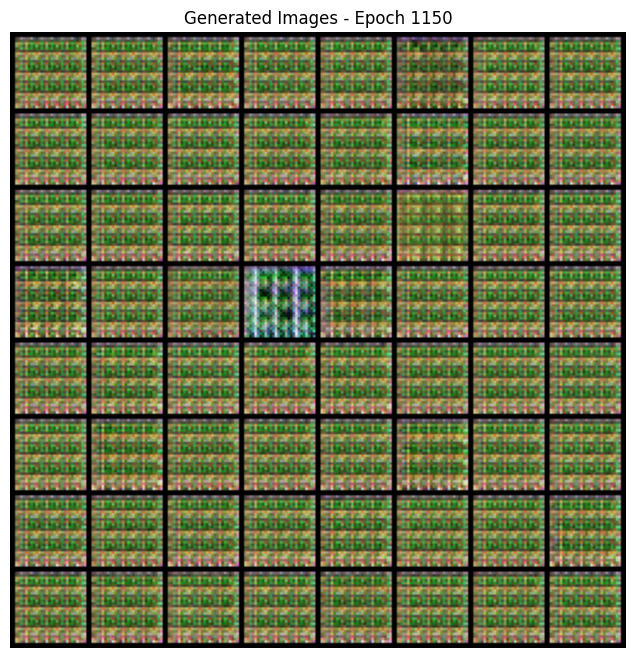

Saved and displayed generated samples at epoch 1150
 Saved checkpoint at epoch 1150


Epoch 1151/1200: 100%|██████████| 6/6 [00:11<00:00,  1.89s/it, d_loss=0.058, g_loss=3.751]


[Epoch 1151] D_loss=0.0531 | G_loss=3.9213


Epoch 1152/1200: 100%|██████████| 6/6 [00:11<00:00,  1.94s/it, d_loss=0.051, g_loss=3.792]


[Epoch 1152] D_loss=0.0512 | G_loss=3.7734


Epoch 1153/1200: 100%|██████████| 6/6 [00:11<00:00,  1.95s/it, d_loss=0.044, g_loss=3.750]


[Epoch 1153] D_loss=0.0492 | G_loss=3.7390


Epoch 1154/1200: 100%|██████████| 6/6 [00:11<00:00,  1.96s/it, d_loss=0.050, g_loss=3.645]


[Epoch 1154] D_loss=0.0472 | G_loss=3.6756


Epoch 1155/1200: 100%|██████████| 6/6 [00:11<00:00,  1.94s/it, d_loss=0.051, g_loss=3.701]


[Epoch 1155] D_loss=0.0636 | G_loss=3.7058


Epoch 1156/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.054, g_loss=3.462]


[Epoch 1156] D_loss=0.0578 | G_loss=3.5779


Epoch 1157/1200: 100%|██████████| 6/6 [00:11<00:00,  1.92s/it, d_loss=0.056, g_loss=3.369]


[Epoch 1157] D_loss=0.0552 | G_loss=3.4136


Epoch 1158/1200:  67%|██████▋   | 4/6 [00:10<00:05,  2.69s/it, d_loss=0.066, g_loss=3.268]


KeyboardInterrupt: 

In [ ]:
if __name__ == "__main__":
  train_dcgan_for_plot()

As you can see in the above cell, I stopped the epoch at 1150 because of the image that it is producing. The discriminator became too weak that its gradients no longer guided the generator. So, I reduced the learning rate in the below loop. And resumed the training again. from 1100th epoch.

In [ ]:

# Final DCGAN Training Loop (Resume and Fine-Tune up to 1200)

def train_dcgan_for_plot():

    # Initialize models and optimizer
    G = Generator(C.z_dim, C.image_channels).to(device)
    D = Discriminator(C.image_channels).to(device)
    G.apply(weights_init)
    D.apply(weights_init)

    criterion = nn.BCEWithLogitsLoss()
    optG = optim.Adam(G.parameters(), lr=C.lr, betas=(C.beta1, C.beta2))
    optD = optim.Adam(D.parameters(), lr=C.lr, betas=(C.beta1, C.beta2))
    scaler = amp.GradScaler('cuda', enabled=C.amp)


    # Resume from latest good checkpoint epoch 1100

    start_epoch = 0
    ckpt_path = os.path.join(C.ckpt_dir, "dcgan_epoch_1100.pt")

    if os.path.exists(ckpt_path):
        print(f"Resuming training from checkpoint: {ckpt_path}")
        checkpoint = torch.load(ckpt_path, map_location=device)
        G.load_state_dict(checkpoint["G_state_dict"])
        D.load_state_dict(checkpoint["D_state_dict"])
        optG.load_state_dict(checkpoint["optG"])
        optD.load_state_dict(checkpoint["optD"])
        d_losses = checkpoint["d_losses"]
        g_losses = checkpoint["g_losses"]
        start_epoch = checkpoint["epoch"] + 1
        print(f"Successfully loaded from epoch {start_epoch}")
        # lower learning rate for fine-tuning phase
        for g in optG.param_groups: g["lr"] = 1e-5
        for g in optD.param_groups: g["lr"] = 1e-5
    else:
        print(" No checkpoint found — starting from scratch")
        d_losses, g_losses = [], []
        start_epoch = 0

    print(f" Continuing training from epoch {start_epoch} → {C.num_epochs}")


    # Main Training Loop

    for epoch in range(start_epoch, C.num_epochs):
        G.train(); D.train()
        d_loss_total, g_loss_total = 0.0, 0.0

        pbar = tqdm(train_loader, desc=f"Epoch {epoch+1}/{C.num_epochs}")

        for real, _ in pbar:
            real = real.to(device, non_blocking=True)
            cur_bs = real.size(0)


            # Train Discriminator

            D.zero_grad(set_to_none=True)
            labels_real = torch.ones(cur_bs, 1, device=device)
            labels_fake = torch.zeros(cur_bs, 1, device=device)

            with amp.autocast('cuda', enabled=C.amp):
                out_real = D(real)
                d_loss_real = criterion(out_real, labels_real)

                # add mild latent jitter
                z = torch.randn(cur_bs, C.z_dim, 1, 1, device=device) * 1.05
                fake = G(z)
                out_fake = D(fake.detach())
                d_loss_fake = criterion(out_fake, labels_fake)
                d_loss = d_loss_real + d_loss_fake

            scaler.scale(d_loss).backward()
            scaler.step(optD)


            # Train Generator

            G.zero_grad(set_to_none=True)
            with amp.autocast('cuda', enabled=C.amp):
                out_gen = D(fake)
                g_loss = criterion(out_gen, labels_real)

            scaler.scale(g_loss).backward()
            scaler.step(optG)
            scaler.update()

            d_loss_total += d_loss.item()
            g_loss_total += g_loss.item()
            pbar.set_postfix(d_loss=f"{d_loss.item():.3f}", g_loss=f"{g_loss.item():.3f}")


        # Epoch Summary

        d_avg = d_loss_total / len(train_loader)
        g_avg = g_loss_total / len(train_loader)
        d_losses.append(d_avg)
        g_losses.append(g_avg)
        print(f"[Epoch {epoch+1}] D_loss={d_avg:.4f} | G_loss={g_avg:.4f}")


        # Save and Display Images every 100 epochs

        if (epoch + 1) % C.image_save_every == 0:
            z = torch.randn(64, C.z_dim, 1, 1, device=device) * 1.05
            with torch.no_grad(), amp.autocast('cuda', enabled=C.amp):
                fake = G(z)
            grid = vutils.make_grid((fake.clamp(-1, 1) + 1) / 2, nrow=8)
            img = np.transpose(grid.cpu().to(torch.float32).numpy(), (1, 2, 0))
            plt.figure(figsize=(8, 8))
            plt.axis("off")
            plt.title(f"Generated Images - Epoch {epoch+1}")
            plt.imshow(img)
            plt.show()
            plt.imsave(f"{C.outdir}/epoch_{epoch+1:04d}_samples.png", img)
            print(f"Saved generated samples at epoch {epoch+1}")


        # Save Checkpoints every 100 epochs

        if (epoch + 1) % C.save_every == 0:
            torch.save({
                "epoch": epoch,
                "G_state_dict": G.state_dict(),
                "D_state_dict": D.state_dict(),
                "optG": optG.state_dict(),
                "optD": optD.state_dict(),
                "d_losses": d_losses,
                "g_losses": g_losses
            }, os.path.join(C.ckpt_dir, f"dcgan_epoch_{epoch+1:04d}.pt"))
            print(f" Saved checkpoint at epoch {epoch+1}")


    # Training Complete

    print("Training completed successfully!")
    torch.save(G.state_dict(), os.path.join(C.ckpt_dir, "final_generator_dcgan.pth"))
    np.save(os.path.join(C.ckpt_dir, "d_losses.npy"), np.array(d_losses))
    np.save(os.path.join(C.ckpt_dir, "g_losses.npy"), np.array(g_losses))


Resuming training from checkpoint: checkpoints_dcgan/dcgan_epoch_1100.pt
Successfully loaded from epoch 1100
 Continuing training from epoch 1100 → 1200


Epoch 1101/1200: 100%|██████████| 6/6 [00:21<00:00,  3.61s/it, d_loss=0.125, g_loss=4.167]


[Epoch 1101] D_loss=0.1456 | G_loss=4.3343


Epoch 1102/1200: 100%|██████████| 6/6 [00:21<00:00,  3.56s/it, d_loss=0.064, g_loss=3.737]


[Epoch 1102] D_loss=0.1042 | G_loss=3.7706


Epoch 1103/1200: 100%|██████████| 6/6 [00:21<00:00,  3.63s/it, d_loss=0.229, g_loss=3.712]


[Epoch 1103] D_loss=0.1013 | G_loss=3.9311


Epoch 1104/1200: 100%|██████████| 6/6 [00:21<00:00,  3.58s/it, d_loss=0.189, g_loss=5.613]


[Epoch 1104] D_loss=0.1462 | G_loss=3.5022


Epoch 1105/1200: 100%|██████████| 6/6 [00:21<00:00,  3.60s/it, d_loss=0.211, g_loss=4.063]


[Epoch 1105] D_loss=0.1215 | G_loss=3.6476


Epoch 1106/1200: 100%|██████████| 6/6 [00:21<00:00,  3.55s/it, d_loss=0.077, g_loss=3.614]


[Epoch 1106] D_loss=0.1085 | G_loss=3.4250


Epoch 1107/1200: 100%|██████████| 6/6 [00:21<00:00,  3.56s/it, d_loss=0.033, g_loss=4.532]


[Epoch 1107] D_loss=0.0985 | G_loss=3.8416


Epoch 1108/1200: 100%|██████████| 6/6 [00:21<00:00,  3.55s/it, d_loss=0.119, g_loss=3.166]


[Epoch 1108] D_loss=0.1160 | G_loss=3.5437


Epoch 1109/1200: 100%|██████████| 6/6 [00:21<00:00,  3.62s/it, d_loss=0.112, g_loss=4.301]


[Epoch 1109] D_loss=0.1262 | G_loss=3.4233


Epoch 1110/1200: 100%|██████████| 6/6 [00:21<00:00,  3.60s/it, d_loss=0.082, g_loss=3.948]


[Epoch 1110] D_loss=0.1052 | G_loss=3.6528


Epoch 1111/1200: 100%|██████████| 6/6 [00:21<00:00,  3.55s/it, d_loss=0.268, g_loss=2.309]


[Epoch 1111] D_loss=0.1355 | G_loss=3.1656


Epoch 1112/1200: 100%|██████████| 6/6 [00:21<00:00,  3.57s/it, d_loss=0.136, g_loss=3.020]


[Epoch 1112] D_loss=0.1362 | G_loss=3.4559


Epoch 1113/1200: 100%|██████████| 6/6 [00:21<00:00,  3.58s/it, d_loss=0.210, g_loss=2.922]


[Epoch 1113] D_loss=0.1426 | G_loss=3.4112


Epoch 1114/1200: 100%|██████████| 6/6 [00:21<00:00,  3.58s/it, d_loss=0.226, g_loss=2.507]


[Epoch 1114] D_loss=0.1177 | G_loss=3.5006


Epoch 1115/1200: 100%|██████████| 6/6 [00:21<00:00,  3.56s/it, d_loss=0.095, g_loss=3.321]


[Epoch 1115] D_loss=0.1689 | G_loss=3.3944


Epoch 1116/1200: 100%|██████████| 6/6 [00:21<00:00,  3.58s/it, d_loss=0.115, g_loss=3.650]


[Epoch 1116] D_loss=0.1473 | G_loss=3.5149


Epoch 1117/1200: 100%|██████████| 6/6 [00:21<00:00,  3.55s/it, d_loss=0.523, g_loss=3.630]


[Epoch 1117] D_loss=0.1618 | G_loss=3.8240


Epoch 1118/1200: 100%|██████████| 6/6 [00:21<00:00,  3.57s/it, d_loss=0.169, g_loss=3.692]


[Epoch 1118] D_loss=0.1419 | G_loss=3.1351


Epoch 1119/1200: 100%|██████████| 6/6 [00:21<00:00,  3.55s/it, d_loss=0.230, g_loss=3.227]


[Epoch 1119] D_loss=0.1336 | G_loss=3.3992


Epoch 1120/1200: 100%|██████████| 6/6 [00:21<00:00,  3.61s/it, d_loss=0.185, g_loss=4.384]


[Epoch 1120] D_loss=0.1012 | G_loss=4.0171


Epoch 1121/1200: 100%|██████████| 6/6 [00:21<00:00,  3.56s/it, d_loss=0.137, g_loss=2.899]


[Epoch 1121] D_loss=0.0979 | G_loss=3.5986


Epoch 1122/1200: 100%|██████████| 6/6 [00:21<00:00,  3.54s/it, d_loss=0.186, g_loss=4.389]


[Epoch 1122] D_loss=0.1087 | G_loss=3.8579


Epoch 1123/1200: 100%|██████████| 6/6 [00:21<00:00,  3.60s/it, d_loss=0.250, g_loss=3.642]


[Epoch 1123] D_loss=0.1494 | G_loss=3.5565


Epoch 1124/1200: 100%|██████████| 6/6 [00:21<00:00,  3.56s/it, d_loss=0.095, g_loss=3.764]


[Epoch 1124] D_loss=0.1036 | G_loss=3.5674


Epoch 1125/1200: 100%|██████████| 6/6 [00:21<00:00,  3.58s/it, d_loss=0.194, g_loss=2.576]


[Epoch 1125] D_loss=0.1387 | G_loss=3.0510


Epoch 1126/1200: 100%|██████████| 6/6 [00:21<00:00,  3.63s/it, d_loss=0.152, g_loss=3.582]


[Epoch 1126] D_loss=0.1825 | G_loss=3.5765


Epoch 1127/1200: 100%|██████████| 6/6 [00:21<00:00,  3.63s/it, d_loss=0.156, g_loss=2.618]


[Epoch 1127] D_loss=0.1242 | G_loss=3.5916


Epoch 1128/1200: 100%|██████████| 6/6 [00:22<00:00,  3.71s/it, d_loss=0.214, g_loss=3.750]


[Epoch 1128] D_loss=0.1071 | G_loss=3.6432


Epoch 1129/1200: 100%|██████████| 6/6 [00:22<00:00,  3.70s/it, d_loss=0.060, g_loss=3.645]


[Epoch 1129] D_loss=0.0979 | G_loss=3.3981


Epoch 1130/1200: 100%|██████████| 6/6 [00:21<00:00,  3.66s/it, d_loss=0.153, g_loss=3.530]


[Epoch 1130] D_loss=0.1181 | G_loss=3.5167


Epoch 1131/1200: 100%|██████████| 6/6 [00:21<00:00,  3.66s/it, d_loss=0.202, g_loss=2.436]


[Epoch 1131] D_loss=0.1180 | G_loss=3.4182


Epoch 1132/1200: 100%|██████████| 6/6 [00:21<00:00,  3.61s/it, d_loss=0.144, g_loss=3.087]


[Epoch 1132] D_loss=0.1083 | G_loss=3.6250


Epoch 1133/1200: 100%|██████████| 6/6 [00:21<00:00,  3.65s/it, d_loss=0.112, g_loss=4.957]


[Epoch 1133] D_loss=0.0945 | G_loss=4.0625


Epoch 1134/1200: 100%|██████████| 6/6 [00:22<00:00,  3.67s/it, d_loss=0.530, g_loss=3.977]


[Epoch 1134] D_loss=0.2116 | G_loss=3.4810


Epoch 1135/1200: 100%|██████████| 6/6 [00:22<00:00,  3.77s/it, d_loss=0.387, g_loss=3.066]


[Epoch 1135] D_loss=0.1528 | G_loss=3.3257


Epoch 1136/1200: 100%|██████████| 6/6 [00:21<00:00,  3.64s/it, d_loss=0.075, g_loss=3.418]


[Epoch 1136] D_loss=0.1077 | G_loss=3.3300


Epoch 1137/1200: 100%|██████████| 6/6 [00:21<00:00,  3.64s/it, d_loss=0.057, g_loss=3.996]


[Epoch 1137] D_loss=0.1189 | G_loss=3.4112


Epoch 1138/1200: 100%|██████████| 6/6 [00:21<00:00,  3.64s/it, d_loss=0.113, g_loss=3.569]


[Epoch 1138] D_loss=0.1031 | G_loss=3.4666


Epoch 1139/1200: 100%|██████████| 6/6 [00:22<00:00,  3.77s/it, d_loss=0.302, g_loss=2.880]


[Epoch 1139] D_loss=0.1258 | G_loss=3.5657


Epoch 1140/1200: 100%|██████████| 6/6 [00:22<00:00,  3.68s/it, d_loss=0.117, g_loss=3.008]


[Epoch 1140] D_loss=0.1163 | G_loss=3.2752


Epoch 1141/1200: 100%|██████████| 6/6 [00:21<00:00,  3.66s/it, d_loss=0.102, g_loss=3.600]


[Epoch 1141] D_loss=0.1383 | G_loss=3.3914


Epoch 1142/1200: 100%|██████████| 6/6 [00:22<00:00,  3.70s/it, d_loss=0.051, g_loss=4.848]


[Epoch 1142] D_loss=0.1065 | G_loss=3.8785


Epoch 1143/1200: 100%|██████████| 6/6 [00:22<00:00,  3.67s/it, d_loss=0.071, g_loss=3.463]


[Epoch 1143] D_loss=0.0938 | G_loss=3.7531


Epoch 1144/1200: 100%|██████████| 6/6 [00:22<00:00,  3.70s/it, d_loss=0.153, g_loss=3.059]


[Epoch 1144] D_loss=0.1491 | G_loss=3.7585


Epoch 1145/1200: 100%|██████████| 6/6 [00:21<00:00,  3.63s/it, d_loss=0.203, g_loss=2.471]


[Epoch 1145] D_loss=0.1328 | G_loss=3.1305


Epoch 1146/1200: 100%|██████████| 6/6 [00:21<00:00,  3.63s/it, d_loss=0.240, g_loss=3.333]


[Epoch 1146] D_loss=0.1389 | G_loss=3.2219


Epoch 1147/1200: 100%|██████████| 6/6 [00:22<00:00,  3.69s/it, d_loss=0.184, g_loss=2.700]


[Epoch 1147] D_loss=0.0938 | G_loss=3.6657


Epoch 1148/1200: 100%|██████████| 6/6 [00:21<00:00,  3.64s/it, d_loss=0.078, g_loss=3.646]


[Epoch 1148] D_loss=0.1091 | G_loss=3.5757


Epoch 1149/1200: 100%|██████████| 6/6 [00:21<00:00,  3.64s/it, d_loss=0.099, g_loss=3.888]


[Epoch 1149] D_loss=0.0872 | G_loss=3.8093


Epoch 1150/1200: 100%|██████████| 6/6 [00:21<00:00,  3.65s/it, d_loss=0.191, g_loss=2.857]


[Epoch 1150] D_loss=0.0964 | G_loss=3.8091


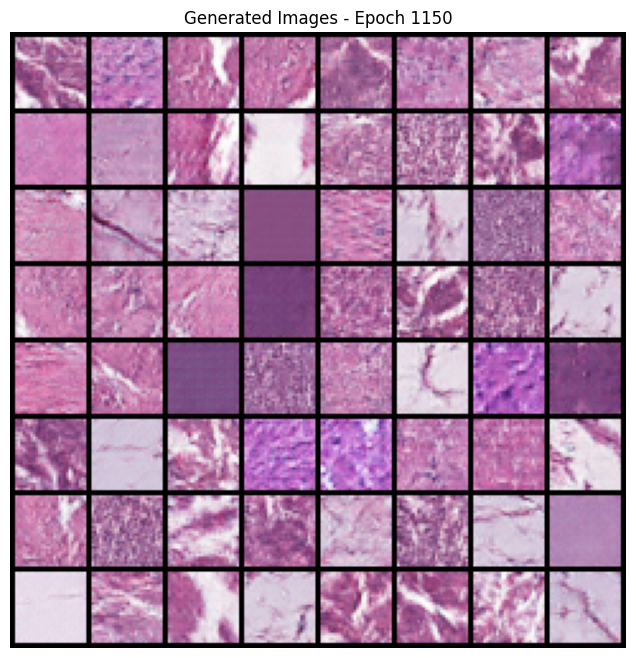

Saved generated samples at epoch 1150
 Saved checkpoint at epoch 1150


Epoch 1151/1200: 100%|██████████| 6/6 [00:22<00:00,  3.67s/it, d_loss=0.182, g_loss=3.723]


[Epoch 1151] D_loss=0.1092 | G_loss=3.6021


Epoch 1152/1200: 100%|██████████| 6/6 [00:22<00:00,  3.69s/it, d_loss=0.090, g_loss=3.469]


[Epoch 1152] D_loss=0.1066 | G_loss=3.3534


Epoch 1153/1200: 100%|██████████| 6/6 [00:22<00:00,  3.68s/it, d_loss=0.085, g_loss=4.314]


[Epoch 1153] D_loss=0.0903 | G_loss=3.8394


Epoch 1154/1200: 100%|██████████| 6/6 [00:21<00:00,  3.62s/it, d_loss=0.174, g_loss=3.619]


[Epoch 1154] D_loss=0.1203 | G_loss=3.6083


Epoch 1155/1200: 100%|██████████| 6/6 [00:21<00:00,  3.58s/it, d_loss=0.114, g_loss=3.018]


[Epoch 1155] D_loss=0.1038 | G_loss=3.5099


Epoch 1156/1200: 100%|██████████| 6/6 [00:21<00:00,  3.56s/it, d_loss=0.047, g_loss=4.137]


[Epoch 1156] D_loss=0.1157 | G_loss=3.6088


Epoch 1157/1200: 100%|██████████| 6/6 [00:21<00:00,  3.57s/it, d_loss=0.075, g_loss=3.604]


[Epoch 1157] D_loss=0.0953 | G_loss=3.6901


Epoch 1158/1200: 100%|██████████| 6/6 [00:21<00:00,  3.60s/it, d_loss=0.086, g_loss=4.005]


[Epoch 1158] D_loss=0.1076 | G_loss=3.6257


Epoch 1159/1200: 100%|██████████| 6/6 [00:21<00:00,  3.55s/it, d_loss=0.117, g_loss=3.277]


[Epoch 1159] D_loss=0.1031 | G_loss=3.5690


Epoch 1160/1200: 100%|██████████| 6/6 [00:21<00:00,  3.64s/it, d_loss=0.223, g_loss=2.480]


[Epoch 1160] D_loss=0.1640 | G_loss=3.2476


Epoch 1161/1200: 100%|██████████| 6/6 [00:21<00:00,  3.61s/it, d_loss=0.402, g_loss=1.880]


[Epoch 1161] D_loss=0.1482 | G_loss=3.4159


Epoch 1162/1200: 100%|██████████| 6/6 [00:21<00:00,  3.58s/it, d_loss=0.083, g_loss=4.150]


[Epoch 1162] D_loss=0.0978 | G_loss=3.9053


Epoch 1163/1200: 100%|██████████| 6/6 [00:22<00:00,  3.69s/it, d_loss=0.137, g_loss=3.217]


[Epoch 1163] D_loss=0.0912 | G_loss=3.7710


Epoch 1164/1200: 100%|██████████| 6/6 [00:22<00:00,  3.72s/it, d_loss=0.086, g_loss=3.402]


[Epoch 1164] D_loss=0.0858 | G_loss=3.7768


Epoch 1165/1200: 100%|██████████| 6/6 [00:21<00:00,  3.67s/it, d_loss=0.051, g_loss=3.792]


[Epoch 1165] D_loss=0.0866 | G_loss=3.9147


Epoch 1166/1200: 100%|██████████| 6/6 [00:22<00:00,  3.72s/it, d_loss=0.137, g_loss=2.730]


[Epoch 1166] D_loss=0.1205 | G_loss=3.4869


Epoch 1167/1200: 100%|██████████| 6/6 [00:21<00:00,  3.61s/it, d_loss=0.224, g_loss=2.477]


[Epoch 1167] D_loss=0.1195 | G_loss=3.5301


Epoch 1168/1200: 100%|██████████| 6/6 [00:21<00:00,  3.65s/it, d_loss=0.161, g_loss=4.961]


[Epoch 1168] D_loss=0.1224 | G_loss=3.9262


Epoch 1169/1200: 100%|██████████| 6/6 [00:21<00:00,  3.60s/it, d_loss=0.155, g_loss=4.282]


[Epoch 1169] D_loss=0.1134 | G_loss=3.7047


Epoch 1170/1200: 100%|██████████| 6/6 [00:21<00:00,  3.59s/it, d_loss=0.143, g_loss=3.016]


[Epoch 1170] D_loss=0.1277 | G_loss=3.2852


Epoch 1171/1200: 100%|██████████| 6/6 [00:21<00:00,  3.66s/it, d_loss=0.120, g_loss=4.156]


[Epoch 1171] D_loss=0.0970 | G_loss=3.7919


Epoch 1172/1200: 100%|██████████| 6/6 [00:22<00:00,  3.68s/it, d_loss=0.075, g_loss=3.388]


[Epoch 1172] D_loss=0.1084 | G_loss=3.7693


Epoch 1173/1200: 100%|██████████| 6/6 [00:21<00:00,  3.61s/it, d_loss=0.046, g_loss=4.395]


[Epoch 1173] D_loss=0.0882 | G_loss=3.5365


Epoch 1174/1200: 100%|██████████| 6/6 [00:21<00:00,  3.62s/it, d_loss=0.153, g_loss=4.091]


[Epoch 1174] D_loss=0.0947 | G_loss=3.7227


Epoch 1175/1200: 100%|██████████| 6/6 [00:21<00:00,  3.61s/it, d_loss=0.098, g_loss=4.430]


[Epoch 1175] D_loss=0.0854 | G_loss=3.8266


Epoch 1176/1200: 100%|██████████| 6/6 [00:21<00:00,  3.55s/it, d_loss=0.195, g_loss=3.721]


[Epoch 1176] D_loss=0.1052 | G_loss=3.8091


Epoch 1177/1200: 100%|██████████| 6/6 [00:21<00:00,  3.61s/it, d_loss=0.146, g_loss=4.501]


[Epoch 1177] D_loss=0.0950 | G_loss=3.7687


Epoch 1178/1200: 100%|██████████| 6/6 [00:21<00:00,  3.61s/it, d_loss=0.053, g_loss=4.332]


[Epoch 1178] D_loss=0.1040 | G_loss=3.4737


Epoch 1179/1200: 100%|██████████| 6/6 [00:21<00:00,  3.52s/it, d_loss=0.063, g_loss=3.801]


[Epoch 1179] D_loss=0.0799 | G_loss=3.6481


Epoch 1180/1200: 100%|██████████| 6/6 [00:21<00:00,  3.56s/it, d_loss=0.129, g_loss=3.775]


[Epoch 1180] D_loss=0.0901 | G_loss=3.6725


Epoch 1181/1200: 100%|██████████| 6/6 [00:21<00:00,  3.54s/it, d_loss=0.508, g_loss=3.406]


[Epoch 1181] D_loss=0.1559 | G_loss=3.5942


Epoch 1182/1200: 100%|██████████| 6/6 [00:21<00:00,  3.55s/it, d_loss=0.082, g_loss=3.371]


[Epoch 1182] D_loss=0.1253 | G_loss=3.2418


Epoch 1183/1200: 100%|██████████| 6/6 [00:21<00:00,  3.58s/it, d_loss=0.063, g_loss=4.351]


[Epoch 1183] D_loss=0.0921 | G_loss=3.6383


Epoch 1184/1200: 100%|██████████| 6/6 [00:21<00:00,  3.55s/it, d_loss=0.106, g_loss=3.734]


[Epoch 1184] D_loss=0.0903 | G_loss=3.8269


Epoch 1185/1200: 100%|██████████| 6/6 [00:21<00:00,  3.59s/it, d_loss=0.092, g_loss=3.465]


[Epoch 1185] D_loss=0.1079 | G_loss=3.4306


Epoch 1186/1200: 100%|██████████| 6/6 [00:21<00:00,  3.56s/it, d_loss=0.109, g_loss=4.200]


[Epoch 1186] D_loss=0.1138 | G_loss=3.8024


Epoch 1187/1200: 100%|██████████| 6/6 [00:21<00:00,  3.56s/it, d_loss=0.359, g_loss=3.431]


[Epoch 1187] D_loss=0.1193 | G_loss=3.7418


Epoch 1188/1200: 100%|██████████| 6/6 [00:21<00:00,  3.56s/it, d_loss=0.091, g_loss=3.227]


[Epoch 1188] D_loss=0.0788 | G_loss=3.7610


Epoch 1189/1200: 100%|██████████| 6/6 [00:21<00:00,  3.57s/it, d_loss=0.133, g_loss=3.326]


[Epoch 1189] D_loss=0.1229 | G_loss=3.3726


Epoch 1190/1200: 100%|██████████| 6/6 [00:21<00:00,  3.59s/it, d_loss=0.105, g_loss=3.195]


[Epoch 1190] D_loss=0.1258 | G_loss=3.0876


Epoch 1191/1200: 100%|██████████| 6/6 [00:21<00:00,  3.58s/it, d_loss=0.094, g_loss=3.949]


[Epoch 1191] D_loss=0.0818 | G_loss=3.7690


Epoch 1192/1200: 100%|██████████| 6/6 [00:21<00:00,  3.57s/it, d_loss=0.213, g_loss=3.012]


[Epoch 1192] D_loss=0.1262 | G_loss=3.4857


Epoch 1193/1200: 100%|██████████| 6/6 [00:21<00:00,  3.55s/it, d_loss=0.453, g_loss=4.529]


[Epoch 1193] D_loss=0.1434 | G_loss=3.9976


Epoch 1194/1200: 100%|██████████| 6/6 [00:21<00:00,  3.55s/it, d_loss=0.096, g_loss=3.591]


[Epoch 1194] D_loss=0.0966 | G_loss=3.3398


Epoch 1195/1200: 100%|██████████| 6/6 [00:21<00:00,  3.60s/it, d_loss=0.062, g_loss=3.710]


[Epoch 1195] D_loss=0.0965 | G_loss=3.6703


Epoch 1196/1200: 100%|██████████| 6/6 [00:21<00:00,  3.66s/it, d_loss=0.150, g_loss=3.983]


[Epoch 1196] D_loss=0.0955 | G_loss=3.8126


Epoch 1197/1200: 100%|██████████| 6/6 [00:22<00:00,  3.73s/it, d_loss=0.060, g_loss=4.188]


[Epoch 1197] D_loss=0.0772 | G_loss=3.8664


Epoch 1198/1200: 100%|██████████| 6/6 [00:21<00:00,  3.56s/it, d_loss=0.204, g_loss=3.051]


[Epoch 1198] D_loss=0.0910 | G_loss=3.7282


Epoch 1199/1200: 100%|██████████| 6/6 [00:21<00:00,  3.54s/it, d_loss=0.064, g_loss=3.773]


[Epoch 1199] D_loss=0.0891 | G_loss=3.8094


Epoch 1200/1200: 100%|██████████| 6/6 [00:21<00:00,  3.57s/it, d_loss=0.135, g_loss=3.638]


[Epoch 1200] D_loss=0.0828 | G_loss=3.7694


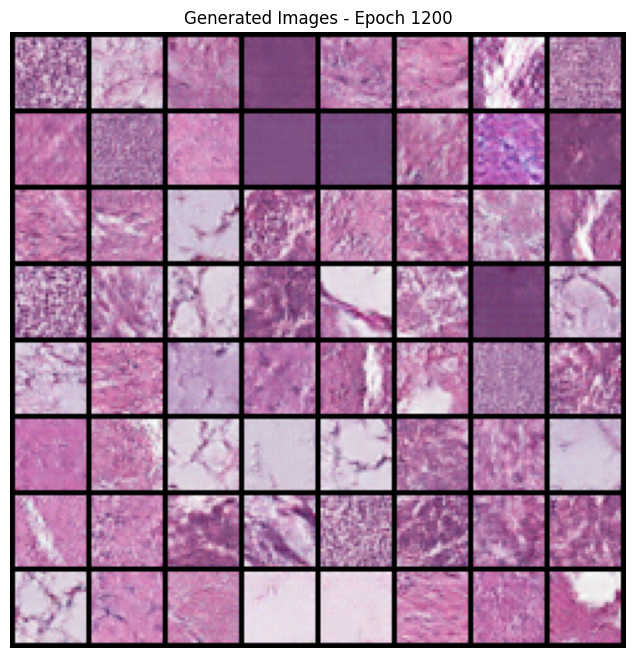

Saved generated samples at epoch 1200
 Saved checkpoint at epoch 1200
Training completed successfully!


In [ ]:
if __name__ == "__main__":
  train_dcgan_for_plot()

###B. Evaluation and Analysis
### 1. Plot generator and discriminator loss curves and analyze training stability. Discuss any indications of mode collapse or vanishing gradients using these curves.



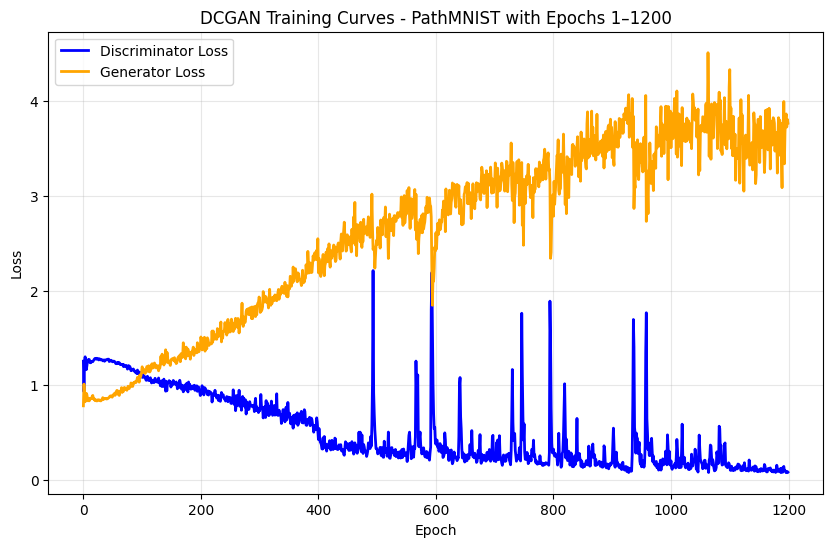

Final Discriminator Loss: 0.0828
Final Generator Loss: 3.7694


In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Load saved losses
d_losses = np.load("checkpoints_dcgan/d_losses.npy")
g_losses = np.load("checkpoints_dcgan/g_losses.npy")


# Plot curves
plt.figure(figsize=(10, 6))
plt.plot(d_losses, label="Discriminator Loss", color='blue', linewidth=2)
plt.plot(g_losses, label="Generator Loss", color='orange', linewidth=2)
plt.title("DCGAN Training Curves - PathMNIST with Epochs 1–1200")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()


# Print last few loss values for reference
print(f"Final Discriminator Loss: {d_losses[-1]:.4f}")
print(f"Final Generator Loss: {g_losses[-1]:.4f}")

In [ ]:
import torch
import torch.nn.functional as F
from torchvision.models import inception_v3, Inception_V3_Weights
from torchvision import transforms, utils
from medmnist import PathMNIST
import numpy as np
from scipy import linalg
import matplotlib.pyplot as plt

# ============================================================
# Load generator and dataset
# ============================================================
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
z_dim = 100
batch_size = 32
num_samples = 1000

# Load trained generator
G = Generator(z_dim=z_dim, channels=3).to(device)
G.load_state_dict(torch.load("checkpoints_dcgan/final_generator_dcgan.pth", map_location=device))
G.eval()

# Real PathMNIST images (normalized to [-1,1])
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,)*3, (0.5,)*3)
])
real_dataset = PathMNIST(split="train", transform=transform, download=True)
real_loader = torch.utils.data.DataLoader(real_dataset, batch_size=batch_size, shuffle=True)

In [ ]:
# ============================================================
# Helper functions
# ============================================================
from torchvision.models import inception_v3
import torch.nn as nn

def get_inception_model(device):
    inception = inception_v3(weights="IMAGENET1K_V1", aux_logits=True)
    inception.fc = nn.Identity()  # remove final classifier
    inception.eval().to(device)
    return inception

def get_activations(images, model, device, batch_size=32):
    acts = []
    for i in range(0, len(images), batch_size):
        batch = images[i:i+batch_size].to(device)
        batch = F.interpolate(batch, size=(299, 299), mode="bilinear", align_corners=False)
        with torch.no_grad():
            pred = model(batch)
        acts.append(pred.cpu().numpy())
    return np.concatenate(acts, axis=0)

def compute_fid(mu1, sigma1, mu2, sigma2):
    diff = mu1 - mu2
    covmean, _ = linalg.sqrtm(sigma1.dot(sigma2), disp=False)
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    fid = diff.dot(diff) + np.trace(sigma1 + sigma2 - 2 * covmean)
    return float(fid)

def inception_score(preds, splits=10):
    preds = np.exp(preds) / np.sum(np.exp(preds), axis=1, keepdims=True)
    scores = []
    N = preds.shape[0]
    split_size = N // splits
    for i in range(splits):
        part = preds[i * split_size:(i + 1) * split_size, :]
        py = np.mean(part, axis=0, keepdims=True)
        kl = part * (np.log(part + 1e-10) - np.log(py + 1e-10))
        kl = np.mean(np.sum(kl, axis=1))
        scores.append(np.exp(kl))
    return float(np.mean(scores)), float(np.std(scores))


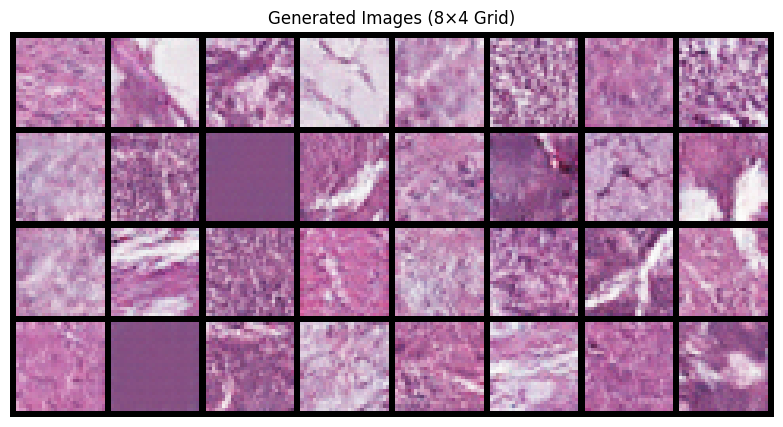

In [ ]:
# ============================================================
# Generate 1000 fake images
# ============================================================
fake_images = []
with torch.no_grad():
    for _ in range(num_samples // batch_size):
        z = torch.randn(batch_size, z_dim, 1, 1, device=device)
        fake = G(z)
        fake_images.append(fake.cpu())
fake_images = torch.cat(fake_images, dim=0)[:num_samples]

# ============================================================
# Collect 1000 real images
# ============================================================
real_images = []
for img, _ in real_loader:
    real_images.append(img)
    if len(real_images) * batch_size >= num_samples:
        break
real_images = torch.cat(real_images, dim=0)[:num_samples]

# ============================================================
# Display 32 generated images (8×4 grid)
# ============================================================
samples = (fake_images[:32] + 1) / 2  # de-normalize to [0,1]
grid = utils.make_grid(samples, nrow=8)
plt.figure(figsize=(10, 5))
plt.imshow(np.transpose(grid.numpy(), (1, 2, 0)))
plt.axis("off")
plt.title("Generated Images (8×4 Grid)")
plt.show()


In [ ]:
# ============================================================
# Compute FID & IS
# ============================================================
from torchvision.models import inception_v3, Inception_V3_Weights
import torch.nn as nn

inception = get_inception_model(device)

# Get activations
real_acts = get_activations(real_images, inception, device)
fake_acts = get_activations(fake_images, inception, device)

# Compute FID
mu_real, sigma_real = np.mean(real_acts, axis=0), np.cov(real_acts, rowvar=False)
mu_fake, sigma_fake = np.mean(fake_acts, axis=0), np.cov(fake_acts, rowvar=False)
fid = compute_fid(mu_real, sigma_real, mu_fake, sigma_fake)

# For IS, re-enable the final softmax layer
weights = Inception_V3_Weights.IMAGENET1K_V1
inception_for_is = inception_v3(weights=weights, aux_logits=True).to(device).eval()
preds = []
with torch.no_grad():
    for i in range(0, len(fake_images), batch_size):
        batch = fake_images[i:i+batch_size].to(device)
        batch = F.interpolate(batch, size=(299, 299), mode="bilinear", align_corners=False)
        pred = inception_for_is(batch)
        preds.append(pred.cpu().numpy())
preds = np.concatenate(preds, axis=0)
is_mean, is_std = inception_score(preds)

print(f"\nFID: {fid:.2f}")
print(f"Inception Score: {is_mean:.2f} ± {is_std:.2f}")


/tmp/ipython-input-1319155097.py:25: DeprecationWarning: The `disp` argument is deprecated and will be removed in SciPy 1.18.0.
  covmean, _ = linalg.sqrtm(sigma1.dot(sigma2), disp=False)



FID: 42.02
Inception Score: 1.50 ± 0.07


The produced images in the PathMNIST dataset display a fair understanding of the color spectrum captured in hematoxylin-eosin staining images. The images display pink to purple shades like those found in the real dataset. Although there’s accuracy in color reproduction, there’s minimal structure resemblance. The produced images display a blurry nature. They lack histological details like nuclei or gland structures found in real images. The generator has yet to learn these details.

In terms of diversity, there is a fair amount of variation in terms of tone or local texture on the grid. There are patches that are similar in terms of coarse features. The existence of similar textures and patterns in terms of color points to a case of mode collapse. In fact, there are areas that are flat or rather smooth. There are areas where the generator does not produce real microstructure.

In general,  DCGAN model is learning globally the color texture distribution in the dataset PathMNIST, there seems to be a lack in anatomically correct details. The dominating behavior of discriminator seems to contribute for the losses.  Other methods to improve anatomically correct details in generated images include using DiffAug, increasing dimensions to the latent space, or using WGAN-GP or StyleGAN2 models.

Inception Score (IS), mainly stands at 1.50 ± 0.07, and Fréchet Inception Distance (FID), which stands at 42.02, states that there has been only partial success in creating a real and diverse set of images using DCGAN.  

The Inception Score mainly evaluates how diverse or recognizable the images are. The Inception Score considers a high value to mean that those images generated are not only diverse but can easily be identified using a pre-trained model. The Inception Score of 1.5 is quite low. This suggests that the images are not diverse enough. Notably, the generated images are not diverse enough to be classified into various tissue types. Clearly, there is a uniformity in these images. These images do not represent a complete set of features possessed by the original dataset.

The FID score, conversely, examines a measure related to how well a generated image distribution matches that of real images. The lower the score, the better. Based on these values, it seems that generator is not yet creating anatomically plausible images. The fact that both the values for the generator are relatively low and there’s a high value for discriminator suggests that these images are probably not very diverse. Also, since there’s a repetitive pattern in both generated grid images, there seems to be a case of mode collapse where the generator seems to concentrate on creating images belonging to only a few modes.

From a graphical point of view, there appears to be little diversity in the generated images of PathMNIST. The patches tend to resemble one another in terms of coloration and texture, although some tend to appear too smooth or lack glands/nuclei. Again, this tends to indicate a model generator that puts out similar images repeatedly instead of varying them.

From a numerical point of view, this interpretation holds quite well. The Inception Score (1.50 ± 0.07) again proves that model predictions are not very diverse and represent a set of images which are not very confidently identified by Inception as something that looks like unique images. Also, an FID score (42.02) proves that there are significant differences between real images’ and generated images’ data distribution — thus generated images are quite different from real data both in texture and structure.

Together, both the quantitative and qualitative results convey a common truth: although DCGAN has managed to learn some basic color and texture patterns from histological images, realistically varying them or accurately reproducing anatomical features has yet to be attained. Both sets of results signal a partial mode collapse phenomenon in both mode and generator functions.